# Inferring a complex nonlinear feature space

In [1]:
# Load General Modules
%matplotlib inline
import matplotlib
import numpy as np
import numpy.matlib
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.stats as sps
from scipy.stats import chi
import scipy as sp
from scipy import signal
from sklearn import linear_model
import pickle
import datetime
import time
import os
%load_ext autoreload
%autoreload 2

# Local modules (scripts need to be in folder)
import sys
my_path = '/gpfs01/bethge/home/dklindt/David/publish'
sys.path.append(my_path)

import CNN
import generate_neurons
import generate_data
import pre_process
import GLMs
import training

# Tensorflow needs to be LAST import
import tensorflow as tf
print(tf.__version__)

/usr/local/lib/python3.4/dist-packages/IPython/html.py:14: ShimWarning: The `IPython.html` package has been deprecated. You should import from `notebook` instead. `IPython.html.widgets` has moved to `ipywidgets`.
  "`IPython.html.widgets` has moved to `ipywidgets`.", ShimWarning)


1.0.0


## Loading data from VGG Conv2 activations

In [2]:
Data=np.load('/gpfs01/bethge/home/dklindt/David/publish/fig5/more_types/data_all.npz')
print(Data.keys())
Y=Data.f.responses
Y=Y.T# N x D
X=Data.f.images# D x 3 x 44 x 44
X=np.transpose(X,axes=[0,3,1,2])# NCHW
loc_y=Data.f.loc_y
loc_x=Data.f.loc_x
feature_maps=Data.f.feature_maps

['loc_x', 'feature_maps', 'loc_y', 'responses', 'images']


## Train - Val - Split

In [5]:
# splits data into train,val,test and adds poisson-like noise
def splitting_data(X,Y,num_train,num_val,num_test=2**10,noise=True,mean_response=.1):
    
    N=Y.shape[0]#number of neurons
    
    X_train=X[:num_train,:,:,:]
    X_val=X[num_train:num_train+num_val,:,:,:]
    X_test=X[num_train+num_val:num_train+num_val+num_test,:,:,:]
    
    Y_train=np.zeros([N,num_train])
    Y_val=np.zeros([N,num_val])
    #Y_test=np.zeros([N,num_test])
    GT_test=np.zeros([N,num_test])
    
    for n in range(N):
        tmp_mean = np.mean(Y[n,:])
        Y_train[n,:] = Y[n,:num_train] / tmp_mean * mean_response
        Y_val[n,:] = Y[n,num_train:num_train+num_val] / tmp_mean * mean_response
        GT_test[n,:] = Y[n,num_train+num_val:num_train+num_val+num_test] / tmp_mean * mean_response
    
    #Poisson-like noise
    if noise:
        Y_train += np.random.normal(0,np.sqrt(np.abs(Y_train)),Y_train.shape)
        Y_val +=  np.random.normal(0,np.sqrt(np.abs(Y_val)),Y_val.shape)
        #Y_test =  GT_test + np.random.normal(0,np.sqrt(np.abs(GT_test)),GT_test.shape)
    
    #Poisson noise
    #if noise:
    #    Y_train += np.random.poisson(Y_train)
    #    Y_val +=  np.random.poisson(Y_val)
    #    Y_test =  GT_test + np.random.poisson(GT_test)
    
    return Y_train,Y_val,X_train,X_val,X_test,GT_test#,Y_test

## Exploration

Images for Training: 55552, Validation: 7936, Testing 1024
it took 133.20378828048706 s to preprocess data
Before Training:
Total FEV =  -0.251816127791
Loss/Regularization: 0.0631483918987 MSE, 0.0 kernel, 0.00181613969803 mask, 0.0131929063797 weights


/usr/local/lib/python3.4/dist-packages/matplotlib/font_manager.py:1313: UserWarning: findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))


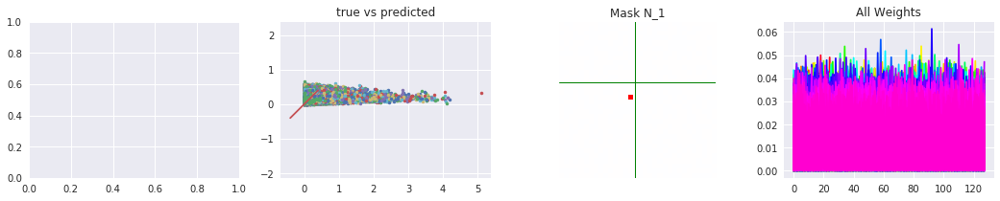

Total FEV =  -0.00721265639852
Runs: 100; MSE - train: 0.139513, val: 0.152129611661; lr = 0.001
best run:  100 0.152129611661
Loss/Regularization: 0.0508092667442 MSE, 0.0 kernel, 0.00166305828094 mask, 0.00291585683823 weights


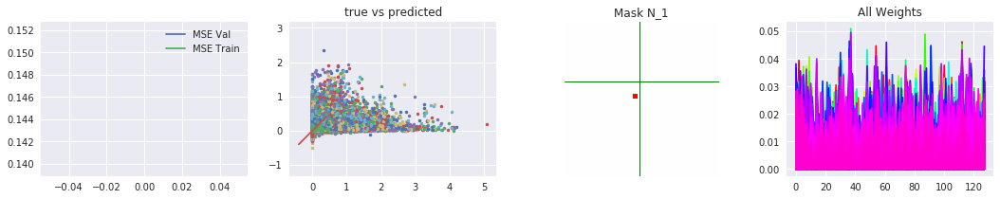

Total FEV =  0.171133573451
Runs: 200; MSE - train: 0.12754, val: 0.142917627709; lr = 0.001
best run:  200 0.142917627709
Loss/Regularization: 0.0418125160504 MSE, 0.0 kernel, 0.00212370729446 mask, 0.00354244858027 weights


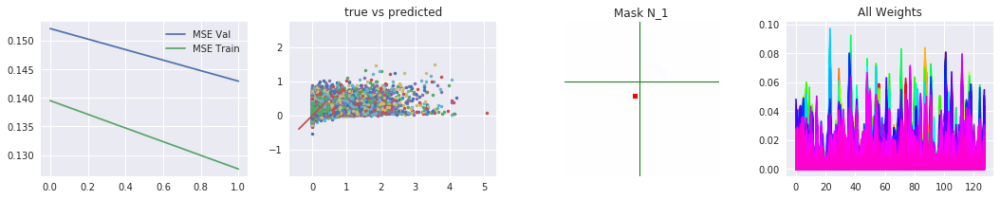

Total FEV =  0.243153594156
Runs: 300; MSE - train: 0.12511, val: 0.139189944813; lr = 0.001
best run:  300 0.139189944813
Loss/Regularization: 0.0381794357672 MSE, 0.0 kernel, 0.0026113653183 mask, 0.00391417920589 weights


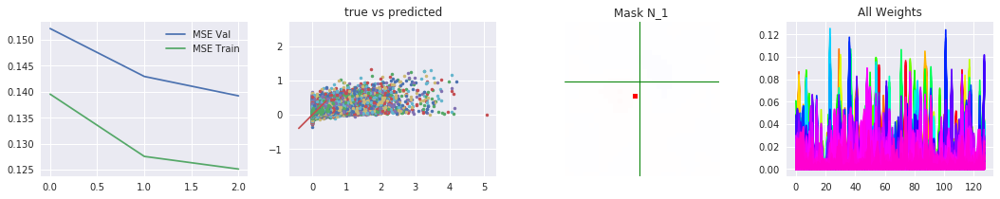

Total FEV =  0.32007164391
Runs: 400; MSE - train: 0.137649, val: 0.1351514136; lr = 0.001
best run:  400 0.1351514136
Loss/Regularization: 0.0342992723454 MSE, 0.0 kernel, 0.00296733260155 mask, 0.00408139824867 weights


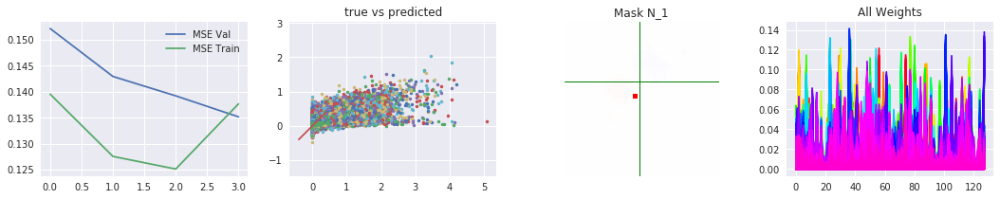

Total FEV =  0.401754867966
Runs: 500; MSE - train: 0.117304, val: 0.130890996646; lr = 0.001
best run:  500 0.130890996646
Loss/Regularization: 0.0301787276985 MSE, 0.0 kernel, 0.00326146817207 mask, 0.00416680455208 weights


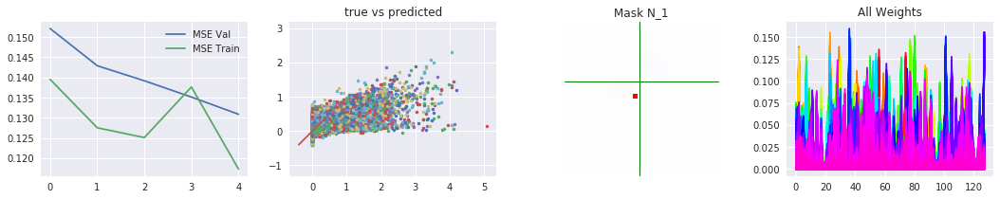

Total FEV =  0.461466193743
Runs: 600; MSE - train: 0.112416, val: 0.127761321503; lr = 0.001
best run:  600 0.127761321503
Loss/Regularization: 0.027166564716 MSE, 0.0 kernel, 0.00347675323486 mask, 0.00422850906849 weights


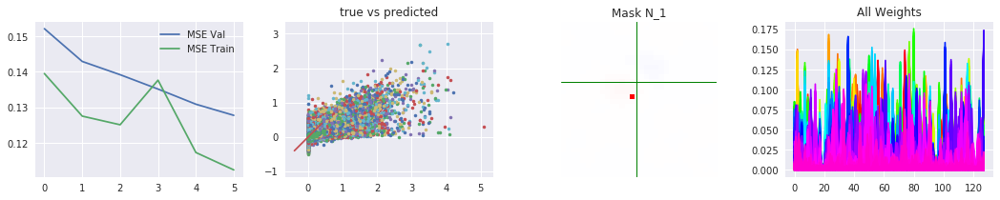

Total FEV =  0.518599691117
Runs: 700; MSE - train: 0.113175, val: 0.124791800315; lr = 0.001
best run:  700 0.124791800315
Loss/Regularization: 0.0242844413733 MSE, 0.0 kernel, 0.00364636993408 mask, 0.0042883682251 weights


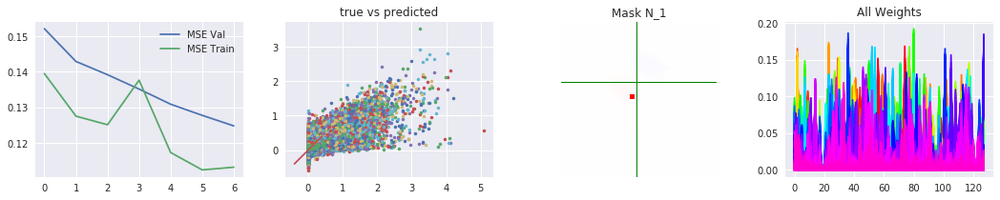

Total FEV =  0.572092662886
Runs: 800; MSE - train: 0.130687, val: 0.122007096547; lr = 0.001
best run:  800 0.122007096547
Loss/Regularization: 0.0215859658783 MSE, 0.0 kernel, 0.00380885744095 mask, 0.00434441238642 weights


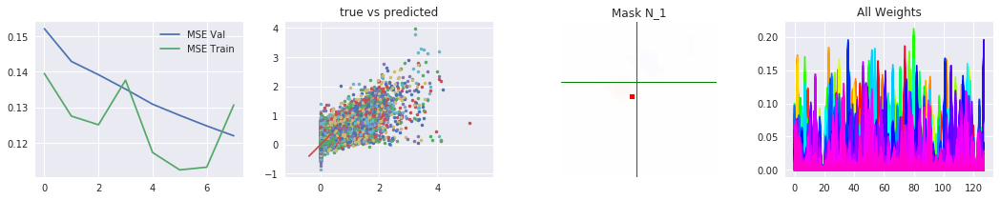

Total FEV =  0.59947992732
Runs: 900; MSE - train: 0.114241, val: 0.120589314329; lr = 0.001
best run:  900 0.120589314329
Loss/Regularization: 0.0202044037869 MSE, 0.0 kernel, 0.0039068903923 mask, 0.00432804107666 weights


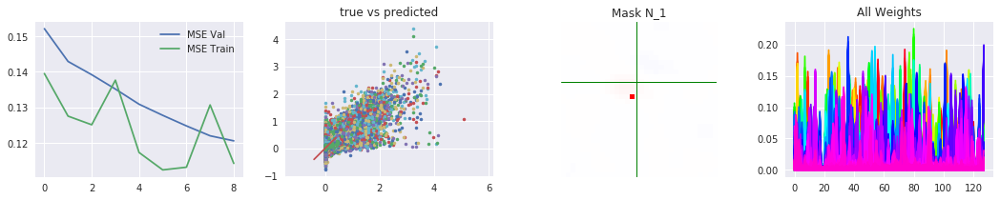

Total FEV =  0.622180561658
Runs: 1000; MSE - train: 0.117671, val: 0.119382123853; lr = 0.001
best run:  1000 0.119382123853
Loss/Regularization: 0.019059260725 MSE, 0.0 kernel, 0.00401757764816 mask, 0.004343329072 weights


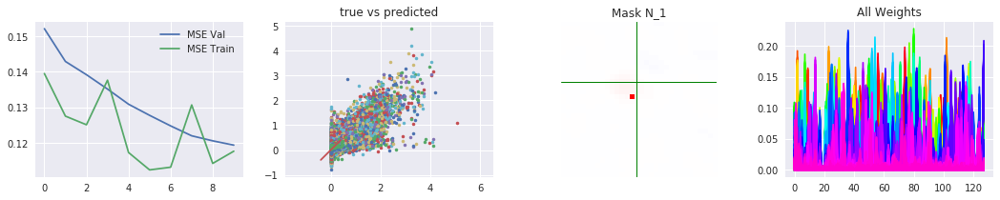

Total FEV =  0.637072630508
Runs: 1100; MSE - train: 0.120499, val: 0.11865147047; lr = 0.001
best run:  1100 0.11865147047
Loss/Regularization: 0.0183080240386 MSE, 0.0 kernel, 0.00410673141479 mask, 0.00433787703514 weights


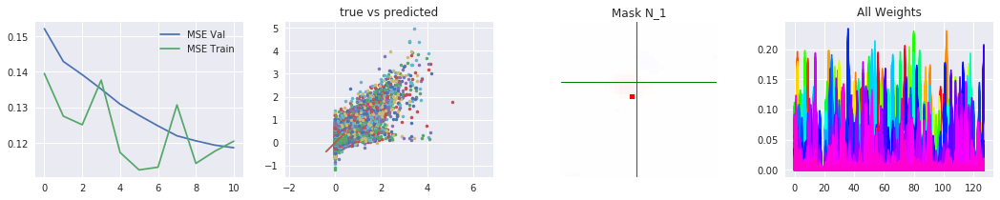

Total FEV =  0.633084050344
Runs: 1200; MSE - train: 0.112577, val: 0.118844163935; lr = 0.001
best run:  1100 0.11865147047
Loss/Regularization: 0.0185092296451 MSE, 0.0 kernel, 0.00413911914825 mask, 0.00430381566286 weights


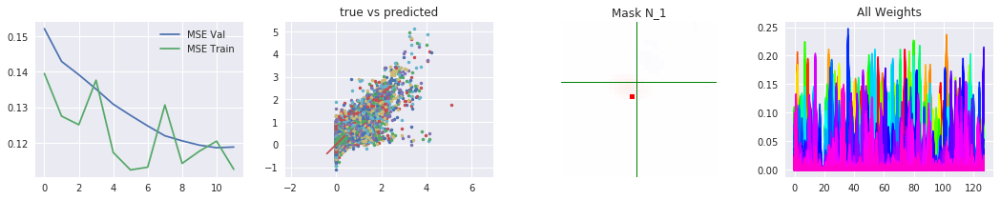

Total FEV =  0.612333961571
Runs: 1300; MSE - train: 0.101039, val: 0.119912812366; lr = 0.001
best run:  1100 0.11865147047
Loss/Regularization: 0.0195559766144 MSE, 0.0 kernel, 0.00417764186859 mask, 0.00433458209038 weights


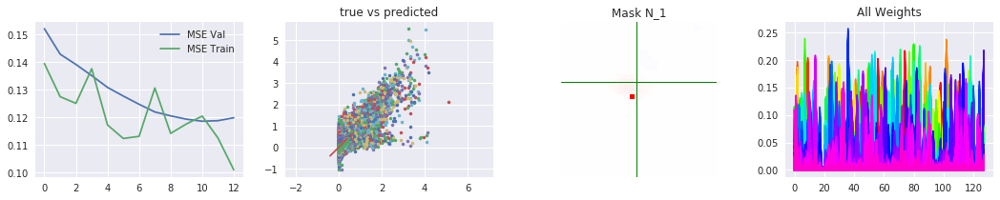

Total FEV =  0.548481951956
Runs: 1400; MSE - train: 0.124232, val: 0.123211246885; lr = 0.001
best run:  1100 0.11865147047
Loss/Regularization: 0.0227770181373 MSE, 0.0 kernel, 0.00418855237961 mask, 0.00426038384438 weights


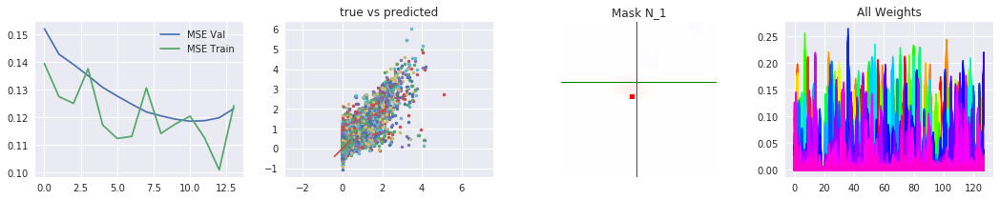

Total FEV =  0.645802781327
Runs: 1500; MSE - train: 0.109854, val: 0.118302832147; lr = 0.001
best run:  1500 0.118302832147
Loss/Regularization: 0.0178676279029 MSE, 0.0 kernel, 0.00422784662247 mask, 0.00421465158463 weights


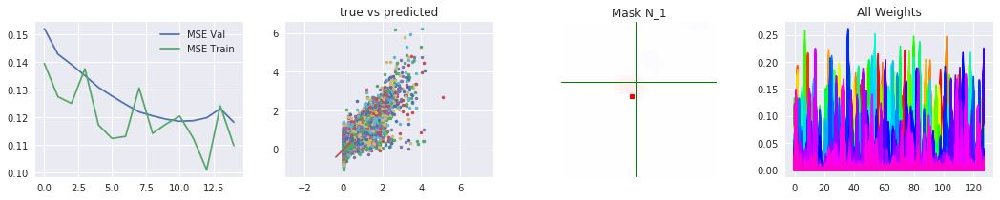

Total FEV =  0.628597481231
Runs: 1600; MSE - train: 0.0984181, val: 0.119139933298; lr = 0.001
best run:  1500 0.118302832147
Loss/Regularization: 0.018735556514 MSE, 0.0 kernel, 0.00426439285278 mask, 0.00416788697243 weights


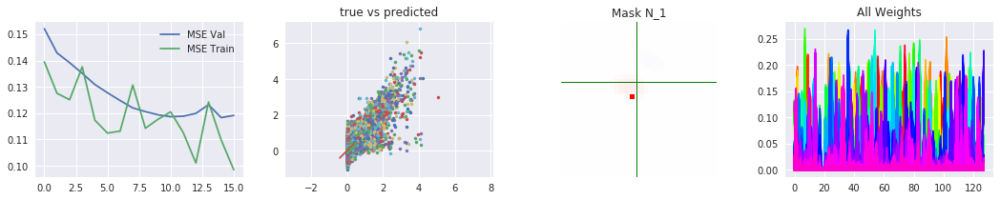

Total FEV =  0.59156833473
Runs: 1700; MSE - train: 0.105397, val: 0.120994690505; lr = 0.001
best run:  1500 0.118302832147
Loss/Regularization: 0.0206035074079 MSE, 0.0 kernel, 0.00430816173553 mask, 0.00423239350319 weights


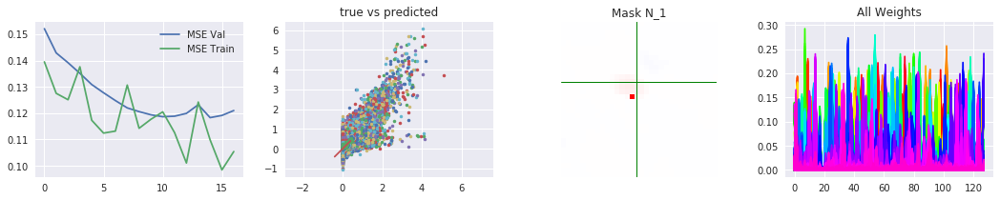

Total FEV =  0.519963911753
Runs: 1800; MSE - train: 0.108743, val: 0.124728422552; lr = 0.001
best run:  1500 0.118302832147
Loss/Regularization: 0.0242156226886 MSE, 0.0 kernel, 0.0044049115181 mask, 0.0042370402813 weights


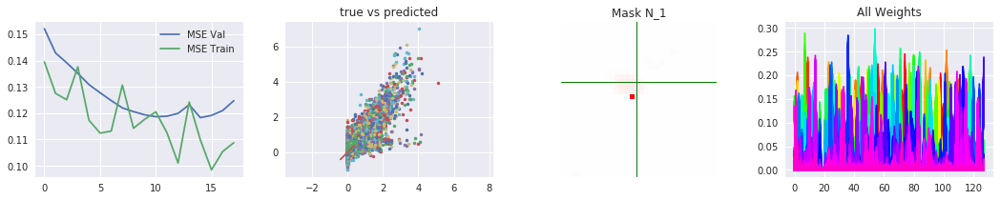

Total FEV =  0.586421661985
Runs: 1900; MSE - train: 0.108892, val: 0.121295638983; lr = 0.001
best run:  1500 0.118302832147
Loss/Regularization: 0.0208631334826 MSE, 0.0 kernel, 0.00441765642166 mask, 0.00420536965132 weights


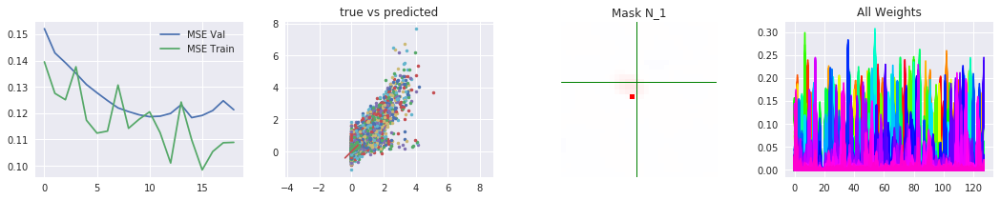

Total FEV =  0.632703816547
Runs: 2000; MSE - train: 0.108898, val: 0.118883074411; lr = 0.001
best run:  1500 0.118302832147
Loss/Regularization: 0.0185284106992 MSE, 0.0 kernel, 0.00441880178452 mask, 0.00414272844791 weights


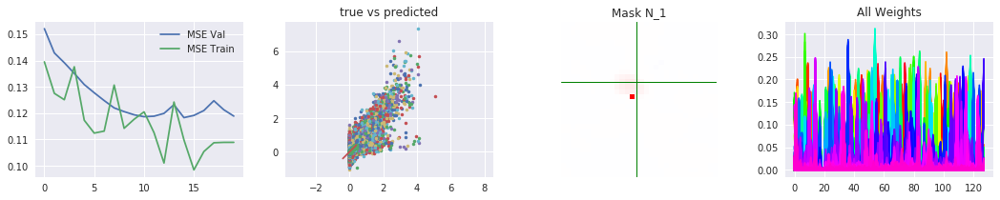

Total FEV =  0.749755816624
Runs: 2100; MSE - train: 0.113643, val: 0.112939370255; lr = 0.0001
best run:  2100 0.112939370255
Loss/Regularization: 0.0126236732467 MSE, 0.0 kernel, 0.00396842288971 mask, 0.00326395511627 weights


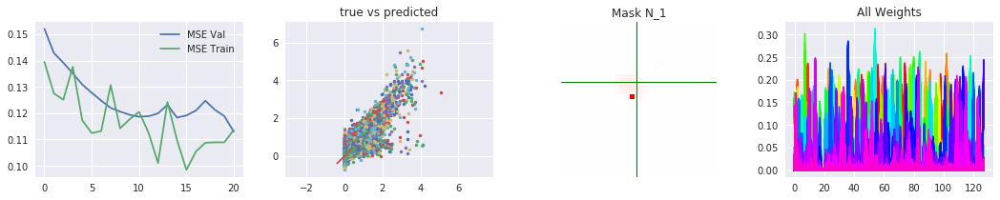

Total FEV =  0.780032446217
Runs: 2200; MSE - train: 0.108569, val: 0.111363566571; lr = 0.0001
best run:  2200 0.111363566571
Loss/Regularization: 0.0110963559127 MSE, 0.0 kernel, 0.00366333699226 mask, 0.00298412233591 weights


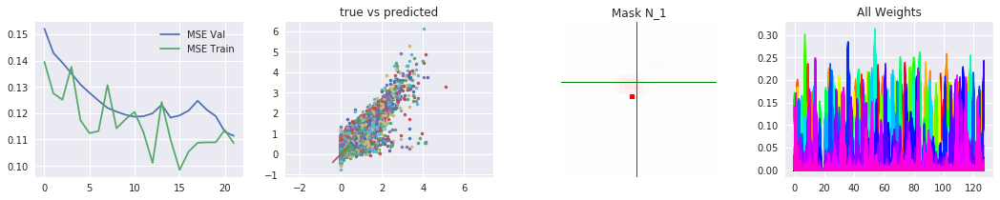

Total FEV =  0.803676841037
Runs: 2300; MSE - train: 0.111767, val: 0.110143986561; lr = 0.0001
best run:  2300 0.110143986561
Loss/Regularization: 0.00990360445576 MSE, 0.0 kernel, 0.0034590485096 mask, 0.00285662323236 weights


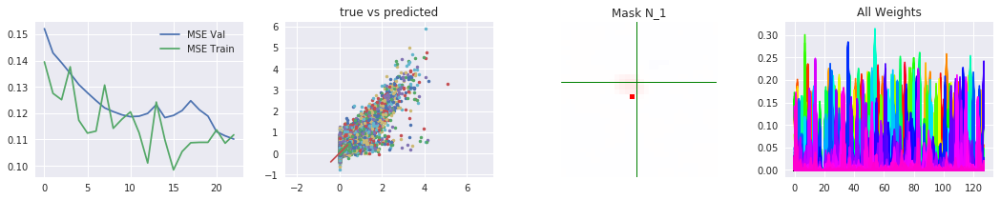

Total FEV =  0.817722771762
Runs: 2400; MSE - train: 0.111661, val: 0.109434730283; lr = 0.0001
best run:  2400 0.109434730283
Loss/Regularization: 0.00919505156344 MSE, 0.0 kernel, 0.00331916427612 mask, 0.00279878079891 weights


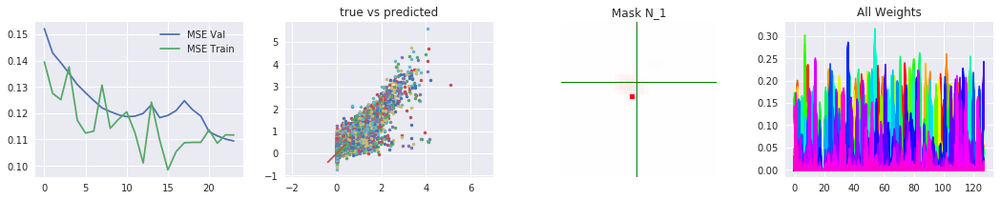

Total FEV =  0.830946717253
Runs: 2500; MSE - train: 0.114231, val: 0.108756899413; lr = 0.0001
best run:  2500 0.108756899413
Loss/Regularization: 0.00852796406252 MSE, 0.0 kernel, 0.00322443556786 mask, 0.00274626523256 weights


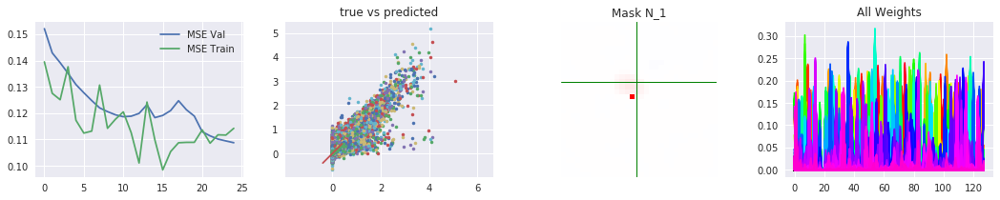

Total FEV =  0.829908421026
Runs: 2600; MSE - train: 0.0917959, val: 0.108806167339; lr = 0.0001
best run:  2500 0.108756899413
Loss/Regularization: 0.00858034135308 MSE, 0.0 kernel, 0.0031587100029 mask, 0.00273380607367 weights


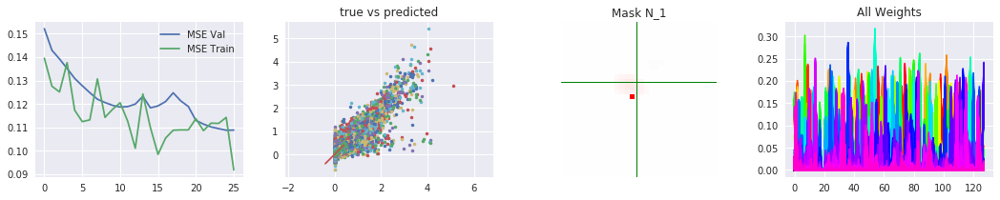

Total FEV =  0.834071673485
Runs: 2700; MSE - train: 0.116691, val: 0.108594260329; lr = 0.0001
best run:  2700 0.108594260329
Loss/Regularization: 0.00837032432901 MSE, 0.0 kernel, 0.00313908219337 mask, 0.00271679133177 weights


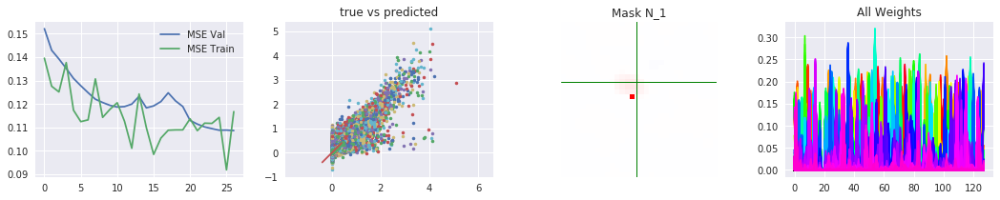

Total FEV =  0.837764694588
Runs: 2800; MSE - train: 0.099724, val: 0.108407702597; lr = 0.0001
best run:  2800 0.108407702597
Loss/Regularization: 0.00818402832374 MSE, 0.0 kernel, 0.00311164283752 mask, 0.00269485712051 weights


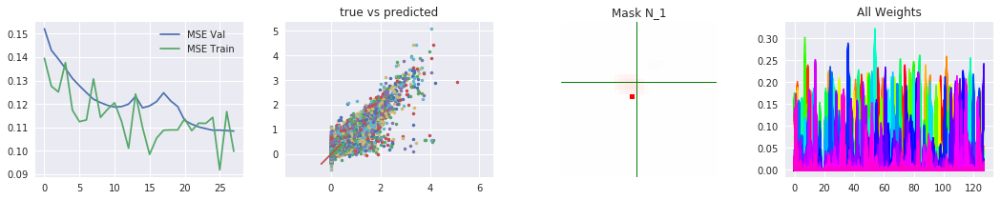

Total FEV =  0.83794944078
Runs: 2900; MSE - train: 0.103178, val: 0.108395386247; lr = 0.0001
best run:  2900 0.108395386247
Loss/Regularization: 0.00817470872425 MSE, 0.0 kernel, 0.00309345531464 mask, 0.00269421815872 weights


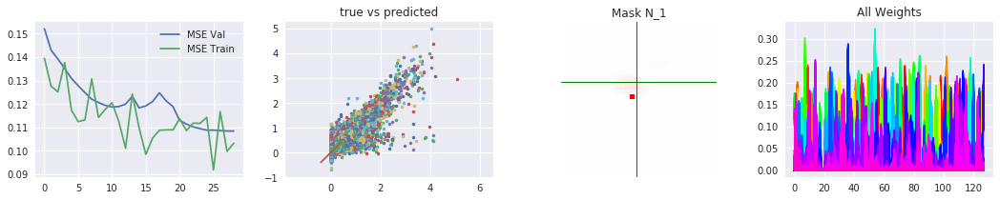

Total FEV =  0.839343547907
Runs: 3000; MSE - train: 0.10432, val: 0.10832445666; lr = 0.0001
best run:  3000 0.10832445666
Loss/Regularization: 0.00810438240296 MSE, 0.0 kernel, 0.00307509899139 mask, 0.00267710119486 weights


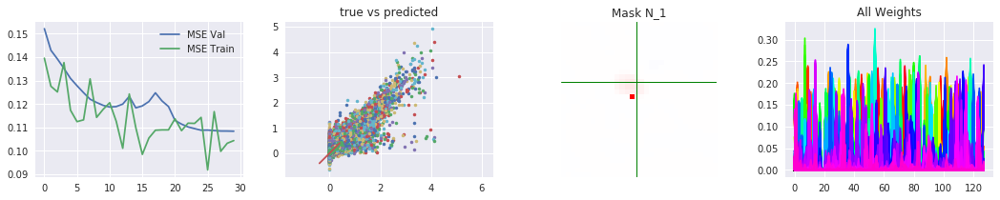

Total FEV =  0.841417560299
Runs: 3100; MSE - train: 0.102263, val: 0.108217035871; lr = 0.0001
best run:  3100 0.108217035871
Loss/Regularization: 0.00799975797418 MSE, 0.0 kernel, 0.00306384062767 mask, 0.0026726102829 weights


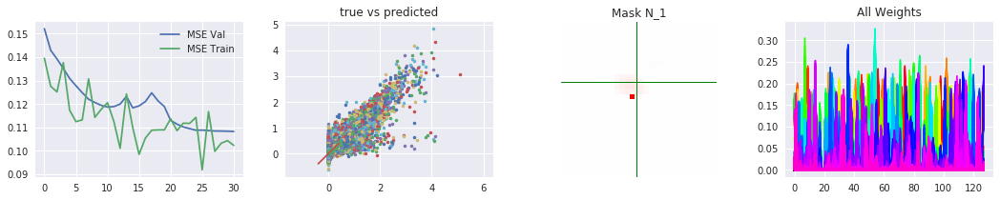

Total FEV =  0.842036941987
Runs: 3200; MSE - train: 0.105848, val: 0.108188827372; lr = 0.0001
best run:  3200 0.108188827372
Loss/Regularization: 0.00796851300402 MSE, 0.0 kernel, 0.00305453872681 mask, 0.00265884488821 weights


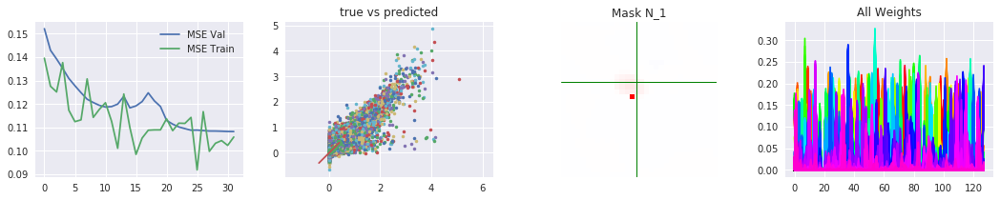

Total FEV =  0.842459555846
Runs: 3300; MSE - train: 0.113469, val: 0.10817192567; lr = 0.0001
best run:  3300 0.10817192567
Loss/Regularization: 0.00794719406986 MSE, 0.0 kernel, 0.0030443520546 mask, 0.00265407145023 weights


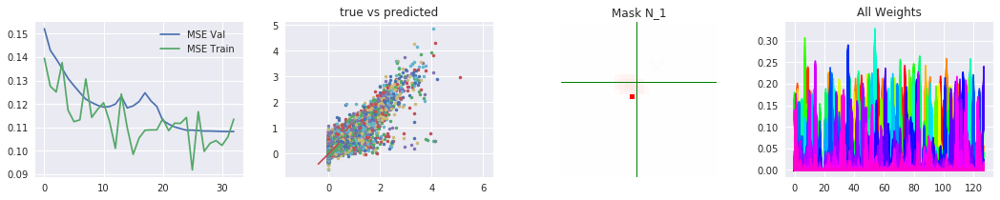

Total FEV =  0.843461146187
Runs: 3400; MSE - train: 0.110283, val: 0.108120128092; lr = 0.0001
best run:  3400 0.108120128092
Loss/Regularization: 0.0078966684232 MSE, 0.0 kernel, 0.00304776620865 mask, 0.00264752626419 weights


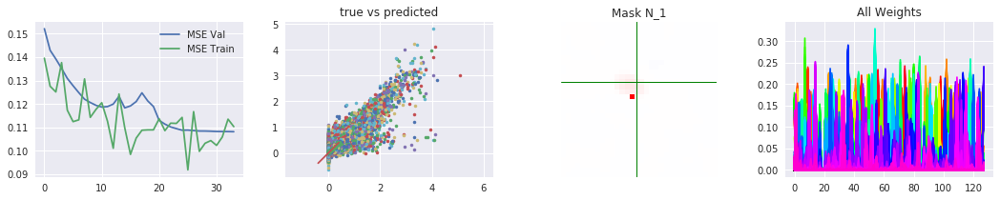

Total FEV =  0.844554580284
Runs: 3500; MSE - train: 0.1164, val: 0.1080610111; lr = 0.0001
best run:  3500 0.1080610111
Loss/Regularization: 0.00784150967957 MSE, 0.0 kernel, 0.00304695796967 mask, 0.00263985663652 weights


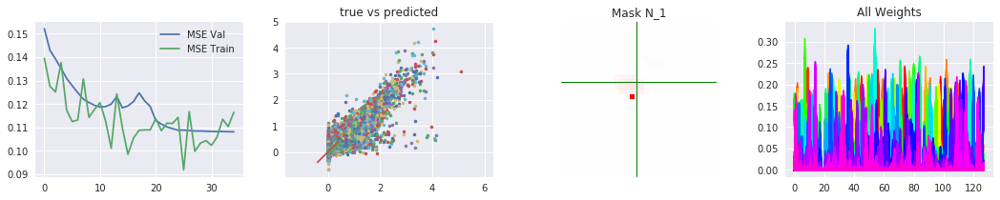

Total FEV =  0.844033029227
Runs: 3600; MSE - train: 0.10153, val: 0.108084654195; lr = 0.0001
best run:  3500 0.1080610111
Loss/Regularization: 0.0078678195423 MSE, 0.0 kernel, 0.00305487918854 mask, 0.0026320630312 weights


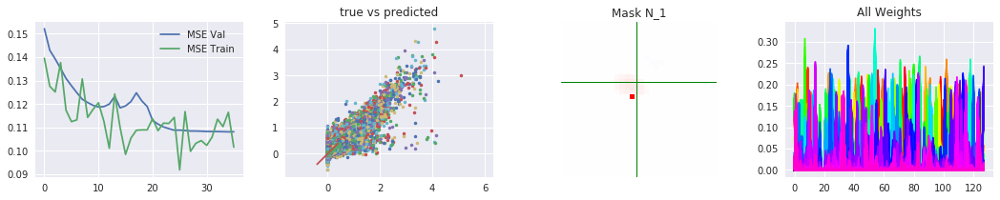

Total FEV =  0.844487415585
Runs: 3700; MSE - train: 0.101671, val: 0.10805678614; lr = 0.0001
best run:  3700 0.10805678614
Loss/Regularization: 0.00784489783109 MSE, 0.0 kernel, 0.00305122518539 mask, 0.00263140439987 weights


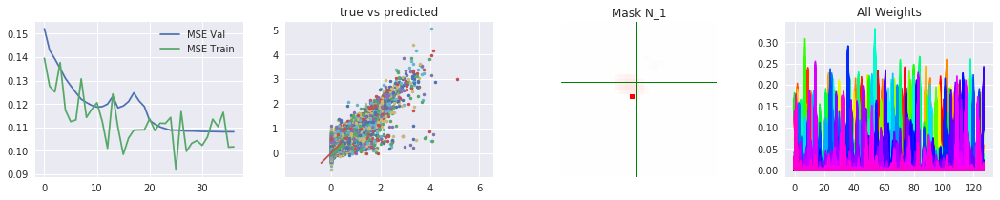

Total FEV =  0.844940596721
Runs: 3800; MSE - train: 0.108182, val: 0.108037133851; lr = 0.0001
best run:  3800 0.108037133851
Loss/Regularization: 0.00782203691779 MSE, 0.0 kernel, 0.00304273748398 mask, 0.00262989759445 weights


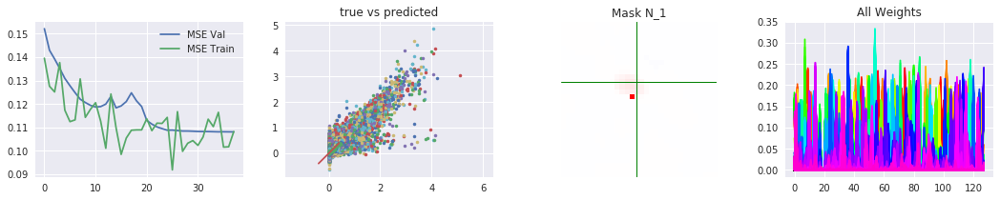

Total FEV =  0.843177105674
Runs: 3900; MSE - train: 0.102963, val: 0.10812595721; lr = 0.0001
best run:  3800 0.108037133851
Loss/Regularization: 0.00791099696653 MSE, 0.0 kernel, 0.00303400015831 mask, 0.00263556003571 weights


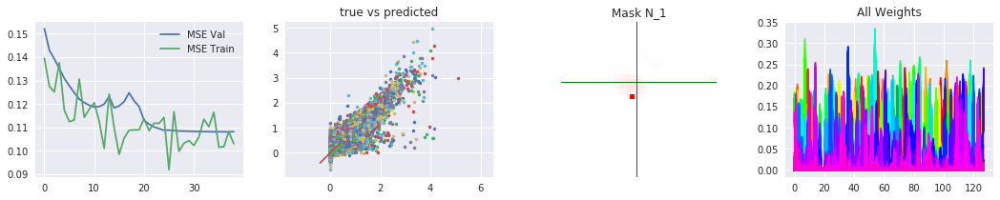

Total FEV =  0.847268707748
Runs: 4000; MSE - train: 0.104968, val: 0.10791543763; lr = 0.0001
best run:  4000 0.10791543763
Loss/Regularization: 0.00770459437626 MSE, 0.0 kernel, 0.0030350458622 mask, 0.00261317193508 weights


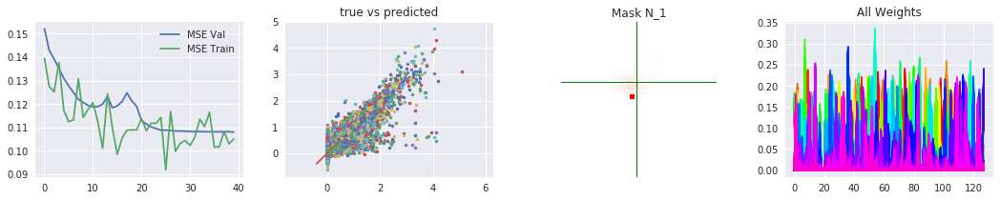

Total FEV =  0.848411548423
Runs: 4100; MSE - train: 0.116182, val: 0.107861989028; lr = 0.0001
best run:  4100 0.107861989028
Loss/Regularization: 0.007646943297 MSE, 0.0 kernel, 0.00303638935089 mask, 0.00260660707951 weights


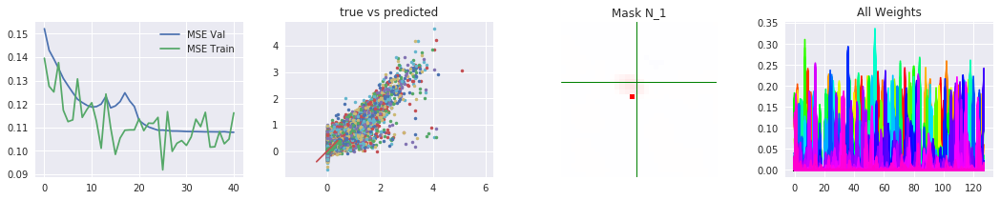

Total FEV =  0.848252065149
Runs: 4200; MSE - train: 0.106978, val: 0.107879100728; lr = 0.0001
best run:  4100 0.107861989028
Loss/Regularization: 0.00765498849796 MSE, 0.0 kernel, 0.00303289532661 mask, 0.00260970652103 weights


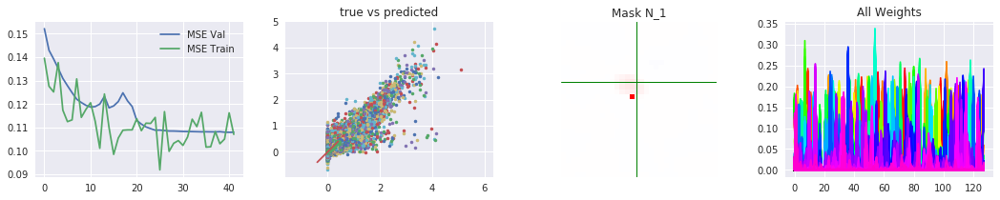

Total FEV =  0.849527415562
Runs: 4300; MSE - train: 0.105112, val: 0.107794529909; lr = 0.0001
best run:  4300 0.107794529909
Loss/Regularization: 0.00759065290913 MSE, 0.0 kernel, 0.00303166532516 mask, 0.002588788867 weights


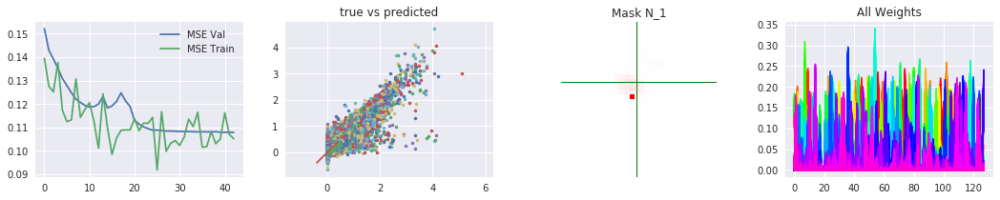

Total FEV =  0.84939031052
Runs: 4400; MSE - train: 0.0950826, val: 0.107807162849; lr = 0.0001
best run:  4300 0.107794529909
Loss/Regularization: 0.00759756923071 MSE, 0.0 kernel, 0.00305047225952 mask, 0.0025929325819 weights


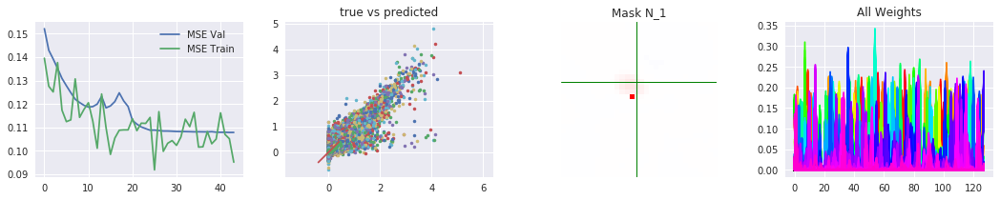

Total FEV =  0.849608401941
Runs: 4500; MSE - train: 0.104244, val: 0.107789936686; lr = 0.0001
best run:  4500 0.107789936686
Loss/Regularization: 0.00758656751714 MSE, 0.0 kernel, 0.00304765462875 mask, 0.00259553968906 weights


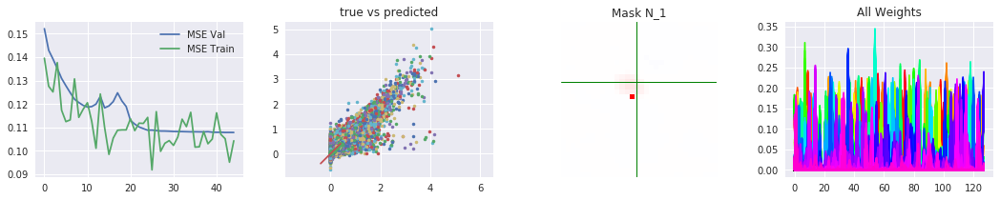

Total FEV =  0.849814599228
Runs: 4600; MSE - train: 0.0978365, val: 0.107784387986; lr = 0.0001
best run:  4600 0.107784387986
Loss/Regularization: 0.00757616580813 MSE, 0.0 kernel, 0.00304614400864 mask, 0.00257036298513 weights


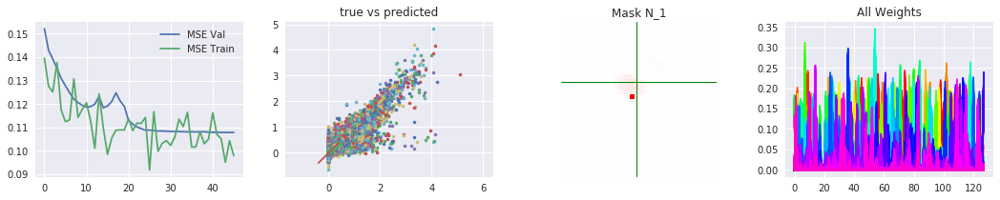

Total FEV =  0.850923357925
Runs: 4700; MSE - train: 0.120217, val: 0.107728241612; lr = 0.0001
best run:  4700 0.107728241612
Loss/Regularization: 0.00752023400855 MSE, 0.0 kernel, 0.00304400491714 mask, 0.00257905870676 weights


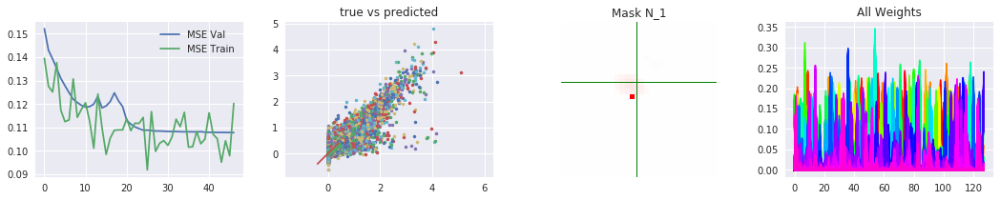

Total FEV =  0.853056400204
Runs: 4800; MSE - train: 0.105279, val: 0.107619440363; lr = 0.0001
best run:  4800 0.107619440363
Loss/Regularization: 0.00741263179225 MSE, 0.0 kernel, 0.00303380203247 mask, 0.00256648510695 weights


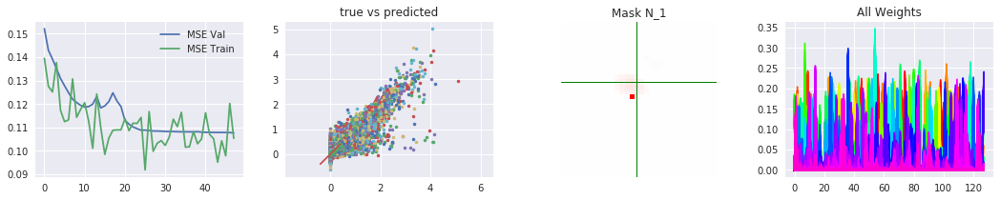

Total FEV =  0.853076897045
Runs: 4900; MSE - train: 0.109766, val: 0.107616150031; lr = 0.0001
best run:  4900 0.107616150031
Loss/Regularization: 0.00741159782046 MSE, 0.0 kernel, 0.0030323972702 mask, 0.00257585704327 weights


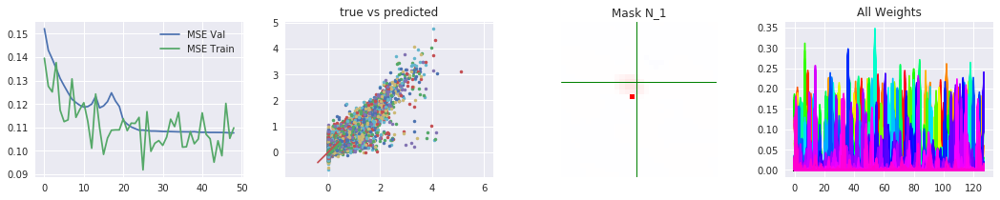

Total FEV =  0.854494922827
Runs: 5000; MSE - train: 0.105903, val: 0.10754732337; lr = 0.0001
best run:  5000 0.10754732337
Loss/Regularization: 0.00734006491257 MSE, 0.0 kernel, 0.00303126144409 mask, 0.00256681442261 weights


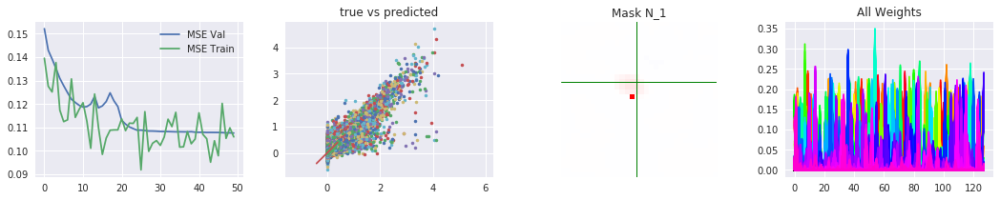

Total FEV =  0.854545319428
Runs: 5100; MSE - train: 0.104361, val: 0.107535645546; lr = 0.0001
best run:  5100 0.107535645546
Loss/Regularization: 0.00733752263477 MSE, 0.0 kernel, 0.00302640032768 mask, 0.00256358295679 weights


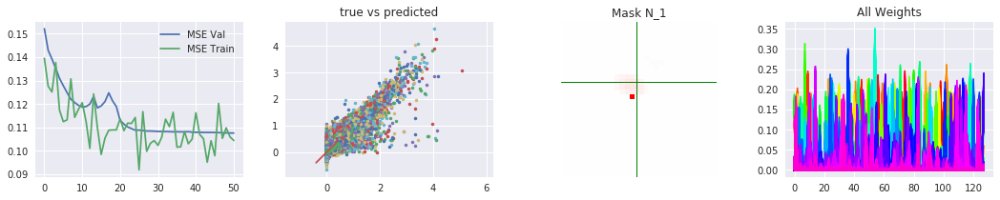

Total FEV =  0.854868302036
Runs: 5200; MSE - train: 0.101975, val: 0.107511041686; lr = 0.0001
best run:  5200 0.107511041686
Loss/Regularization: 0.00732122964109 MSE, 0.0 kernel, 0.00302872371674 mask, 0.00255299985409 weights


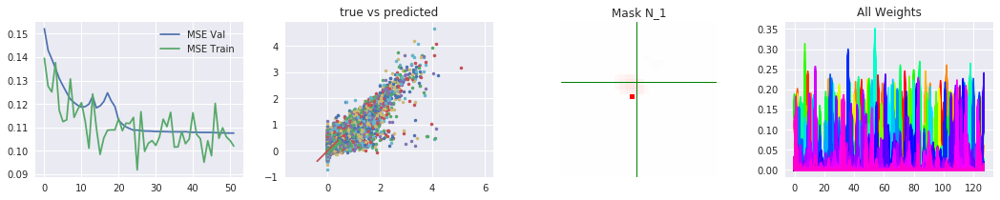

Total FEV =  0.853785676854
Runs: 5300; MSE - train: 0.0956377, val: 0.107569882766; lr = 0.0001
best run:  5200 0.107511041686
Loss/Regularization: 0.00737584312446 MSE, 0.0 kernel, 0.00304506516457 mask, 0.00256572902203 weights


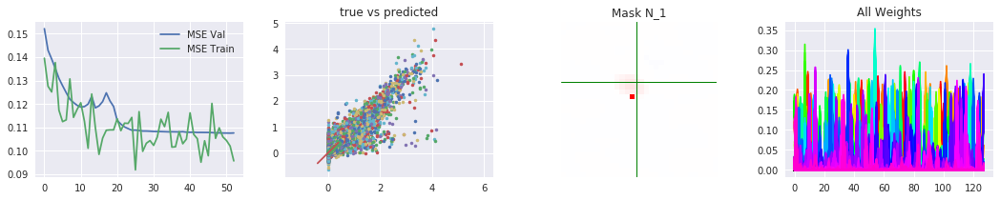

Total FEV =  0.8566379115
Runs: 5400; MSE - train: 0.109562, val: 0.107423707302; lr = 0.0001
best run:  5400 0.107423707302
Loss/Regularization: 0.00723196094623 MSE, 0.0 kernel, 0.00304431509972 mask, 0.00254635572433 weights


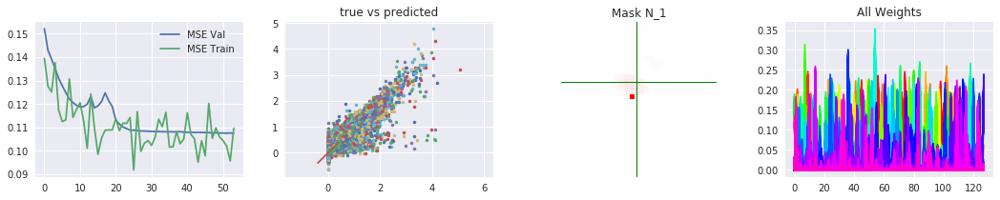

Total FEV =  0.857507110951
Runs: 5500; MSE - train: 0.108743, val: 0.107379585084; lr = 0.0001
best run:  5500 0.107379585084
Loss/Regularization: 0.00718811381375 MSE, 0.0 kernel, 0.00303790569305 mask, 0.00254708588123 weights


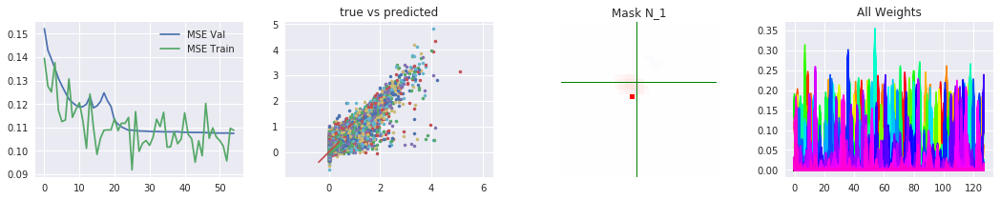

Total FEV =  0.858437872466
Runs: 5600; MSE - train: 0.104693, val: 0.107340650813; lr = 0.0001
best run:  5600 0.107340650813
Loss/Regularization: 0.00714116115705 MSE, 0.0 kernel, 0.00303678750992 mask, 0.00254456460476 weights


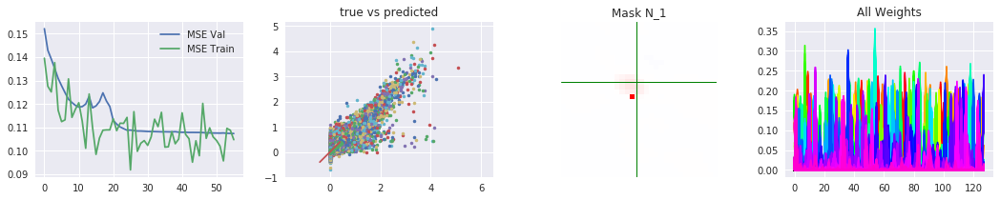

Total FEV =  0.85819244
Runs: 5700; MSE - train: 0.0978473, val: 0.107341130294; lr = 0.0001
best run:  5600 0.107340650813
Loss/Regularization: 0.00715354210115 MSE, 0.0 kernel, 0.00303494882584 mask, 0.00255208879709 weights


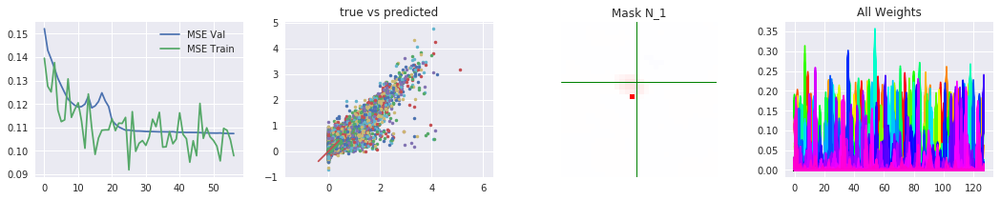

Total FEV =  0.858967563526
Runs: 5800; MSE - train: 0.10757, val: 0.10730127822; lr = 0.0001
best run:  5800 0.10730127822
Loss/Regularization: 0.00711444066837 MSE, 0.0 kernel, 0.00303837013245 mask, 0.00253602713346 weights


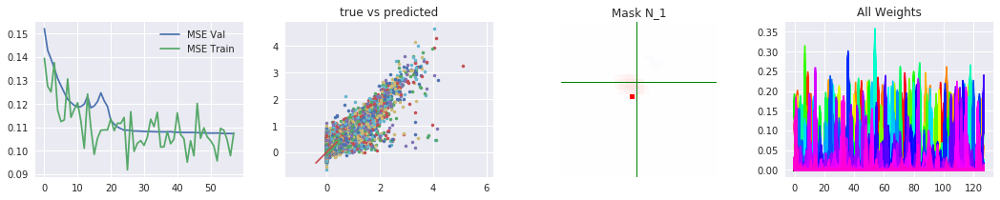

Total FEV =  0.860066506218
Runs: 5900; MSE - train: 0.10881, val: 0.10724674664; lr = 0.0001
best run:  5900 0.10724674664
Loss/Regularization: 0.00705900404137 MSE, 0.0 kernel, 0.00302891016006 mask, 0.00253505825996 weights


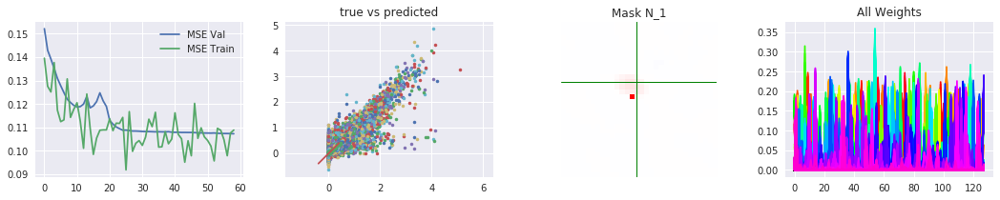

Total FEV =  0.861435782553
Runs: 6000; MSE - train: 0.10228, val: 0.107178863078; lr = 0.0001
best run:  6000 0.107178863078
Loss/Regularization: 0.00698993031983 MSE, 0.0 kernel, 0.00302645993233 mask, 0.00252459317446 weights


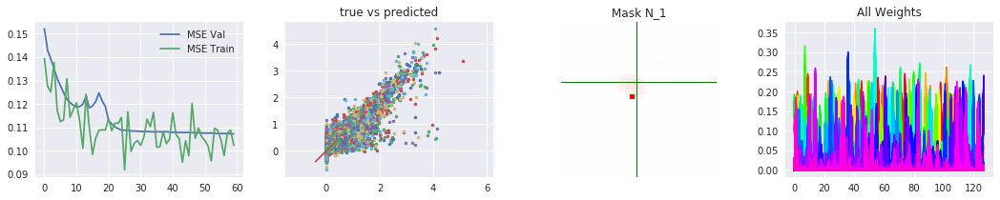

Total FEV =  0.861417517304
Runs: 6100; MSE - train: 0.108403, val: 0.107174506471; lr = 0.0001
best run:  6100 0.107174506471
Loss/Regularization: 0.006990851718 MSE, 0.0 kernel, 0.00302617120743 mask, 0.00252790808678 weights


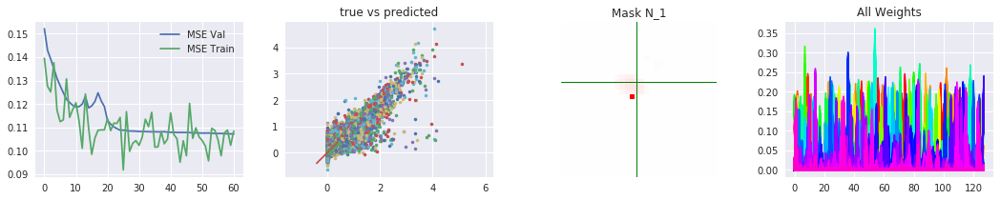

Total FEV =  0.861912045208
Runs: 6200; MSE - train: 0.106618, val: 0.107155629223; lr = 0.0001
best run:  6200 0.107155629223
Loss/Regularization: 0.00696590504958 MSE, 0.0 kernel, 0.00304332518578 mask, 0.0025219643116 weights


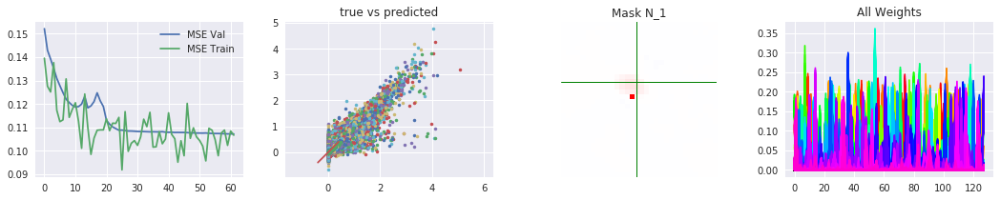

Total FEV =  0.862036154743
Runs: 6300; MSE - train: 0.114798, val: 0.107141607771; lr = 0.0001
best run:  6300 0.107141607771
Loss/Regularization: 0.00695964429178 MSE, 0.0 kernel, 0.0030397708416 mask, 0.00251850664616 weights


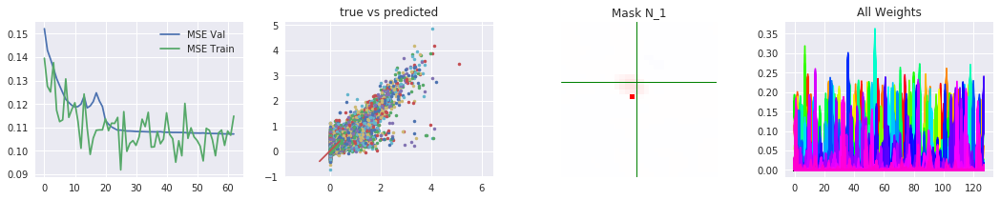

Total FEV =  0.863585521388
Runs: 6400; MSE - train: 0.112192, val: 0.107056580063; lr = 0.0001
best run:  6400 0.107056580063
Loss/Regularization: 0.00688148583868 MSE, 0.0 kernel, 0.00302978610992 mask, 0.00251975774765 weights


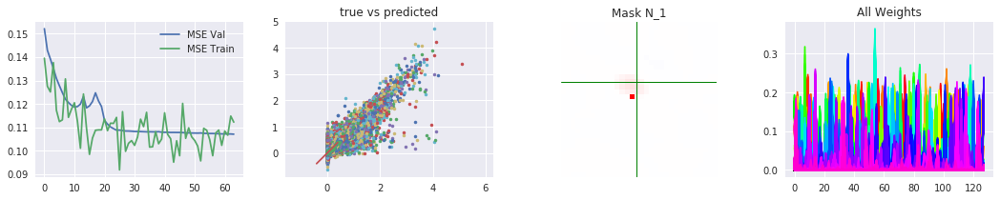

Total FEV =  0.863313232505
Runs: 6500; MSE - train: 0.104176, val: 0.107076962448; lr = 0.0001
best run:  6400 0.107056580063
Loss/Regularization: 0.00689522156608 MSE, 0.0 kernel, 0.0030294342041 mask, 0.00250576019287 weights


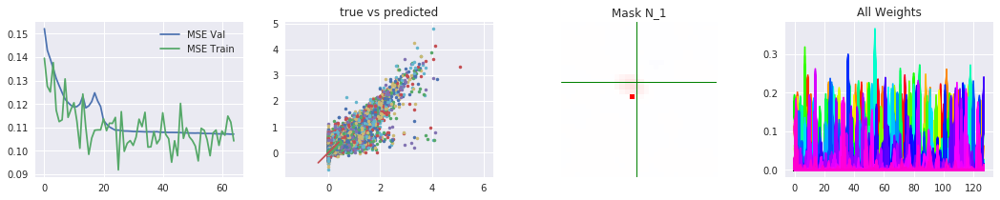

Total FEV =  0.862925701609
Runs: 6600; MSE - train: 0.114564, val: 0.107095295323; lr = 0.0001
best run:  6400 0.107056580063
Loss/Regularization: 0.00691477072542 MSE, 0.0 kernel, 0.00302313828468 mask, 0.0025215870142 weights


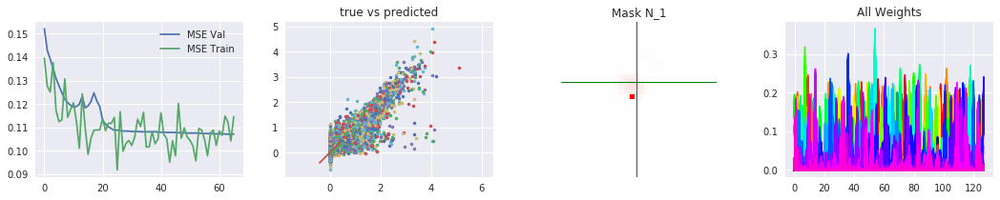

Total FEV =  0.864381367915
Runs: 6700; MSE - train: 0.108123, val: 0.107021970254; lr = 0.0001
best run:  6700 0.107021970254
Loss/Regularization: 0.00684133902541 MSE, 0.0 kernel, 0.00302240085602 mask, 0.002511472404 weights


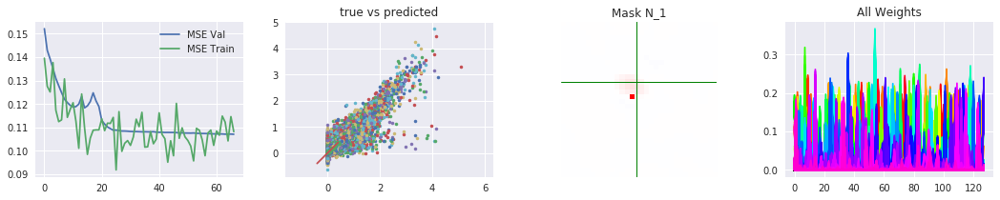

Total FEV =  0.865279729801
Runs: 6800; MSE - train: 0.106694, val: 0.106978840585; lr = 0.0001
best run:  6800 0.106978840585
Loss/Regularization: 0.00679602078162 MSE, 0.0 kernel, 0.00302497553825 mask, 0.00249934911728 weights


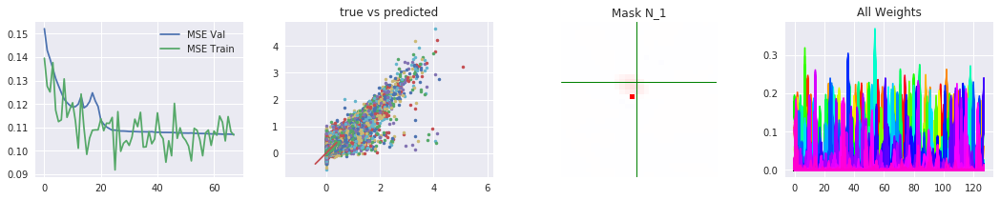

Total FEV =  0.86667960976
Runs: 6900; MSE - train: 0.107884, val: 0.106898862328; lr = 0.0001
best run:  6900 0.106898862328
Loss/Regularization: 0.0067254032474 MSE, 0.0 kernel, 0.00301927828789 mask, 0.0024990208447 weights


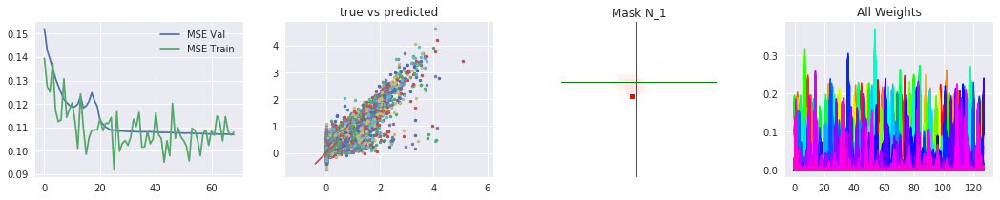

Total FEV =  0.86661193101
Runs: 7000; MSE - train: 0.108921, val: 0.106906783737; lr = 0.0001
best run:  6900 0.106898862328
Loss/Regularization: 0.00672881733044 MSE, 0.0 kernel, 0.00302825117111 mask, 0.00249988526106 weights


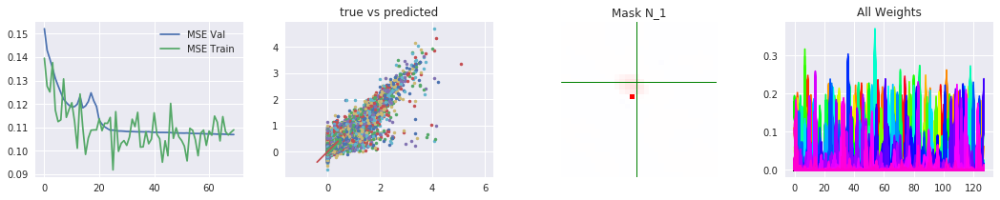

Total FEV =  0.86747316123
Runs: 7100; MSE - train: 0.114425, val: 0.106860282621; lr = 0.0001
best run:  7100 0.106860282621
Loss/Regularization: 0.00668537220918 MSE, 0.0 kernel, 0.00303545355797 mask, 0.00249420106411 weights


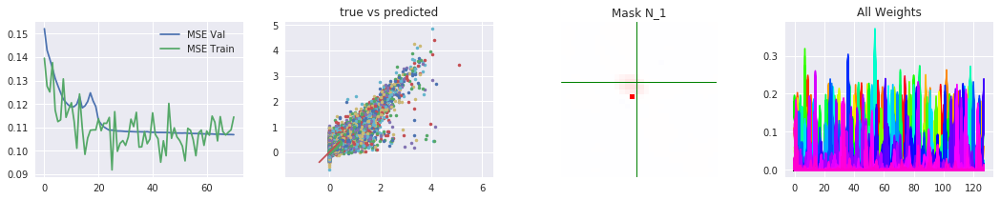

Total FEV =  0.867681010288
Runs: 7200; MSE - train: 0.0999736, val: 0.106853299203; lr = 0.0001
best run:  7200 0.106853299203
Loss/Regularization: 0.0066748871759 MSE, 0.0 kernel, 0.00303036928177 mask, 0.00248928040266 weights


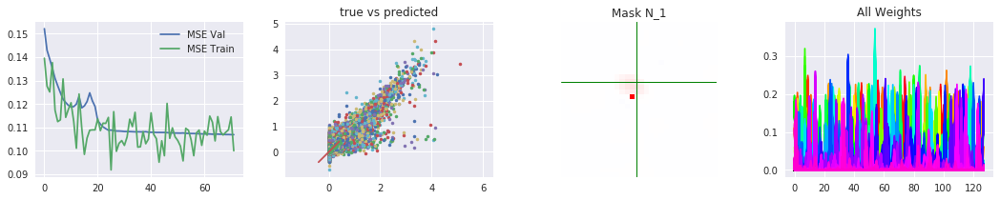

Total FEV =  0.868951430774
Runs: 7300; MSE - train: 0.0994844, val: 0.106782528602; lr = 0.0001
best run:  7300 0.106782528602
Loss/Regularization: 0.0066108002793 MSE, 0.0 kernel, 0.00302918815613 mask, 0.00249406129122 weights


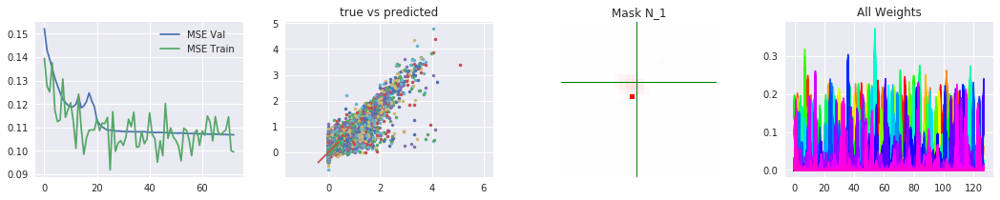

Total FEV =  0.869687791056
Runs: 7400; MSE - train: 0.105878, val: 0.106746756442; lr = 0.0001
best run:  7400 0.106746756442
Loss/Regularization: 0.00657365427469 MSE, 0.0 kernel, 0.00302277565002 mask, 0.00248100757599 weights


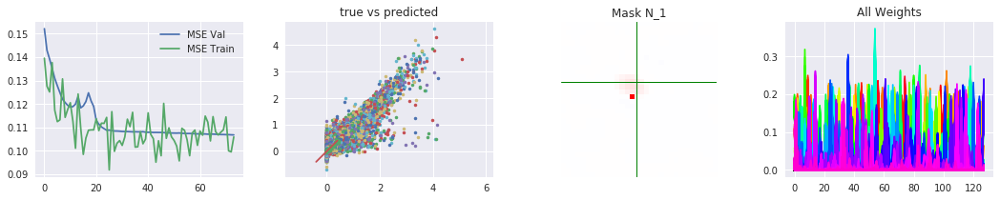

Total FEV =  0.869812598685
Runs: 7500; MSE - train: 0.112479, val: 0.106736168446; lr = 0.0001
best run:  7500 0.106736168446
Loss/Regularization: 0.00656735830125 MSE, 0.0 kernel, 0.00301327943802 mask, 0.00247476160526 weights


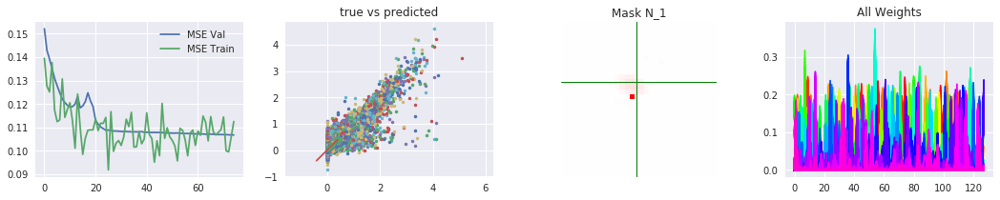

Total FEV =  0.869551815657
Runs: 7600; MSE - train: 0.108884, val: 0.106733589403; lr = 0.0001
best run:  7600 0.106733589403
Loss/Regularization: 0.00658051361097 MSE, 0.0 kernel, 0.0030102186203 mask, 0.00248262763023 weights


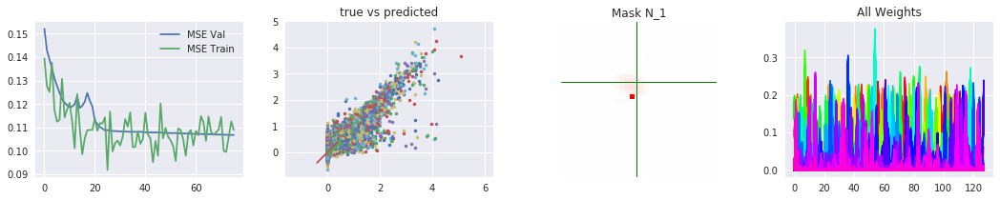

Total FEV =  0.870006006433
Runs: 7700; MSE - train: 0.0997155, val: 0.106719211345; lr = 0.0001
best run:  7700 0.106719211345
Loss/Regularization: 0.00655760176596 MSE, 0.0 kernel, 0.00301182961464 mask, 0.00248508408666 weights


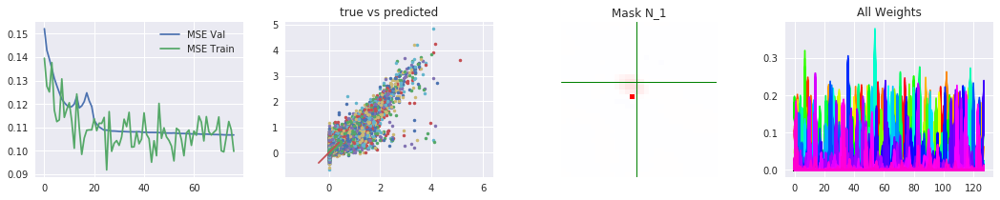

Total FEV =  0.869339325718
Runs: 7800; MSE - train: 0.12202, val: 0.106753009942; lr = 0.0001
best run:  7700 0.106719211345
Loss/Regularization: 0.00659123275545 MSE, 0.0 kernel, 0.00300860953331 mask, 0.00248494431376 weights


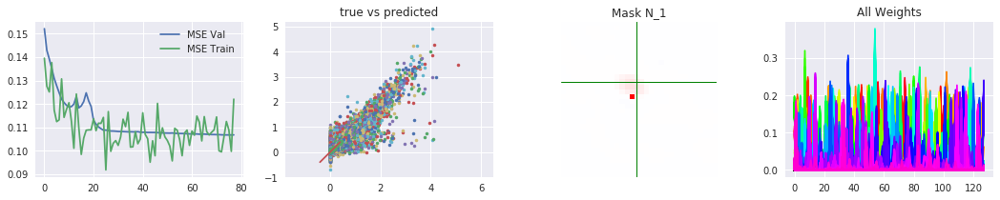

Total FEV =  0.872273361378
Runs: 7900; MSE - train: 0.101837, val: 0.106607644969; lr = 0.0001
best run:  7900 0.106607644969
Loss/Regularization: 0.00644322409062 MSE, 0.0 kernel, 0.00303140735626 mask, 0.00247478306293 weights


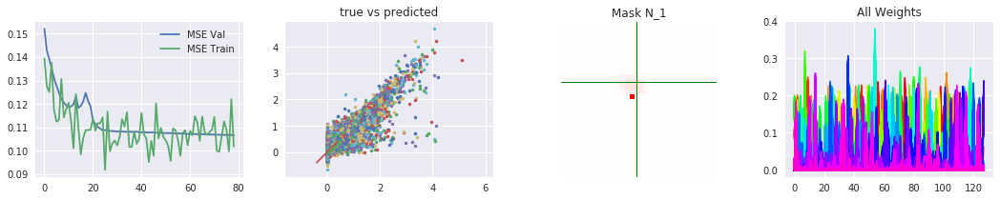

Total FEV =  0.872016776143
Runs: 8000; MSE - train: 0.105711, val: 0.106618011671; lr = 0.0001
best run:  7900 0.106607644969
Loss/Regularization: 0.00645616764086 MSE, 0.0 kernel, 0.00302755951881 mask, 0.00248011350632 weights


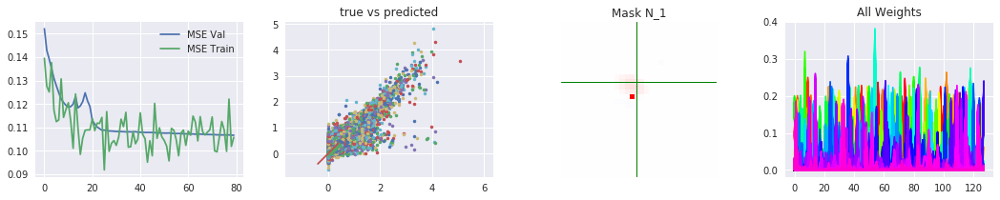

Total FEV =  0.872248660974
Runs: 8100; MSE - train: 0.112603, val: 0.106611597021; lr = 0.0001
best run:  7900 0.106607644969
Loss/Regularization: 0.00644447011291 MSE, 0.0 kernel, 0.00302105426788 mask, 0.00247540190816 weights


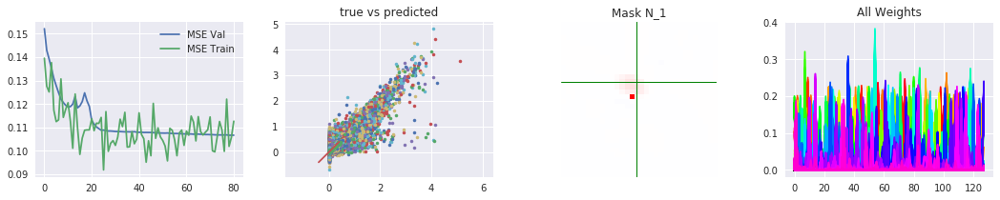

Total FEV =  0.873108257309
Runs: 8200; MSE - train: 0.100054, val: 0.106565053665; lr = 0.0001
best run:  8200 0.106565053665
Loss/Regularization: 0.00640110741369 MSE, 0.0 kernel, 0.00301638865471 mask, 0.00246807515621 weights


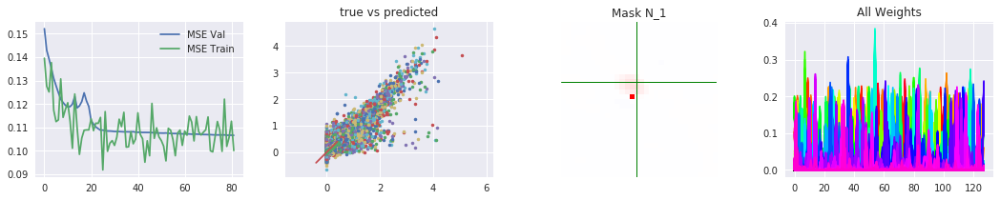

Total FEV =  0.87450318484
Runs: 8300; MSE - train: 0.0952524, val: 0.106498655953; lr = 0.0001
best run:  8300 0.106498655953
Loss/Regularization: 0.00633073970675 MSE, 0.0 kernel, 0.0030123064518 mask, 0.00245674714446 weights


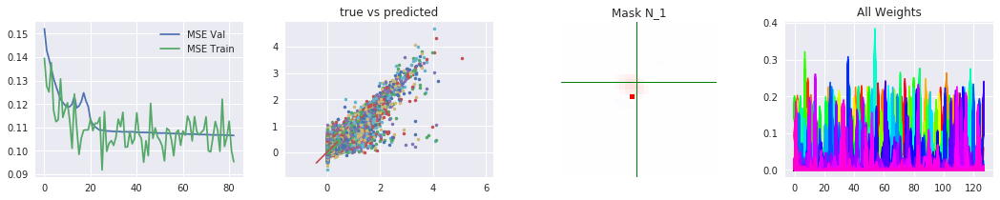

Total FEV =  0.875070504886
Runs: 8400; MSE - train: 0.110571, val: 0.106464469505; lr = 0.0001
best run:  8400 0.106464469505
Loss/Regularization: 0.00630212100805 MSE, 0.0 kernel, 0.00300603032112 mask, 0.00246258109808 weights


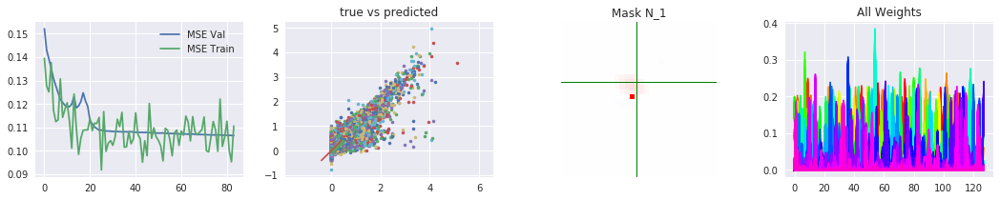

Total FEV =  0.872268891847
Runs: 8500; MSE - train: 0.110526, val: 0.106601511098; lr = 0.0001
best run:  8400 0.106464469505
Loss/Regularization: 0.00644344955799 MSE, 0.0 kernel, 0.0029990978241 mask, 0.00247143954039 weights


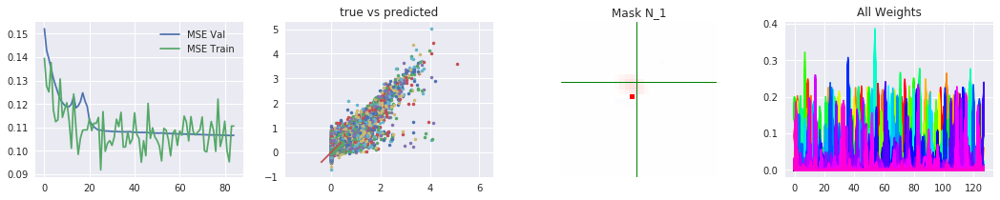

Total FEV =  0.875491885831
Runs: 8600; MSE - train: 0.104951, val: 0.106444876821; lr = 0.0001
best run:  8600 0.106444876821
Loss/Regularization: 0.00628086426877 MSE, 0.0 kernel, 0.00299968194962 mask, 0.00246250197291 weights


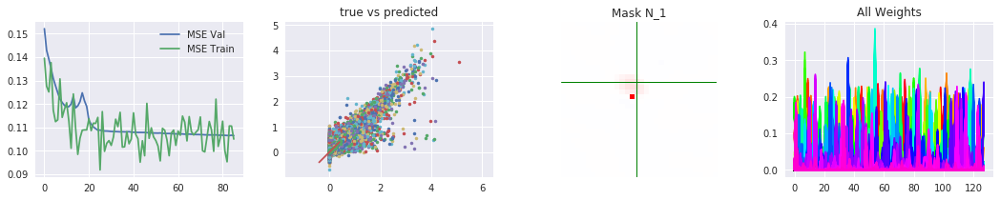

Total FEV =  0.875434320787
Runs: 8700; MSE - train: 0.106928, val: 0.10644790392; lr = 0.0001
best run:  8600 0.106444876821
Loss/Regularization: 0.00628376816167 MSE, 0.0 kernel, 0.00300867605209 mask, 0.00245537206531 weights


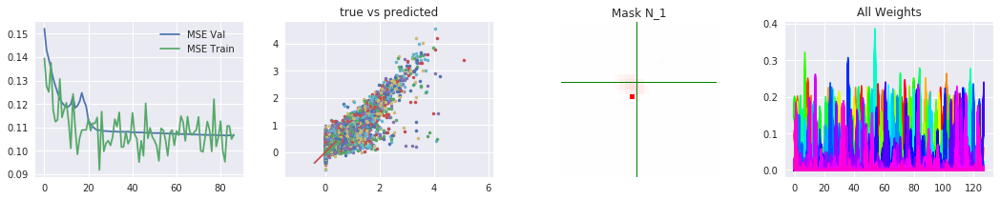

Total FEV =  0.875288465342
Runs: 8800; MSE - train: 0.101704, val: 0.106452627889; lr = 0.0001
best run:  8600 0.106444876821
Loss/Regularization: 0.00629112590104 MSE, 0.0 kernel, 0.00301633930206 mask, 0.0024562112987 weights


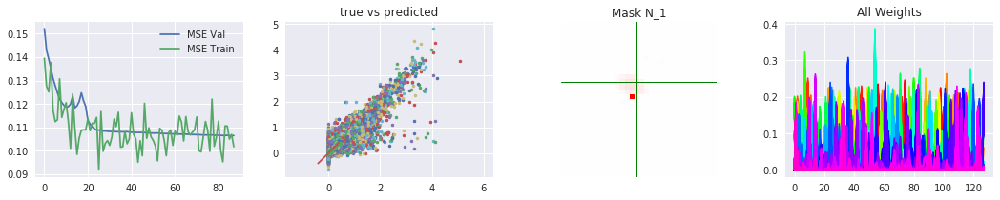

Total FEV =  0.877101214694
Runs: 8900; MSE - train: 0.109106, val: 0.10635857969; lr = 0.0001
best run:  8900 0.10635857969
Loss/Regularization: 0.00619968099636 MSE, 0.0 kernel, 0.00301066017151 mask, 0.00244353637099 weights


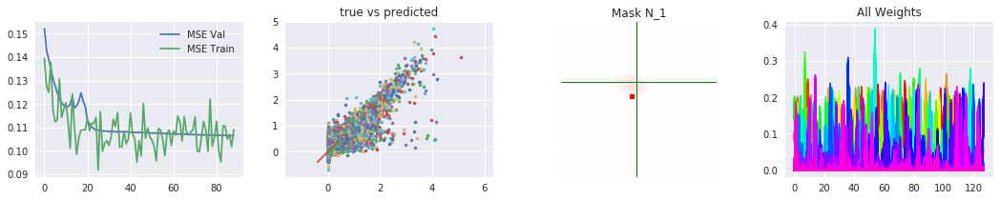

Total FEV =  0.875675632191
Runs: 9000; MSE - train: 0.103725, val: 0.106441161505; lr = 0.0001
best run:  8900 0.10635857969
Loss/Regularization: 0.00627159510623 MSE, 0.0 kernel, 0.0030079305172 mask, 0.00243952274323 weights


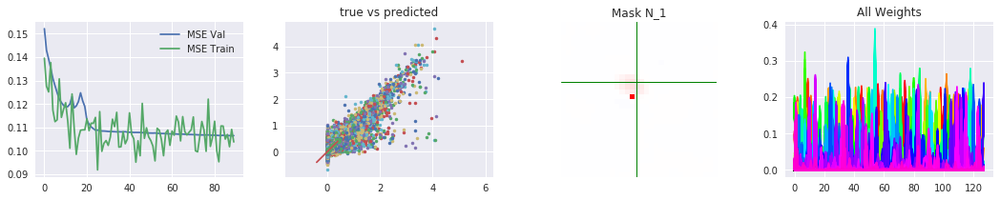

Total FEV =  0.87783594109
Runs: 9100; MSE - train: 0.0987521, val: 0.106320757599; lr = 0.0001
best run:  9100 0.106320757599
Loss/Regularization: 0.00616261741379 MSE, 0.0 kernel, 0.00299920654297 mask, 0.00244509726763 weights


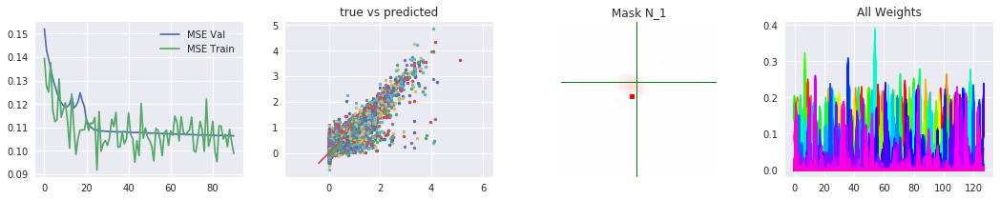

Total FEV =  0.873429801612
Runs: 9200; MSE - train: 0.116336, val: 0.106542494208; lr = 0.0001
best run:  9100 0.106320757599
Loss/Regularization: 0.00638488697587 MSE, 0.0 kernel, 0.00298963093758 mask, 0.00246042519808 weights


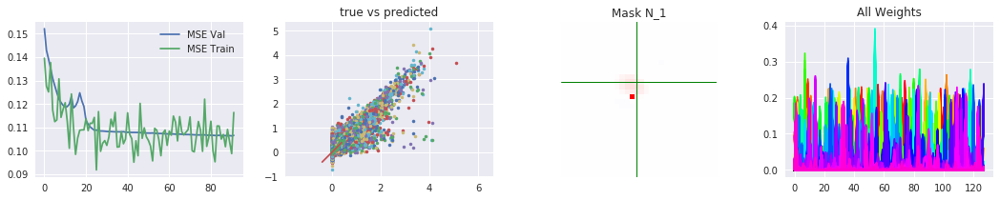

Total FEV =  0.878025868176
Runs: 9300; MSE - train: 0.116615, val: 0.106317252822; lr = 0.0001
best run:  9300 0.106317252822
Loss/Regularization: 0.00615303646191 MSE, 0.0 kernel, 0.00299578928947 mask, 0.00244042932987 weights


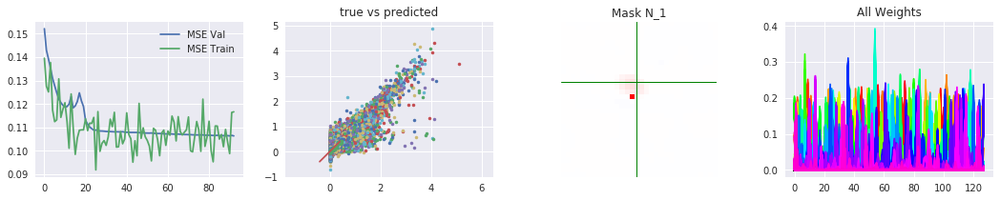

Total FEV =  0.878891877166
Runs: 9400; MSE - train: 0.105368, val: 0.106258491174; lr = 0.0001
best run:  9400 0.106258491174
Loss/Regularization: 0.00610935027362 MSE, 0.0 kernel, 0.00299585008621 mask, 0.00243803322315 weights


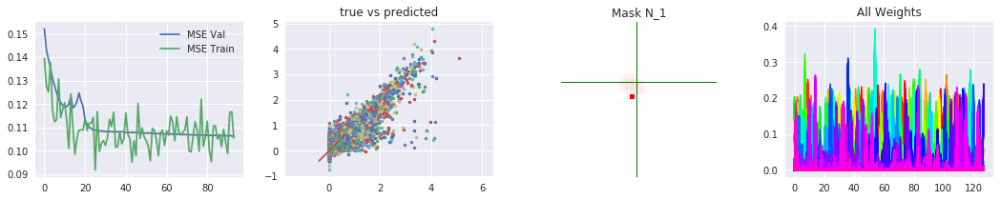

Total FEV =  0.879231140936
Runs: 9500; MSE - train: 0.0935753, val: 0.106248521336; lr = 0.0001
best run:  9500 0.106248521336
Loss/Regularization: 0.00609223596985 MSE, 0.0 kernel, 0.00299067282677 mask, 0.00243768259883 weights


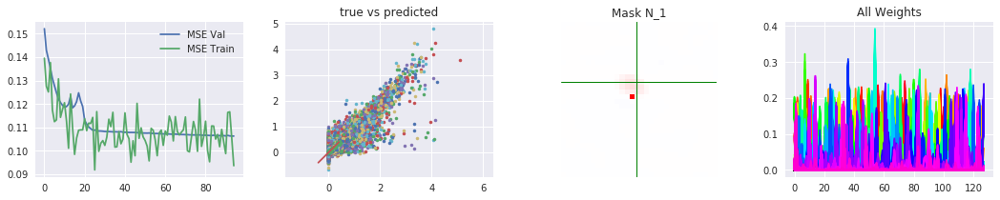

Total FEV =  0.878945778083
Runs: 9600; MSE - train: 0.102476, val: 0.106261426042; lr = 0.0001
best run:  9500 0.106248521336
Loss/Regularization: 0.00610663121915 MSE, 0.0 kernel, 0.00300634741783 mask, 0.00243794709444 weights


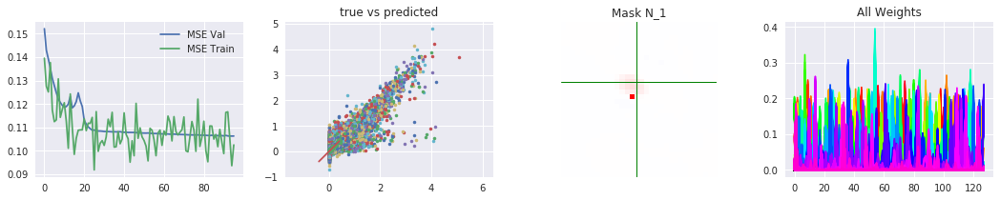

Total FEV =  0.879093971854
Runs: 9700; MSE - train: 0.100248, val: 0.106259219649; lr = 0.0001
best run:  9500 0.106248521336
Loss/Regularization: 0.00609915552195 MSE, 0.0 kernel, 0.00300436925888 mask, 0.00243798911572 weights


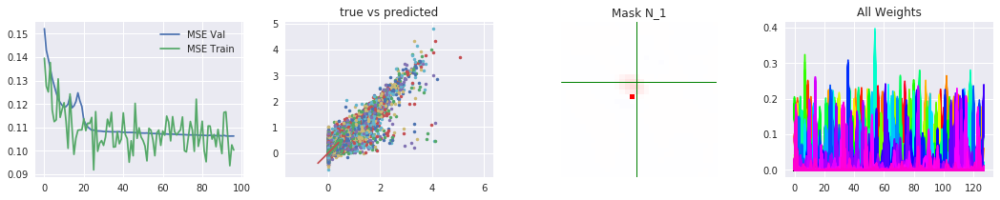

Total FEV =  0.878779565992
Runs: 9800; MSE - train: 0.107001, val: 0.106274132046; lr = 0.0001
best run:  9500 0.106248521336
Loss/Regularization: 0.00611501585809 MSE, 0.0 kernel, 0.00300059080124 mask, 0.00243252828717 weights


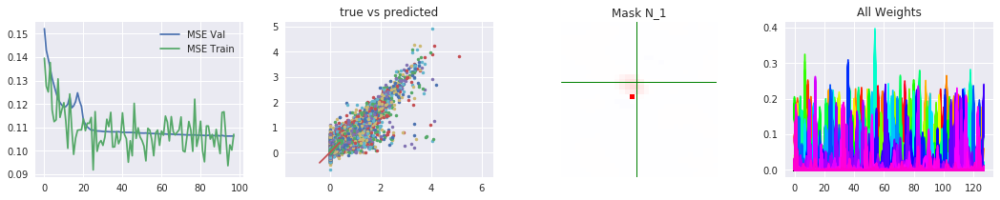

Total FEV =  0.879290110244
Runs: 9900; MSE - train: 0.107603, val: 0.106248448212; lr = 0.0001
best run:  9900 0.106248448212
Loss/Regularization: 0.00608926123823 MSE, 0.0 kernel, 0.00299122190475 mask, 0.00243048965931 weights


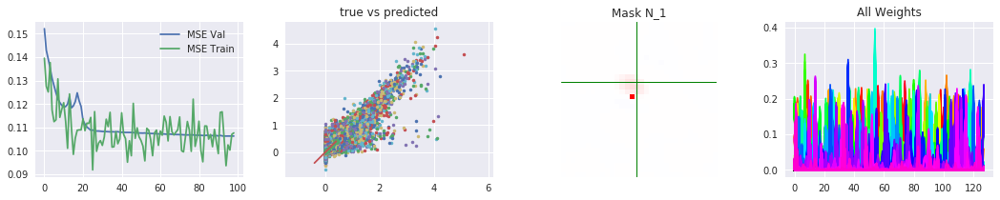

('Stop at run 9999; MSE on validation set: 0.106248448212', 'MSE on test set: 0.00608926124412; Mean FEV: 0.872358026243')
.r mean values of weights:  [ 0.    0.    0.01  0.    0.    0.    0.    0.    0.01  0.01  0.    0.01
  0.    0.    0.    0.    0.    0.    0.    0.    0.    0.    0.    0.01
  0.    0.    0.    0.    0.    0.    0.01  0.    0.    0.    0.    0.    0.
  0.    0.    0.    0.01  0.01  0.    0.    0.    0.01  0.    0.    0.
  0.01  0.    0.    0.    0.01  0.    0.    0.01  0.    0.    0.01  0.    0.
  0.    0.    0.    0.    0.    0.    0.    0.    0.    0.    0.01  0.
  0.01  0.    0.    0.    0.    0.    0.    0.    0.    0.    0.    0.    0.
  0.    0.01  0.    0.    0.    0.    0.    0.    0.    0.    0.01  0.01
  0.    0.01  0.    0.    0.    0.    0.01  0.    0.01  0.    0.    0.01
  0.    0.    0.    0.    0.    0.    0.    0.    0.    0.    0.    0.    0.
  0.    0.01  0.    0.  ]
.b mean values of weights:  [ 0.01  0.    0.    0.    0.01  0.    0.    0.01  0. 

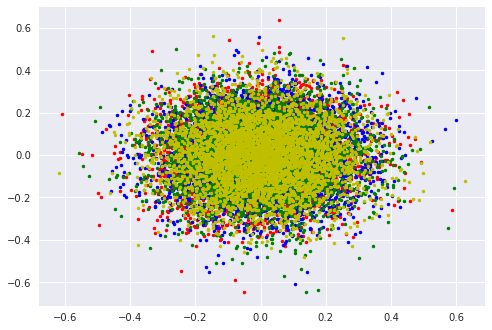

run took 6421.958005905151 s to optimize


Text(0,0.5,'FEV')

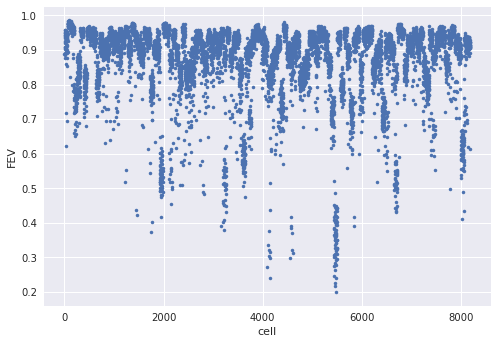

In [13]:
#All Types: 128 different types à 64 neurons

start = time.time()
#Seeds
np_seed=1248
np.random.seed(np_seed)
tf_seed=1729

#'''
#Data, keep test set for later
num_test = 2**10
ind = np.random.choice(X.shape[0],X.shape[0],replace=False)
X_TEST = X[ind[:num_test],...]
GT_TEST = (Y[:,ind[:num_test]].T / np.mean(Y,1)).T * .1#mean response=.1
X_try = X[ind[num_test:],...]
Y_try = Y[:,ind[num_test:]]

#Data
split_data=True#set true for large nets to fit on GPU memory
batch_size = 64
D=min(2**16,Y_try.shape[1])-num_test#number of training+val images
num_val = D//8
num_train = D-num_val

Y_train,Y_val,X_train,X_val,X_test,GT_test = splitting_data(X=X_try,Y=Y_try,
   num_train=num_train,num_test=num_test,num_val=num_val,noise=True,mean_response=.1)

print('Images for Training: %s, Validation: %s, Testing %s'%(
      Y_train.shape[1],Y_val.shape[1],GT_test.shape[1]))

#Neurons
N=2**13
#ind = np.random.choice(250,N//4,replace=False)
#ind = np.concatenate([ind,ind+250,ind+500,ind+750])
#ind[0]=0
#Y_train=Y_train[ind,:]
#Y_val=Y_val[ind,:]
#GT_test=GT_test[ind,:]

#Ground truth locations
GT_mask = np.hstack([loc_y.reshape([-1,1]),loc_x.reshape([-1,1])])#[ind,:]

#Parameters:
s=[44,3,32]#sizes of [image(heigth=width), image(depth=channel), mask]
sk=[5,5,5]#width=heigth of receptive field and conv kernel
num_kern = [32,64,128]#number of bases (conv kernels) to learn per layer
#N=Y_train.shape[0]#neurons
init_scales = np.array([[0,.01],[1,.001],[1/num_kern[-1],.01]])#Mean/SD for Kernel,Mask,Weights
lr= .001 # initial learning rate
reg = np.array([0,.6,.12]) * N/1000
#[0,.0000464,.00000278]#regularization parameters: L2 Kernels, L1 Mask, L1 Weights
max_runs = 10000 # training steps
act_fn=['relu','relu','relu']#activation function per layer in model
kernel_constraint=None
weights_constraint='abs'#'norm'#None#constrain read out weights to norm=1
stop_crit = [5,3]#[after how many worse steps lower lr, lower how many times]
burn_in=10#allow for burn_in*100 initial runs without triggering stop criterion
bn_cent=True#center after batch norm

#calculate spike triggered average to initialize location masks
X_sta=np.mean(X_train,axis=1).reshape([-1,s[0]**2]).T
sta,_=pre_process.STA(X_sta,Y_train,s[-1],np.int(s[-1]/2))
#'''
reg = [0,.001,.01,0]
print('it took %s s to preprocess data'%(time.time()-start))

#for rep in range(5):
#Train Model

#for i in range(2,10):
start = time.time()
(WK,WM,WW,MSE_train,MSE_val,MSE_test,FEV,FEV_cell,Y_,
log) = training.train(s=s,#        sizes of [image(heigth=width), image(depth=channel), mask]
          sK=sk,#        s - sizes of [kernel1, kernel2, ...] - length of list gives number of layers
          act_fn=act_fn,#      activation functions for each kernel = 'ID' or 'relu'
          init_scales=init_scales,# rows: kernel,mask,weights; columns: mean, sd
          init_lr=lr,# initial learning rate, goes down later
          num_kern=num_kern,#        num_kern - number of kernels per conv layer
          max_runs=max_runs,# maximum number of training steps
          reg=reg,#        regularization weights [Kernel,Mask,Weights]
          batch_size=batch_size,# (max gpu memory?)256 for small one layer, 64 for large multilayer model
          X_train=X_train,
          X_val=X_val,
          X_test=X_test,
          Y_train=Y_train,
          Y_val=Y_val,
          GT_test=GT_test,#Data, X in NCHW format, Y: Neurons x Data
          kernel_constraint=kernel_constraint,#constraint for kernel weights - 'norm' == 1
          weights_constraint=weights_constraint,#constraint on read out weights - 'abs','norm','absnorm'
          mask_constraint=None,#constraint on mask - 'abs'
          final_relu=False,
          stop_crit=stop_crit,#[after how many worse steps lower lr, lower how many times]
          burn_in=burn_in,#allow initial exploration of 100*burn_in runs 
          types=list(np.arange(0,2**13,64)),#starting indices of types, default=all same type
          GT_mask=GT_mask,#true locations if known: rows:neurons, columns: x,y location
          tf_seed=tf_seed,#random seed for tensorflow
          np_seed=np_seed,
          split_data=split_data,#whether to go through test and val set in batch_size chunks
          sta=sta,#if provided, take maximum absolute pixel of sta to initialize mask
          bn_cent=bn_cent,#center after batch norm?
          verbose='yes')#stats every 100 steps (takes much longer), 'yes','no','minimal'

#plotting
c = ['.r','.b','.g','.y']
for i in range(4):
    print(c[i],'mean values of weights: ',np.around(np.mean(WW[:,i*(N//4):(i+1)*(N//4)],1),2))
    plt.plot(WW[0,i*(N//4):(i+1)*(N//4)]+np.random.normal(0,.15,(N//4)),
                WW[1,i*(N//4):(i+1)*(N//4)]+np.random.normal(0,.15,(N//4)),c[i])
    plt.plot(-WW[2,i*(N//4):(i+1)*(N//4)]+np.random.normal(0,.15,(N//4)),
                -WW[3,i*(N//4):(i+1)*(N//4)]+np.random.normal(0,.15,(N//4)),c[i])
plt.show()

print('run took %s s to optimize'%(time.time()-start))
#Plot Model performance on individual cells
plt.plot(FEV_cell,'.')
plt.xlabel('cell')
plt.ylabel('FEV')

# Some Grid search

Images for Training: 55552, Validation: 7936, Testing 1024
it took 131.00513863563538 s to preprocess data
Before Training:
Total FEV =  -0.251816132407
Loss/Regularization: 0.0631483921316 MSE, 0.0 kernel, 0.000544841909409 mask, 0.0395787155628 weights


/usr/local/lib/python3.4/dist-packages/matplotlib/font_manager.py:1313: UserWarning: findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))


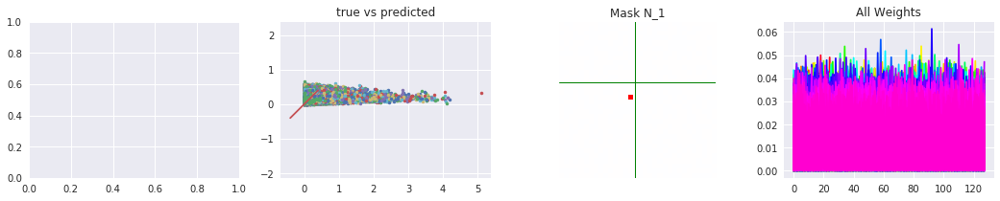

Total FEV =  0.00898335470888
Runs: 100; MSE - train: 0.140293, val: 0.151259299969; lr = 0.001
best run:  100 0.151259299969
Loss/Regularization: 0.0499922521412 MSE, 0.0 kernel, 0.000597993707657 mask, 0.00575295388699 weights


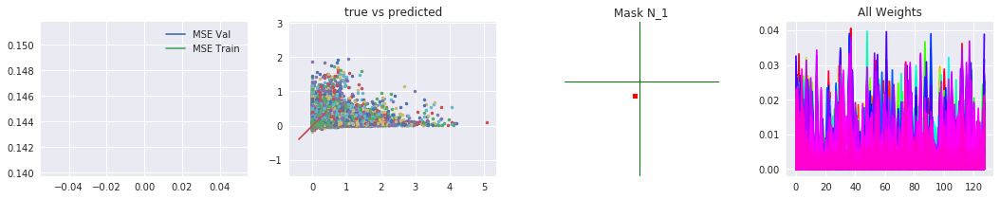

Total FEV =  0.139455480784
Runs: 200; MSE - train: 0.129614, val: 0.144508896996; lr = 0.001
best run:  200 0.144508896996
Loss/Regularization: 0.0434105307795 MSE, 0.0 kernel, 0.000753595089912 mask, 0.00692601621151 weights


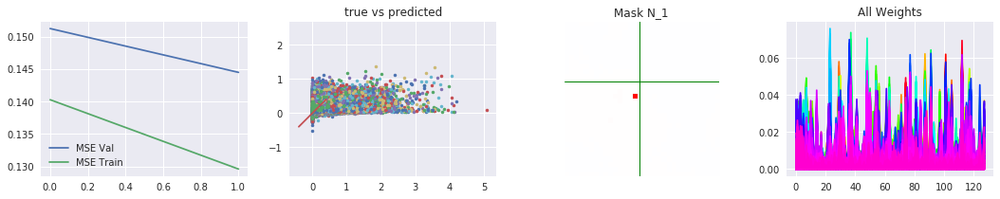

Total FEV =  0.229401202058
Runs: 300; MSE - train: 0.126092, val: 0.139849371908; lr = 0.001
best run:  300 0.139849371908
Loss/Regularization: 0.0388731809799 MSE, 0.0 kernel, 0.000947950100899 mask, 0.00769844591618 weights


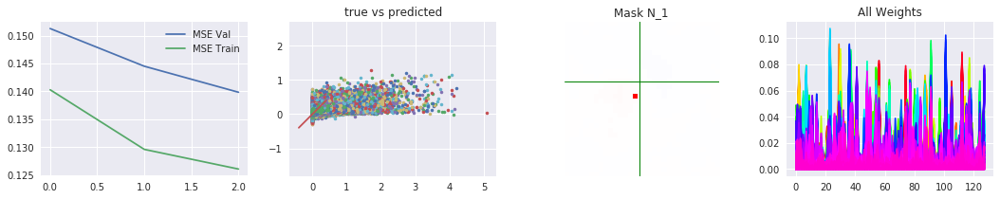

Total FEV =  0.30318629231
Runs: 400; MSE - train: 0.138739, val: 0.136030882717; lr = 0.001
best run:  400 0.136030882717
Loss/Regularization: 0.0351510610199 MSE, 0.0 kernel, 0.00111614842415 mask, 0.00806894928217 weights


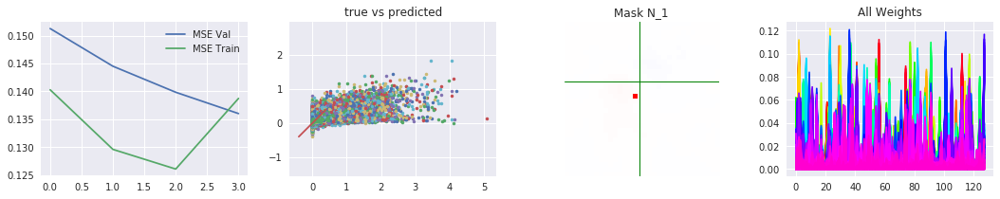

Total FEV =  0.376617475554
Runs: 500; MSE - train: 0.117896, val: 0.132202038361; lr = 0.001
best run:  500 0.132202038361
Loss/Regularization: 0.031446794048 MSE, 0.0 kernel, 0.00125832338333 mask, 0.00826912343502 weights


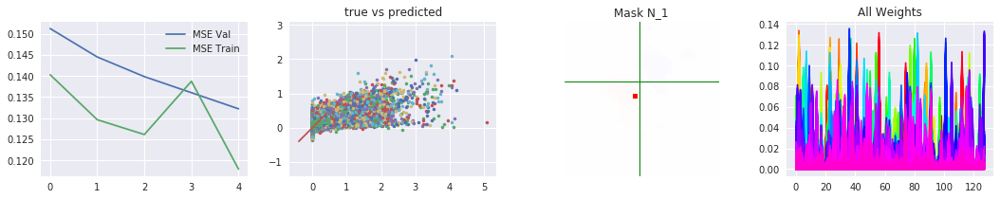

Total FEV =  0.441082305352
Runs: 600; MSE - train: 0.11263, val: 0.128842877525; lr = 0.001
best run:  600 0.128842877525
Loss/Regularization: 0.0281948385527 MSE, 0.0 kernel, 0.0013745654583 mask, 0.0084429359436 weights


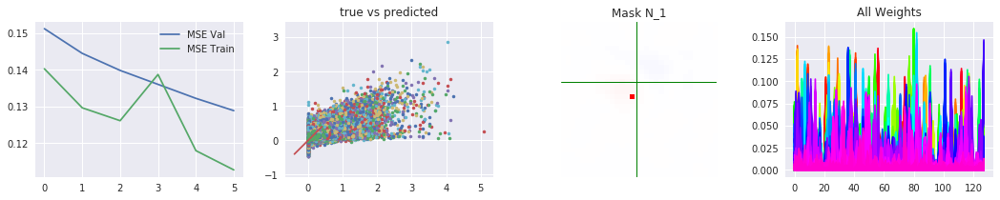

Total FEV =  0.498392398528
Runs: 700; MSE - train: 0.113236, val: 0.12579672381; lr = 0.001
best run:  700 0.12579672381
Loss/Regularization: 0.0253038067603 MSE, 0.0 kernel, 0.00147590374947 mask, 0.00858353197575 weights


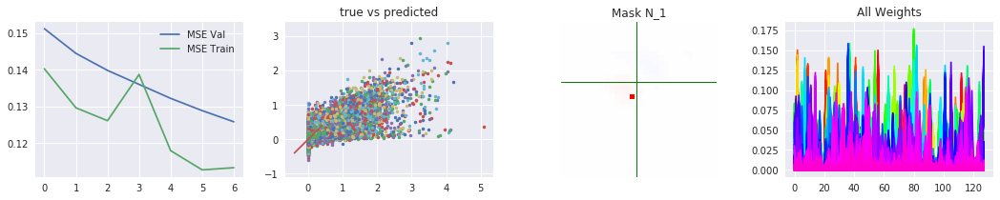

Total FEV =  0.555186495398
Runs: 800; MSE - train: 0.130786, val: 0.122822167051; lr = 0.001
best run:  800 0.122822167051
Loss/Regularization: 0.022438804619 MSE, 0.0 kernel, 0.00156779351234 mask, 0.00880942672491 weights


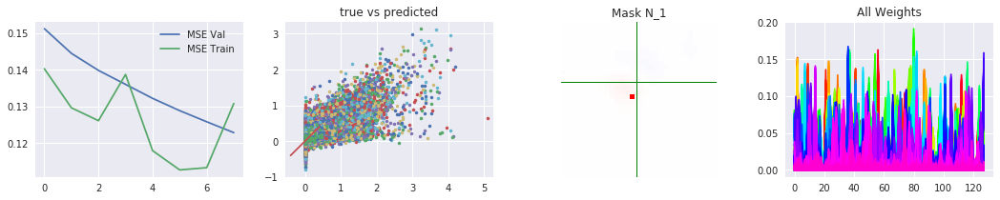

Total FEV =  0.587742923891
Runs: 900; MSE - train: 0.113973, val: 0.121153198183; lr = 0.001
best run:  900 0.121153198183
Loss/Regularization: 0.0207964818692 MSE, 0.0 kernel, 0.00164456892014 mask, 0.00874907881021 weights


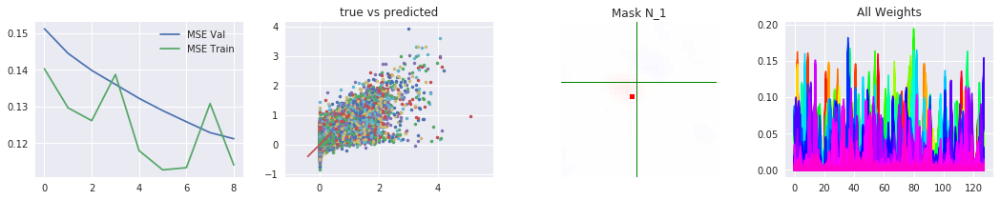

Total FEV =  0.615590290975
Runs: 1000; MSE - train: 0.117651, val: 0.119702652938; lr = 0.001
best run:  1000 0.119702652938
Loss/Regularization: 0.0193917097058 MSE, 0.0 kernel, 0.0017281537056 mask, 0.00879375189543 weights


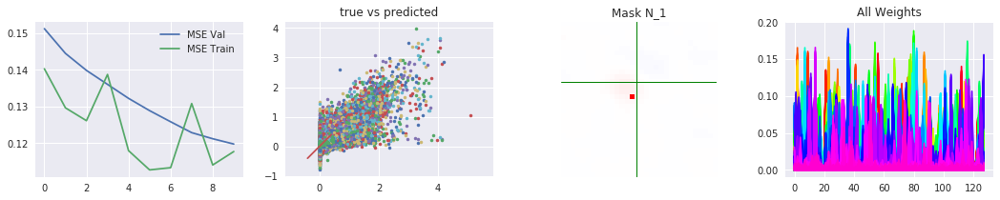

Total FEV =  0.633917396622
Runs: 1100; MSE - train: 0.120213, val: 0.118782262889; lr = 0.001
best run:  1100 0.118782262889
Loss/Regularization: 0.0184671911411 MSE, 0.0 kernel, 0.00178442602158 mask, 0.0088622367382 weights


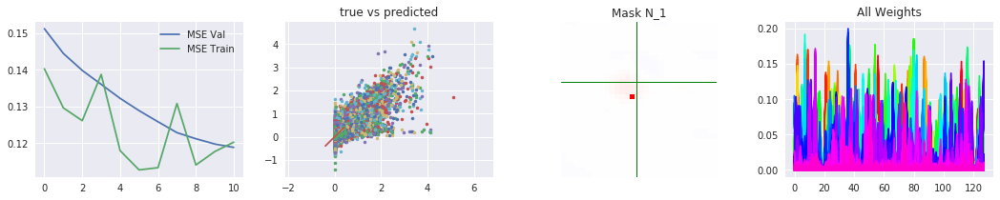

Total FEV =  0.642060922506
Runs: 1200; MSE - train: 0.112184, val: 0.118392098935; lr = 0.001
best run:  1200 0.118392098935
Loss/Regularization: 0.0180563875474 MSE, 0.0 kernel, 0.00182073125839 mask, 0.008782992661 weights


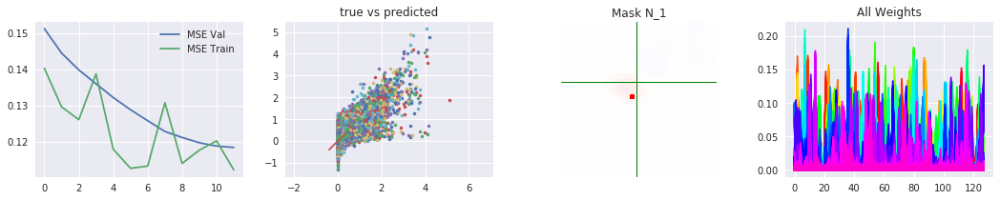

Total FEV =  0.61895076674
Runs: 1300; MSE - train: 0.100803, val: 0.119606396003; lr = 0.001
best run:  1200 0.118392098935
Loss/Regularization: 0.0192221890902 MSE, 0.0 kernel, 0.00185160398483 mask, 0.00892768085003 weights


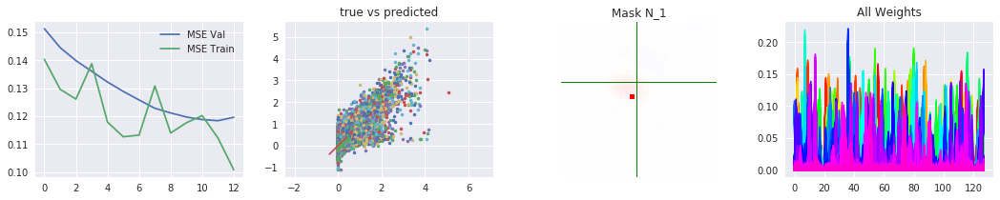

Total FEV =  0.599259636616
Runs: 1400; MSE - train: 0.123926, val: 0.120582782453; lr = 0.001
best run:  1200 0.118392098935
Loss/Regularization: 0.0202155164443 MSE, 0.0 kernel, 0.0018737224102 mask, 0.00872544497252 weights


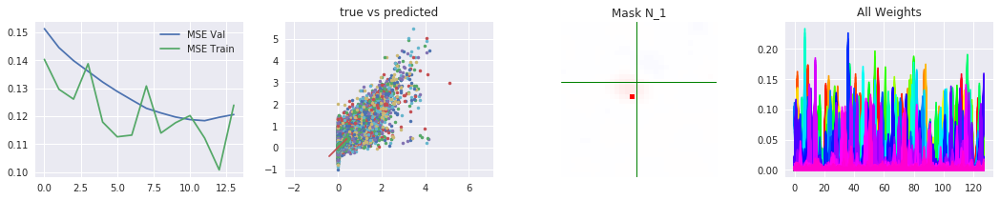

Total FEV =  0.663673127098
Runs: 1500; MSE - train: 0.109851, val: 0.117342991274; lr = 0.001
best run:  1500 0.117342991274
Loss/Regularization: 0.0169661507825 MSE, 0.0 kernel, 0.00189864993095 mask, 0.00866530895233 weights


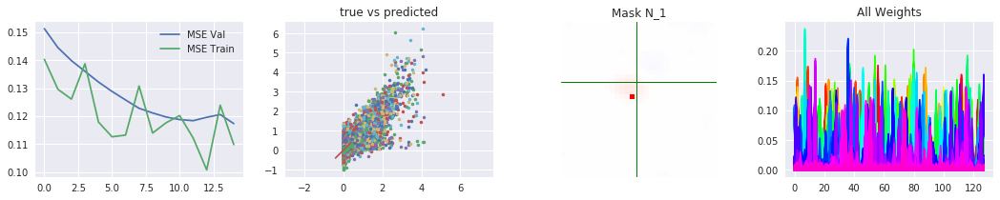

Total FEV =  0.664794415713
Runs: 1600; MSE - train: 0.0981034, val: 0.117266761259; lr = 0.001
best run:  1600 0.117266761259
Loss/Regularization: 0.016909586906 MSE, 0.0 kernel, 0.00192273287773 mask, 0.00858754277229 weights


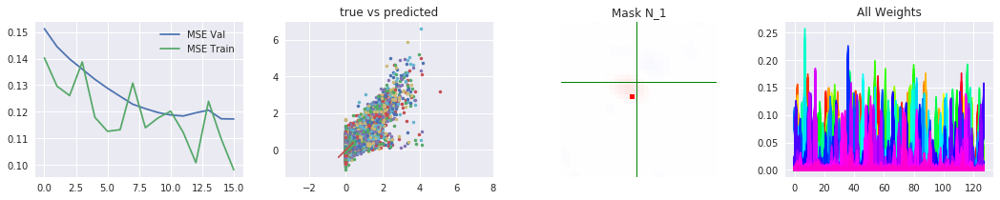

Total FEV =  0.614417638811
Runs: 1700; MSE - train: 0.105335, val: 0.119830142286; lr = 0.001
best run:  1600 0.117266761259
Loss/Regularization: 0.0194508646382 MSE, 0.0 kernel, 0.00194658093452 mask, 0.00873416662216 weights


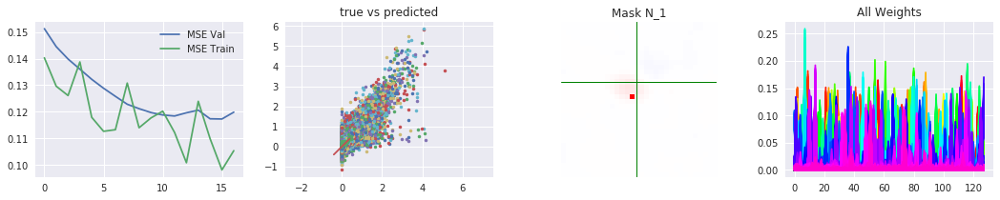

Total FEV =  0.575399901212
Runs: 1800; MSE - train: 0.108553, val: 0.121876506976; lr = 0.001
best run:  1600 0.117266761259
Loss/Regularization: 0.0214191308478 MSE, 0.0 kernel, 0.00201244153976 mask, 0.00876236379147 weights


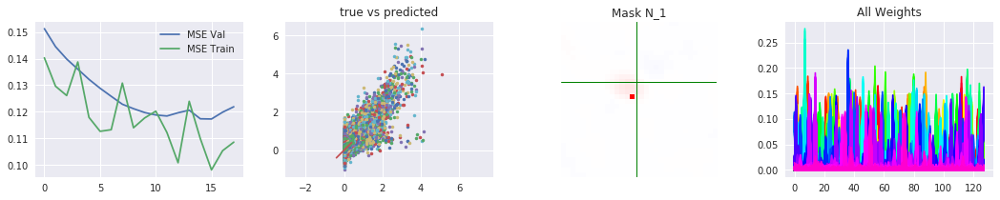

Total FEV =  0.638377754332
Runs: 1900; MSE - train: 0.108649, val: 0.118603756111; lr = 0.001
best run:  1600 0.117266761259
Loss/Regularization: 0.0182421865175 MSE, 0.0 kernel, 0.0020461874485 mask, 0.00860684841871 weights


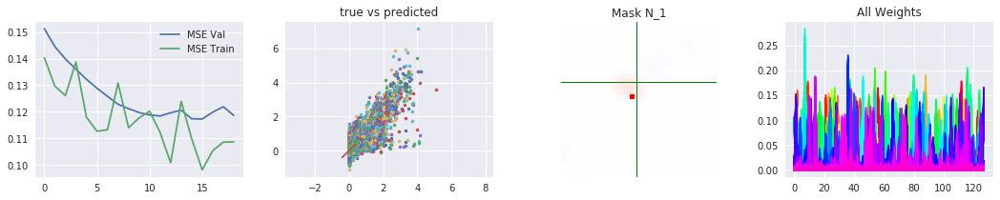

Total FEV =  0.659930245944
Runs: 2000; MSE - train: 0.108733, val: 0.11751466641; lr = 0.001
best run:  1600 0.117266761259
Loss/Regularization: 0.017154961999 MSE, 0.0 kernel, 0.00205647525787 mask, 0.00850331246853 weights


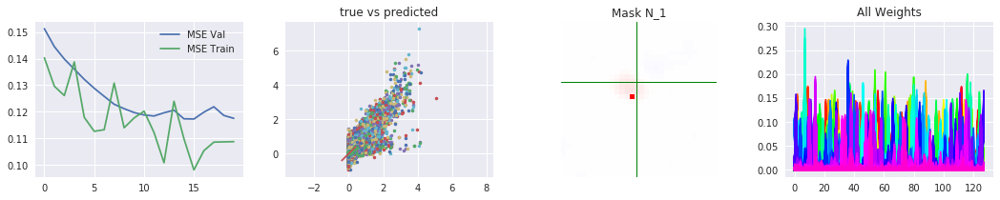

Total FEV =  0.648517087642
Runs: 2100; MSE - train: 0.114624, val: 0.118154778175; lr = 0.001
best run:  1600 0.117266761259
Loss/Regularization: 0.0177307035774 MSE, 0.0 kernel, 0.00207089524269 mask, 0.0085259771347 weights


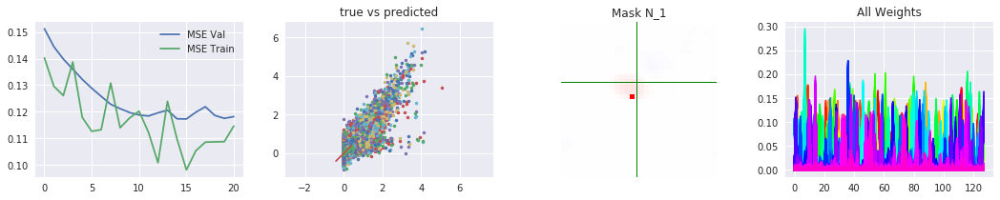

Total FEV =  0.74869069398
Runs: 2200; MSE - train: 0.109001, val: 0.112949515002; lr = 0.0001
best run:  2200 0.112949515002
Loss/Regularization: 0.0126774038072 MSE, 0.0 kernel, 0.00198246889114 mask, 0.00576154768467 weights


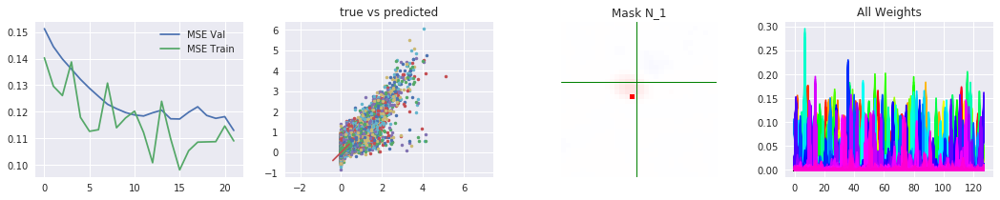

Total FEV =  0.7824870478
Runs: 2300; MSE - train: 0.111953, val: 0.111217178945; lr = 0.0001
best run:  2300 0.111217178945
Loss/Regularization: 0.0109725325019 MSE, 0.0 kernel, 0.00191804265976 mask, 0.00521028891206 weights


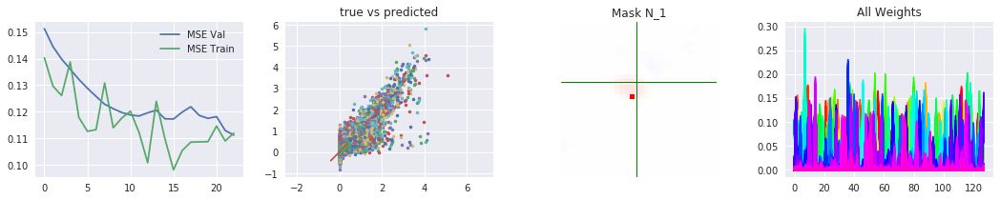

Total FEV =  0.803586351929
Runs: 2400; MSE - train: 0.111758, val: 0.11014625376; lr = 0.0001
best run:  2400 0.11014625376
Loss/Regularization: 0.00990816921694 MSE, 0.0 kernel, 0.00186409535408 mask, 0.00504598215222 weights


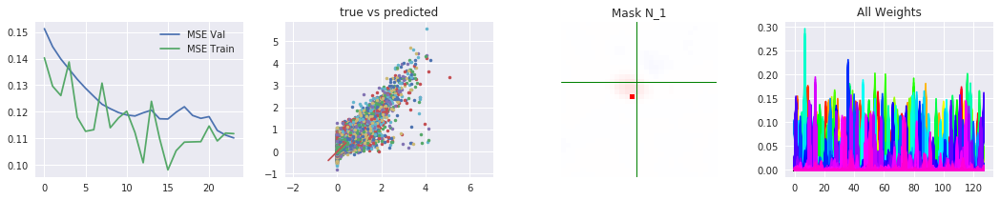

Total FEV =  0.825678377146
Runs: 2500; MSE - train: 0.114191, val: 0.109005599914; lr = 0.0001
best run:  2500 0.109005599914
Loss/Regularization: 0.0087937276985 MSE, 0.0 kernel, 0.00181643271446 mask, 0.00492844104767 weights


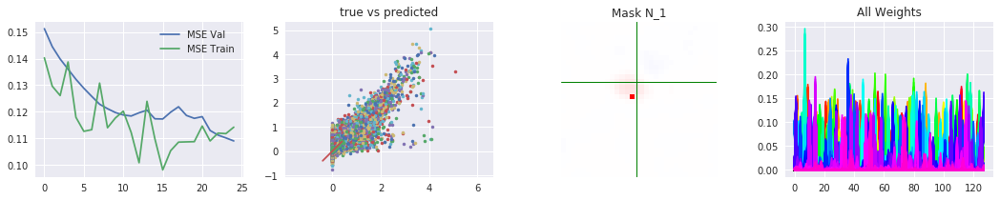

Total FEV =  0.827634652272
Runs: 2600; MSE - train: 0.0916001, val: 0.108906071994; lr = 0.0001
best run:  2600 0.108906071994
Loss/Regularization: 0.00869504257571 MSE, 0.0 kernel, 0.00177583022118 mask, 0.00491404607892 weights


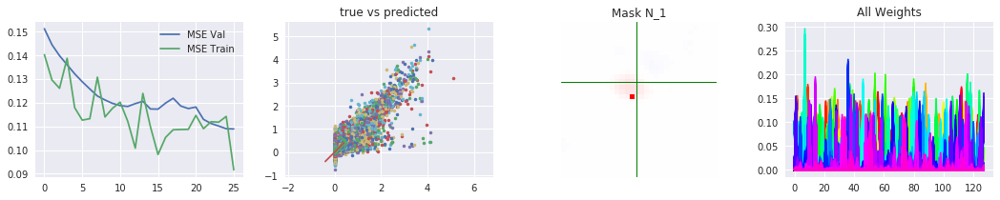

Total FEV =  0.833487944196
Runs: 2700; MSE - train: 0.116499, val: 0.108602385968; lr = 0.0001
best run:  2700 0.108602385968
Loss/Regularization: 0.00839977079886 MSE, 0.0 kernel, 0.00175620546341 mask, 0.0048821438849 weights


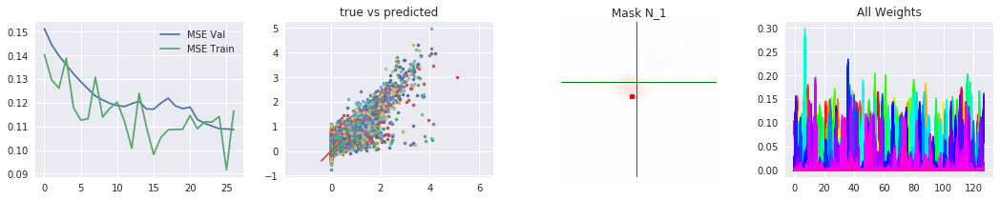

Total FEV =  0.837264603281
Runs: 2800; MSE - train: 0.0993656, val: 0.108421281461; lr = 0.0001
best run:  2800 0.108421281461
Loss/Regularization: 0.00820925564039 MSE, 0.0 kernel, 0.0017361638546 mask, 0.00484041631222 weights


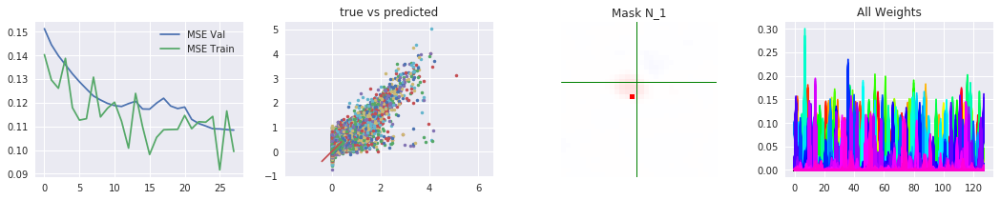

Total FEV =  0.838217470714
Runs: 2900; MSE - train: 0.102875, val: 0.108368429806; lr = 0.0001
best run:  2900 0.108368429806
Loss/Regularization: 0.00816118784132 MSE, 0.0 kernel, 0.00171855854988 mask, 0.00484456881881 weights


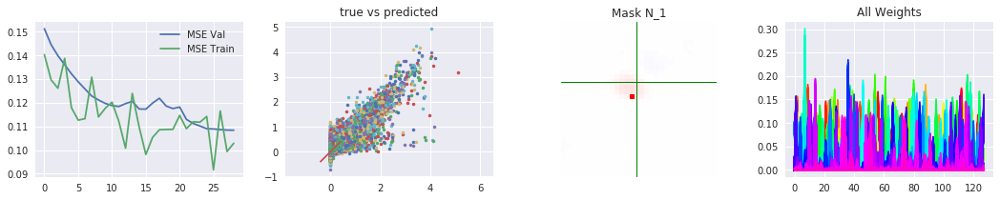

Total FEV =  0.840189023709
Runs: 3000; MSE - train: 0.104022, val: 0.108264657398; lr = 0.0001
best run:  3000 0.108264657398
Loss/Regularization: 0.00806173202 MSE, 0.0 kernel, 0.00170096955299 mask, 0.00481685131788 weights


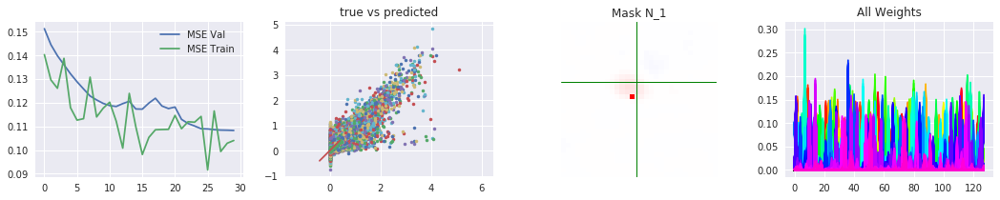

Total FEV =  0.842081989805
Runs: 3100; MSE - train: 0.101834, val: 0.108168291168; lr = 0.0001
best run:  3100 0.108168291168
Loss/Regularization: 0.00796624054783 MSE, 0.0 kernel, 0.00168494052887 mask, 0.00481023073196 weights


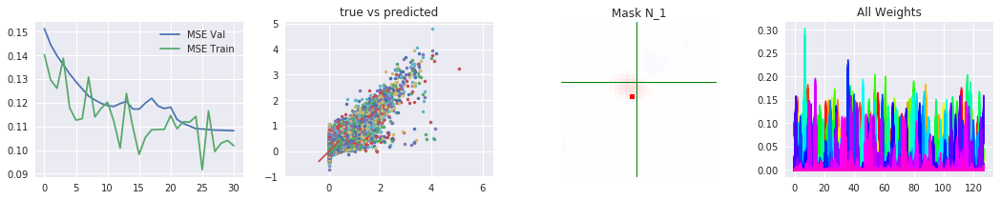

Total FEV =  0.843573716405
Runs: 3200; MSE - train: 0.105727, val: 0.108094535047; lr = 0.0001
best run:  3200 0.108094535047
Loss/Regularization: 0.00789098977111 MSE, 0.0 kernel, 0.00167001013756 mask, 0.00477312326431 weights


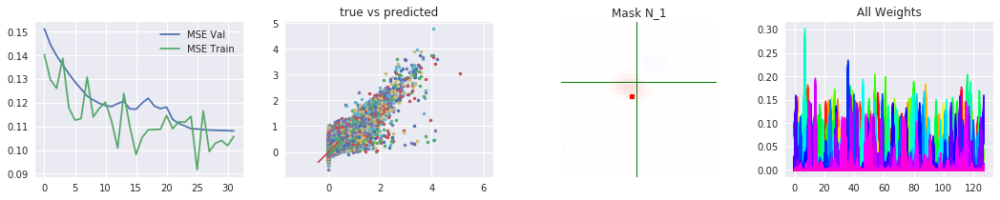

Total FEV =  0.843676269843
Runs: 3300; MSE - train: 0.113305, val: 0.108092418541; lr = 0.0001
best run:  3300 0.108092418541
Loss/Regularization: 0.00788581641973 MSE, 0.0 kernel, 0.00165577411652 mask, 0.00477252110839 weights


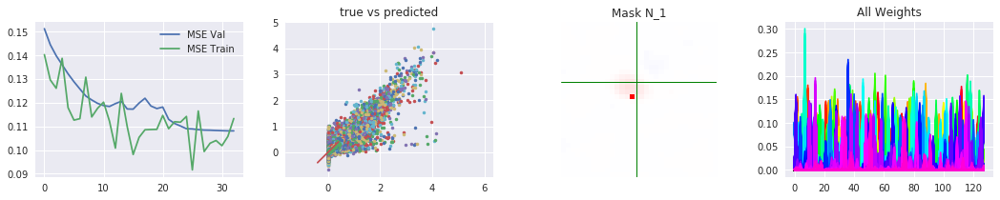

Total FEV =  0.844467297214
Runs: 3400; MSE - train: 0.109856, val: 0.108048524167; lr = 0.0001
best run:  3400 0.108048524167
Loss/Regularization: 0.00784591271076 MSE, 0.0 kernel, 0.00164526329041 mask, 0.0047612978518 weights


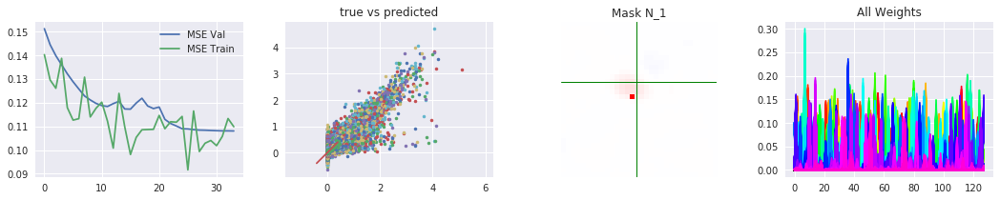

Total FEV =  0.845179718649
Runs: 3500; MSE - train: 0.115827, val: 0.108010143763; lr = 0.0001
best run:  3500 0.108010143763
Loss/Regularization: 0.00780997431139 MSE, 0.0 kernel, 0.00163760147095 mask, 0.00474618852139 weights


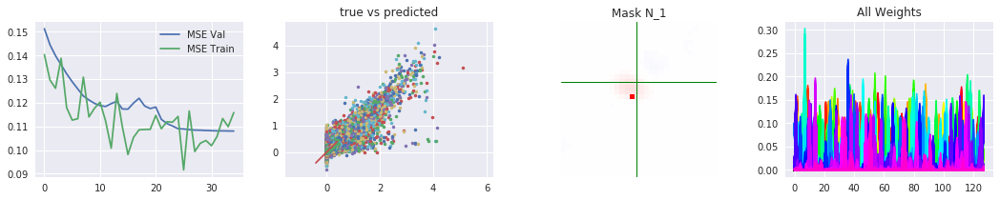

Total FEV =  0.845121185505
Runs: 3600; MSE - train: 0.101267, val: 0.108013702376; lr = 0.0001
best run:  3500 0.108010143763
Loss/Regularization: 0.0078129270405 MSE, 0.0 kernel, 0.00163957028389 mask, 0.00472002267838 weights


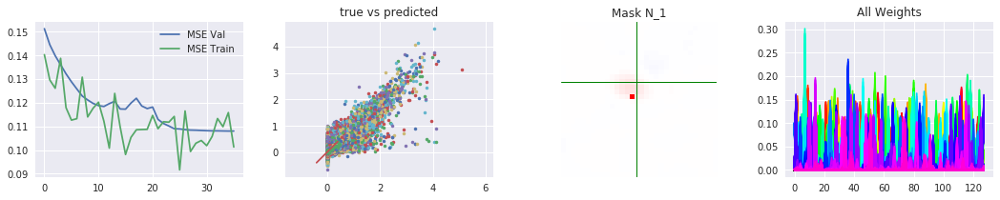

Total FEV =  0.845026225135
Runs: 3700; MSE - train: 0.101345, val: 0.108013163831; lr = 0.0001
best run:  3500 0.108010143763
Loss/Regularization: 0.00781771735637 MSE, 0.0 kernel, 0.00163513555527 mask, 0.00472321808338 weights


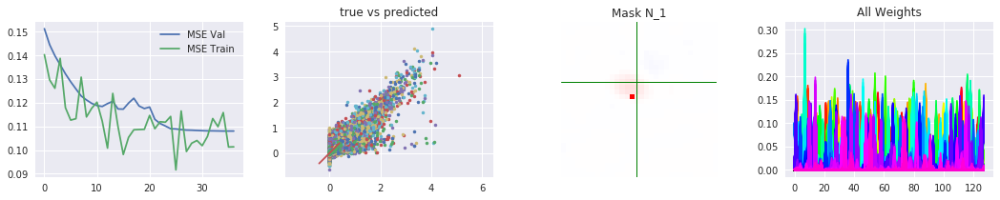

Total FEV =  0.846590560411
Runs: 3800; MSE - train: 0.108024, val: 0.107941644326; lr = 0.0001
best run:  3800 0.107941644326
Loss/Regularization: 0.00773880380439 MSE, 0.0 kernel, 0.0016281961441 mask, 0.00472021132708 weights


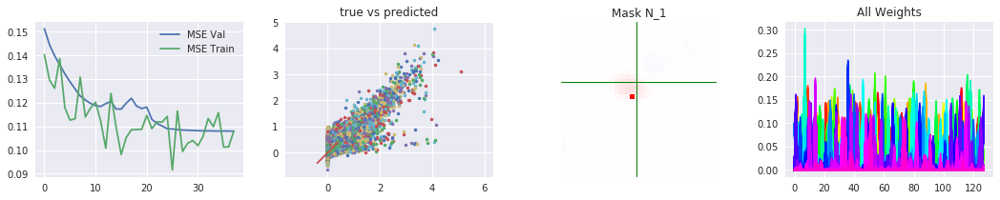

Total FEV =  0.845506494617
Runs: 3900; MSE - train: 0.102816, val: 0.107994667104; lr = 0.0001
best run:  3800 0.107941644326
Loss/Regularization: 0.00779348996002 MSE, 0.0 kernel, 0.00162060928345 mask, 0.00473923668265 weights


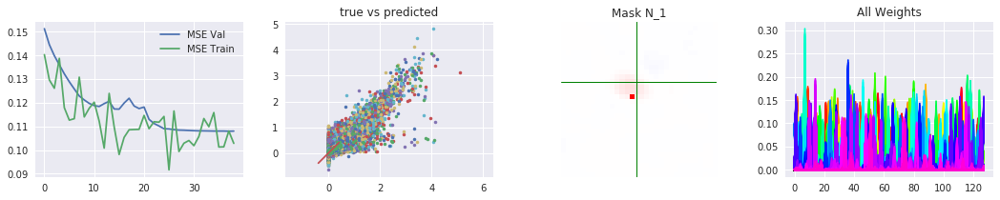

Total FEV =  0.848273787981
Runs: 4000; MSE - train: 0.104567, val: 0.107852305856; lr = 0.0001
best run:  4000 0.107852305856
Loss/Regularization: 0.00765389268054 MSE, 0.0 kernel, 0.00161386728287 mask, 0.00468915447593 weights


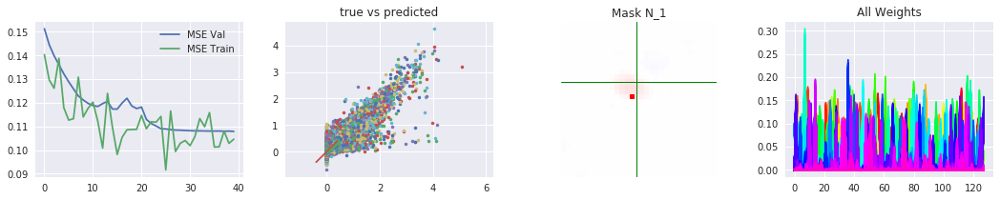

Total FEV =  0.848870290655
Runs: 4100; MSE - train: 0.116048, val: 0.107823384866; lr = 0.0001
best run:  4100 0.107823384866
Loss/Regularization: 0.00762380185188 MSE, 0.0 kernel, 0.0016079117775 mask, 0.00467544972897 weights


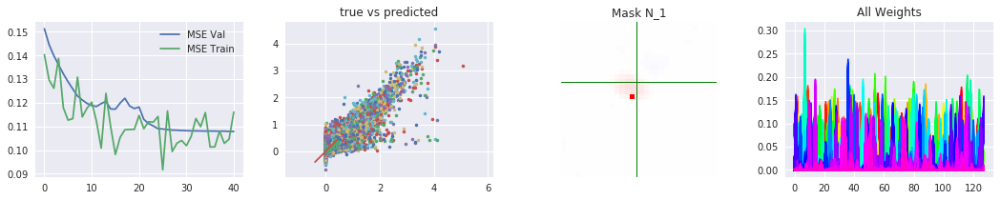

Total FEV =  0.849433509256
Runs: 4200; MSE - train: 0.10665, val: 0.10780681153; lr = 0.0001
best run:  4200 0.10780681153
Loss/Regularization: 0.0075953900523 MSE, 0.0 kernel, 0.00160168004036 mask, 0.00468301042914 weights


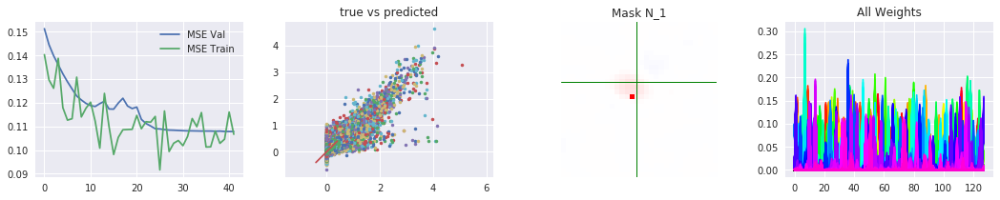

Total FEV =  0.850379899994
Runs: 4300; MSE - train: 0.10502, val: 0.107747267271; lr = 0.0001
best run:  4300 0.107747267271
Loss/Regularization: 0.00754764897283 MSE, 0.0 kernel, 0.00159585857391 mask, 0.00463180571795 weights


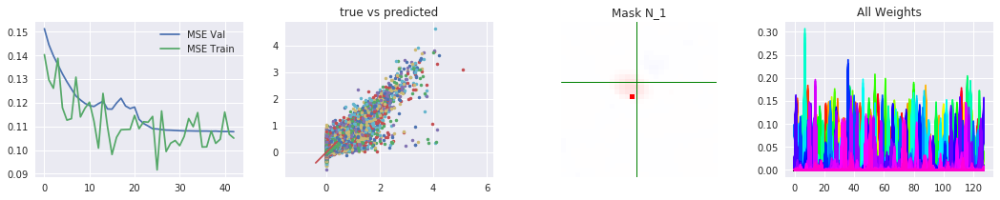

Total FEV =  0.850369483396
Runs: 4400; MSE - train: 0.0948011, val: 0.107745004097; lr = 0.0001
best run:  4400 0.107745004097
Loss/Regularization: 0.00754817444249 MSE, 0.0 kernel, 0.00160246868134 mask, 0.00463396802545 weights


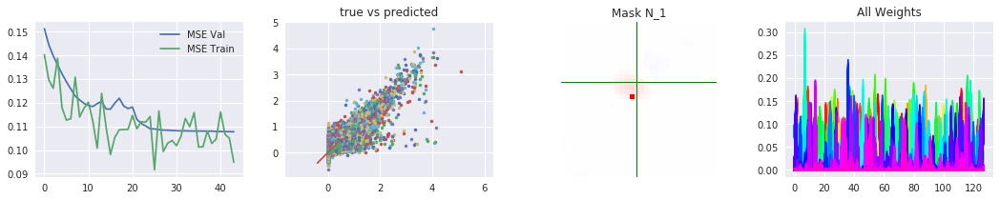

Total FEV =  0.85051052661
Runs: 4500; MSE - train: 0.103828, val: 0.107737658906; lr = 0.0001
best run:  4500 0.107737658906
Loss/Regularization: 0.00754105945816 MSE, 0.0 kernel, 0.00160588788986 mask, 0.00464745283127 weights


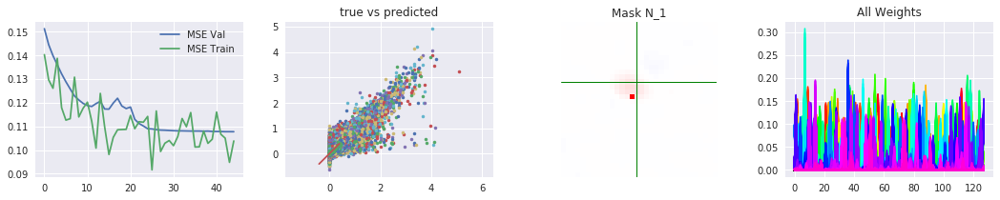

Total FEV =  0.850851052141
Runs: 4600; MSE - train: 0.0976184, val: 0.107721576287; lr = 0.0001
best run:  4600 0.107721576287
Loss/Regularization: 0.00752388150431 MSE, 0.0 kernel, 0.00160426468849 mask, 0.00458456620574 weights


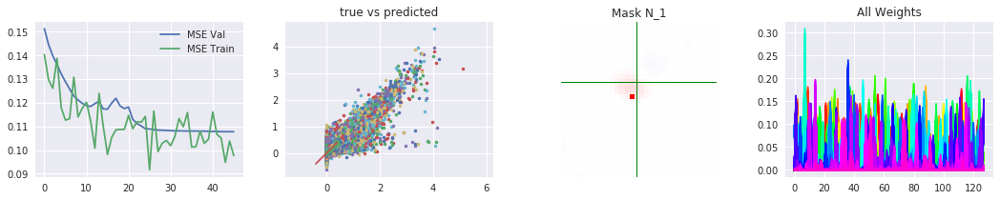

Total FEV =  0.851497858529
Runs: 4700; MSE - train: 0.119896, val: 0.107692477383; lr = 0.0001
best run:  4700 0.107692477383
Loss/Regularization: 0.00749125308357 MSE, 0.0 kernel, 0.00160141296387 mask, 0.00461784124374 weights


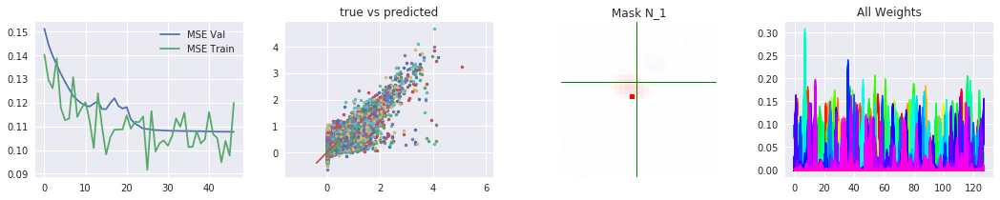

Total FEV =  0.852327392984
Runs: 4800; MSE - train: 0.105144, val: 0.10764537295; lr = 0.0001
best run:  4800 0.10764537295
Loss/Regularization: 0.00744940686855 MSE, 0.0 kernel, 0.00159581737518 mask, 0.00458338469267 weights


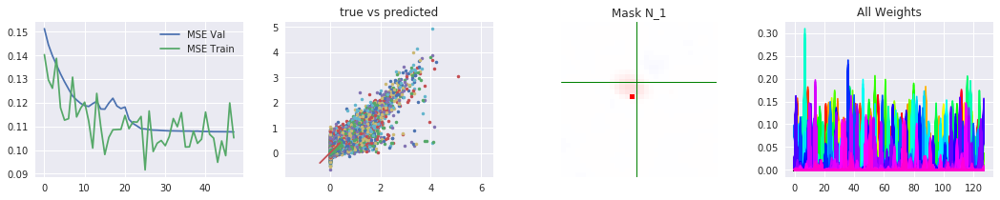

Total FEV =  0.852972525102
Runs: 4900; MSE - train: 0.109789, val: 0.107611329325; lr = 0.0001
best run:  4900 0.107611329325
Loss/Regularization: 0.00741686290712 MSE, 0.0 kernel, 0.00159139809608 mask, 0.00460982590914 weights


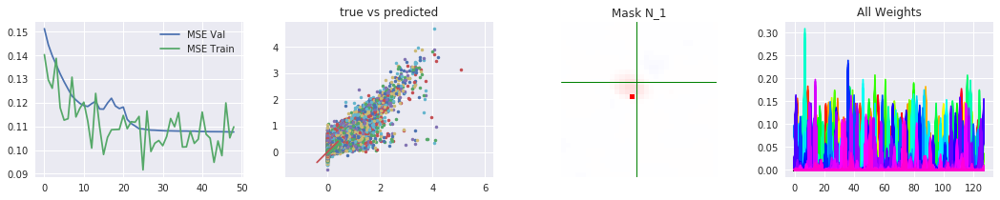

Total FEV =  0.854663869599
Runs: 5000; MSE - train: 0.105598, val: 0.10753027548; lr = 0.0001
best run:  5000 0.10753027548
Loss/Regularization: 0.00733154232148 MSE, 0.0 kernel, 0.00158798017502 mask, 0.00458910897374 weights


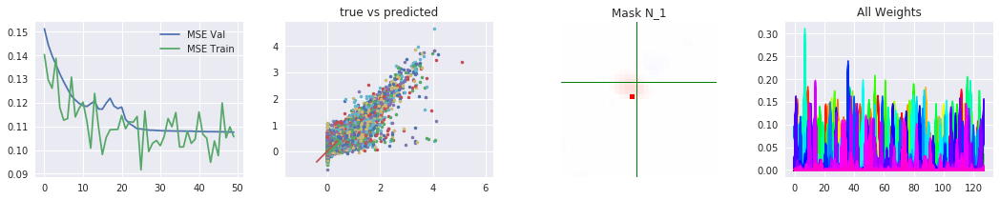

Total FEV =  0.854972832637
Runs: 5100; MSE - train: 0.104231, val: 0.107511042828; lr = 0.0001
best run:  5100 0.107511042828
Loss/Regularization: 0.00731595655088 MSE, 0.0 kernel, 0.00158292703629 mask, 0.00458376154304 weights


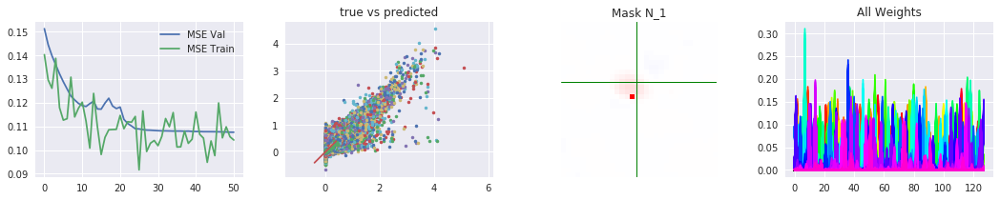

Total FEV =  0.854278355674
Runs: 5200; MSE - train: 0.101889, val: 0.107535097688; lr = 0.0001
best run:  5100 0.107511042828
Loss/Regularization: 0.00735098973382 MSE, 0.0 kernel, 0.00157938022614 mask, 0.00456241875887 weights


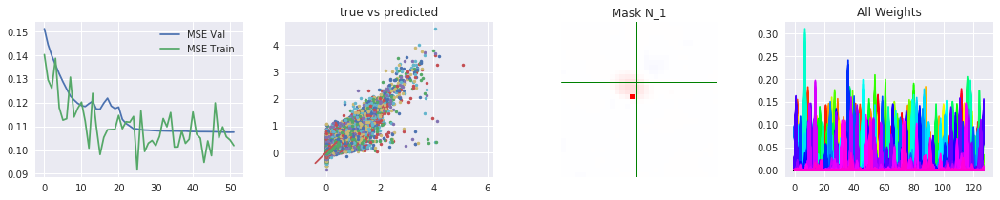

Total FEV =  0.854097806699
Runs: 5300; MSE - train: 0.0952679, val: 0.107551679736; lr = 0.0001
best run:  5100 0.107511042828
Loss/Regularization: 0.00736009760294 MSE, 0.0 kernel, 0.00159220504761 mask, 0.00458211869001 weights


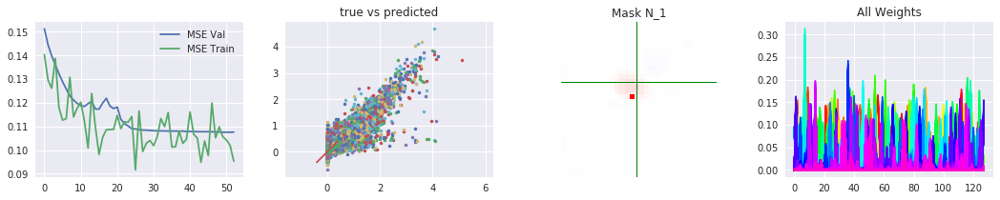

Total FEV =  0.855633975333
Runs: 5400; MSE - train: 0.10919, val: 0.107471045647; lr = 0.0001
best run:  5400 0.107471045647
Loss/Regularization: 0.00728260492906 MSE, 0.0 kernel, 0.00159625983238 mask, 0.00453634232283 weights


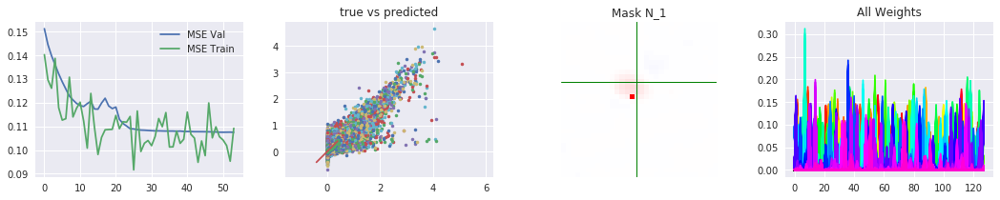

Total FEV =  0.857075817074
Runs: 5500; MSE - train: 0.108308, val: 0.107399032001; lr = 0.0001
best run:  5500 0.107399032001
Loss/Regularization: 0.00720987061504 MSE, 0.0 kernel, 0.00159464836121 mask, 0.00453683674335 weights


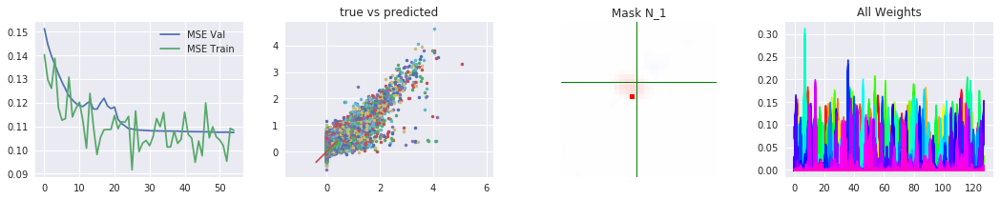

Total FEV =  0.857103354855
Runs: 5600; MSE - train: 0.104477, val: 0.107402619575; lr = 0.0001
best run:  5500 0.107399032001
Loss/Regularization: 0.00720848146011 MSE, 0.0 kernel, 0.00159219274521 mask, 0.00452840253711 weights


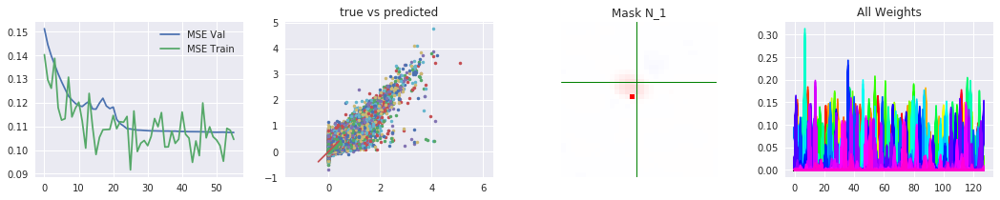

Total FEV =  0.85694394889
Runs: 5700; MSE - train: 0.0976743, val: 0.107401153133; lr = 0.0001
best run:  5500 0.107399032001
Loss/Regularization: 0.00721652276115 MSE, 0.0 kernel, 0.00158950080872 mask, 0.00455193668604 weights


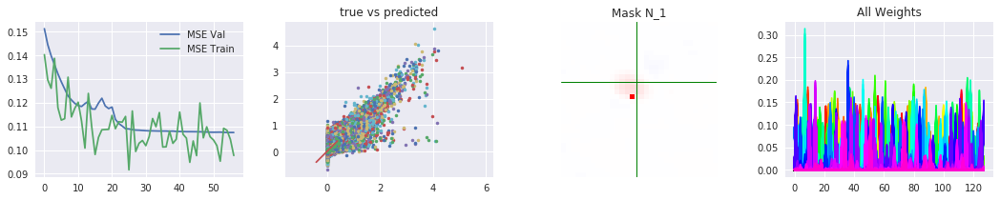

Total FEV =  0.857687098567
Runs: 5800; MSE - train: 0.107392, val: 0.10736604113; lr = 0.0001
best run:  5800 0.10736604113
Loss/Regularization: 0.00717903426266 MSE, 0.0 kernel, 0.00158717164993 mask, 0.00451220199466 weights


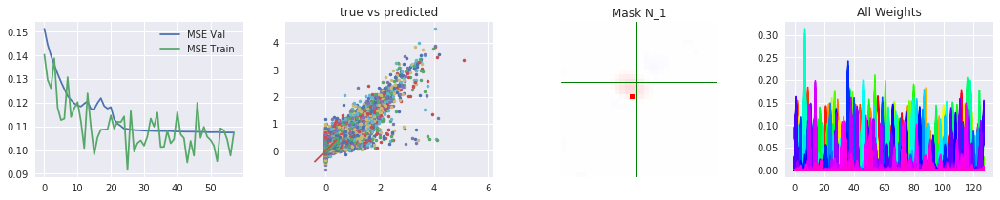

Total FEV =  0.858605681518
Runs: 5900; MSE - train: 0.108673, val: 0.107321532383; lr = 0.0001
best run:  5900 0.107321532383
Loss/Regularization: 0.00713269595872 MSE, 0.0 kernel, 0.00158190279007 mask, 0.0045139311254 weights


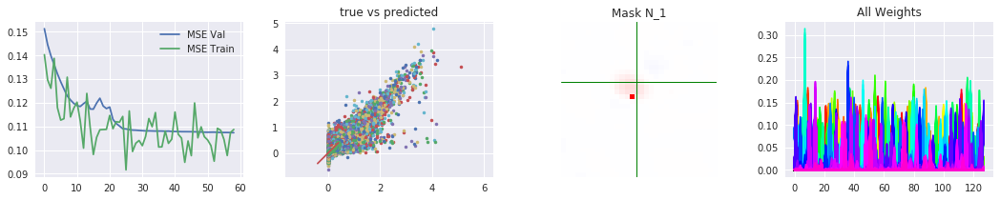

Total FEV =  0.859648672858
Runs: 6000; MSE - train: 0.102024, val: 0.107267687938; lr = 0.0001
best run:  6000 0.107267687938
Loss/Regularization: 0.00708008182119 MSE, 0.0 kernel, 0.00157883663177 mask, 0.00448667854071 weights


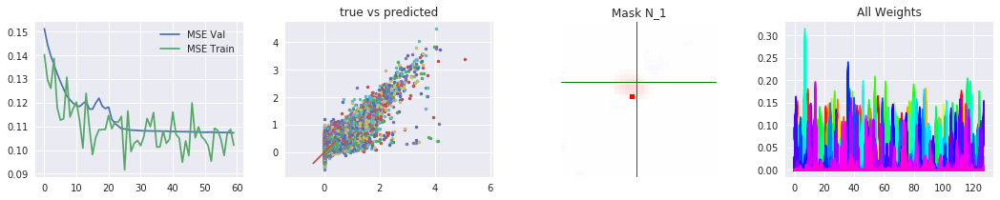

Total FEV =  0.859820071613
Runs: 6100; MSE - train: 0.108348, val: 0.107257127942; lr = 0.0001
best run:  6100 0.107257127942
Loss/Regularization: 0.00707143553882 MSE, 0.0 kernel, 0.00157869458199 mask, 0.00450215801597 weights


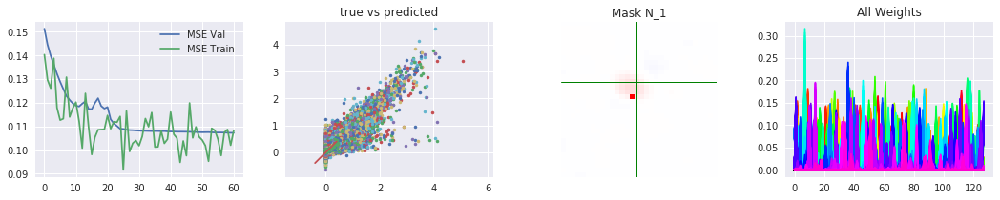

Total FEV =  0.859437857768
Runs: 6200; MSE - train: 0.106429, val: 0.107278228107; lr = 0.0001
best run:  6100 0.107257127942
Loss/Regularization: 0.00709071647725 MSE, 0.0 kernel, 0.00159298510551 mask, 0.00448607727885 weights


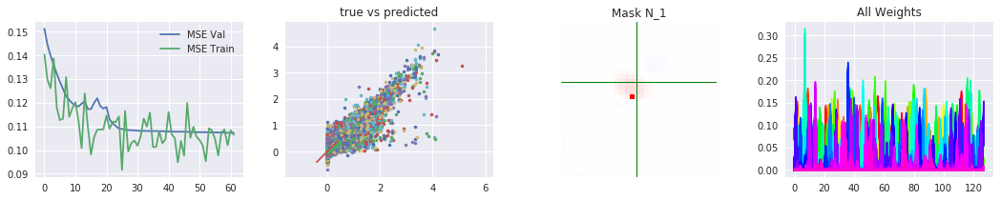

Total FEV =  0.859626905025
Runs: 6300; MSE - train: 0.114774, val: 0.10726096445; lr = 0.0001
best run:  6100 0.107257127942
Loss/Regularization: 0.00708117990871 MSE, 0.0 kernel, 0.0015951842308 mask, 0.00447951391339 weights


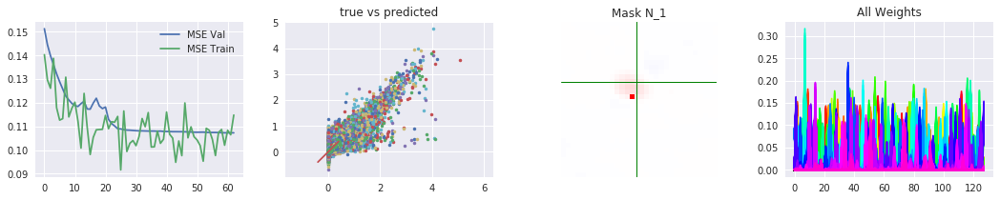

Total FEV =  0.861083073266
Runs: 6400; MSE - train: 0.112173, val: 0.107189795783; lr = 0.0001
best run:  6400 0.107189795783
Loss/Regularization: 0.00700772288837 MSE, 0.0 kernel, 0.00159256482124 mask, 0.004494163692 weights


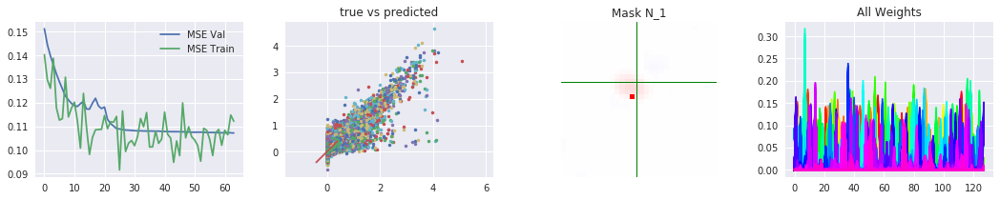

Total FEV =  0.860830935062
Runs: 6500; MSE - train: 0.104356, val: 0.107207143078; lr = 0.0001
best run:  6400 0.107189795783
Loss/Regularization: 0.0070204421063 MSE, 0.0 kernel, 0.00159051661491 mask, 0.00445610627532 weights


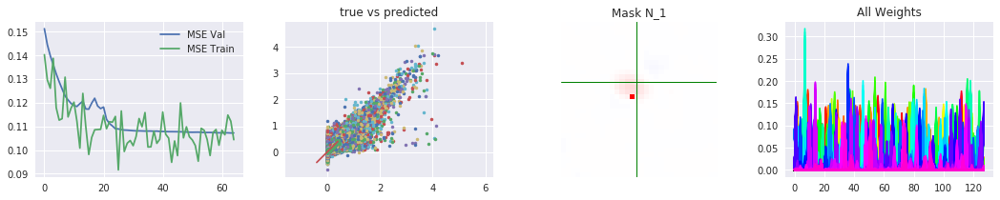

Total FEV =  0.860353819694
Runs: 6600; MSE - train: 0.114559, val: 0.107228377954; lr = 0.0001
best run:  6400 0.107189795783
Loss/Regularization: 0.00704451039201 MSE, 0.0 kernel, 0.00158634324074 mask, 0.00450108513236 weights


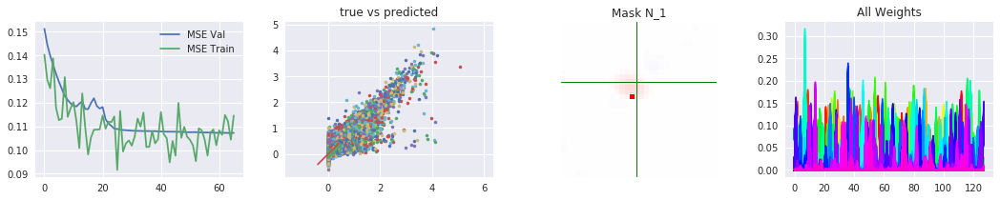

Total FEV =  0.861307856002
Runs: 6700; MSE - train: 0.108119, val: 0.107185557605; lr = 0.0001
best run:  6700 0.107185557605
Loss/Regularization: 0.00699638362858 MSE, 0.0 kernel, 0.00158351268768 mask, 0.00447675347328 weights


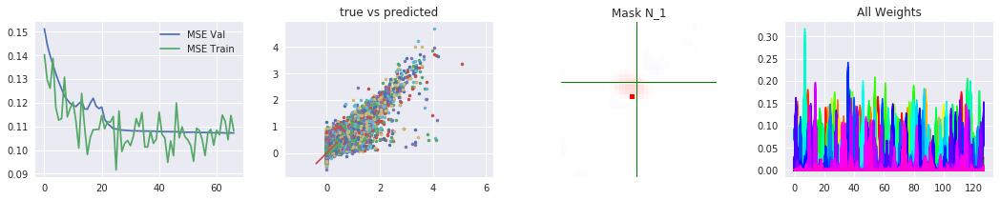

Total FEV =  0.861119505107
Runs: 6800; MSE - train: 0.106712, val: 0.107194381135; lr = 0.0001
best run:  6700 0.107185557605
Loss/Regularization: 0.00700588506879 MSE, 0.0 kernel, 0.00158193483353 mask, 0.0044482639432 weights


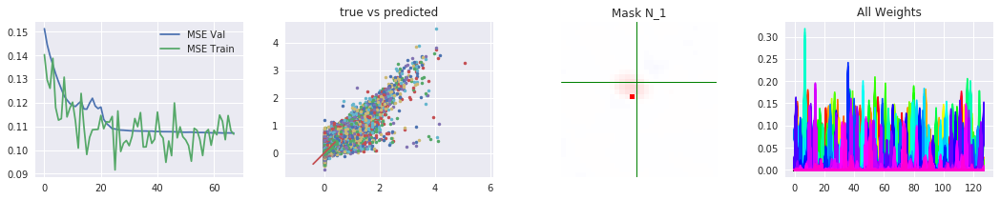

Total FEV =  0.863385515789
Runs: 6900; MSE - train: 0.108102, val: 0.107076166318; lr = 0.0001
best run:  6900 0.107076166318
Loss/Regularization: 0.00689157520537 MSE, 0.0 kernel, 0.00157828502655 mask, 0.00445267081261 weights


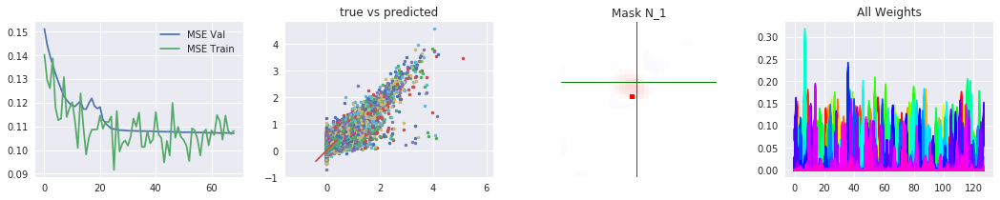

Total FEV =  0.863331869879
Runs: 7000; MSE - train: 0.108955, val: 0.107082277056; lr = 0.0001
best run:  6900 0.107076166318
Loss/Regularization: 0.00689428139594 MSE, 0.0 kernel, 0.00158626713753 mask, 0.00445579200983 weights


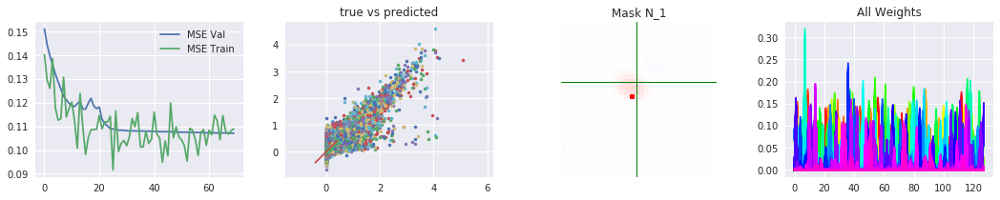

Total FEV =  0.8633254428
Runs: 7100; MSE - train: 0.114444, val: 0.107081077753; lr = 0.0001
best run:  6900 0.107076166318
Loss/Regularization: 0.00689460561262 MSE, 0.0 kernel, 0.00159579520226 mask, 0.00444490581751 weights


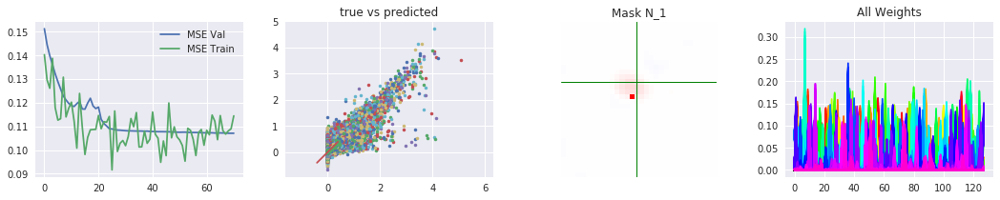

Total FEV =  0.863960341786
Runs: 7200; MSE - train: 0.0998071, val: 0.107049328425; lr = 0.0001
best run:  7200 0.107049328425
Loss/Regularization: 0.00686257786583 MSE, 0.0 kernel, 0.00159663090706 mask, 0.00443475052714 weights


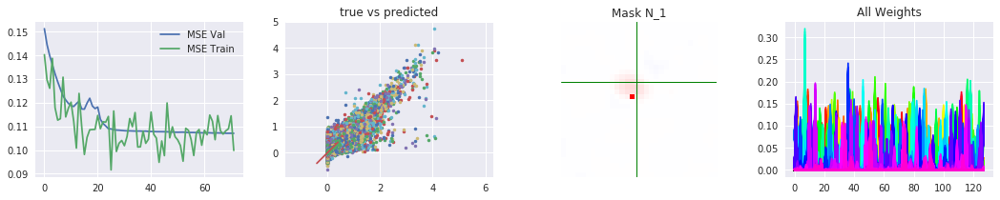

Total FEV =  0.864863988415
Runs: 7300; MSE - train: 0.0992422, val: 0.107004042775; lr = 0.0001
best run:  7300 0.107004042775
Loss/Regularization: 0.00681699303095 MSE, 0.0 kernel, 0.00159579277039 mask, 0.00445066988468 weights


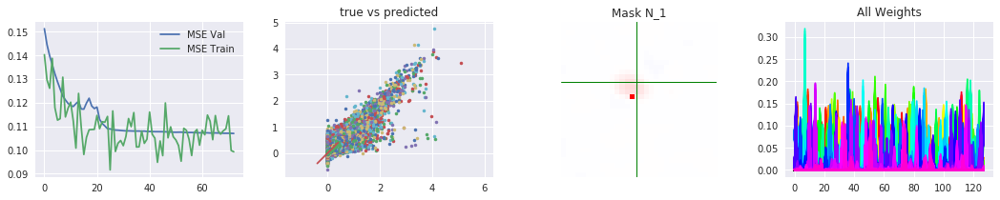

Total FEV =  0.865590233261
Runs: 7400; MSE - train: 0.105754, val: 0.106965093303; lr = 0.0001
best run:  7400 0.106965093303
Loss/Regularization: 0.0067803573038 MSE, 0.0 kernel, 0.00159282016754 mask, 0.0044177377224 weights


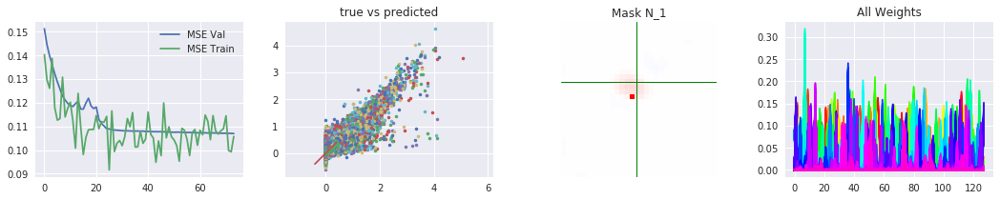

Total FEV =  0.865357608797
Runs: 7500; MSE - train: 0.112461, val: 0.106973115655; lr = 0.0001
best run:  7400 0.106965093303
Loss/Regularization: 0.00679209214286 MSE, 0.0 kernel, 0.00158796401024 mask, 0.00440921187401 weights


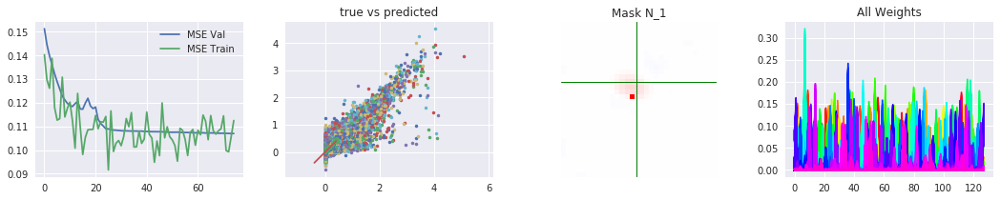

Total FEV =  0.866038629281
Runs: 7600; MSE - train: 0.108886, val: 0.106928360138; lr = 0.0001
best run:  7600 0.106928360138
Loss/Regularization: 0.00675773777766 MSE, 0.0 kernel, 0.0015844938755 mask, 0.00442707449198 weights


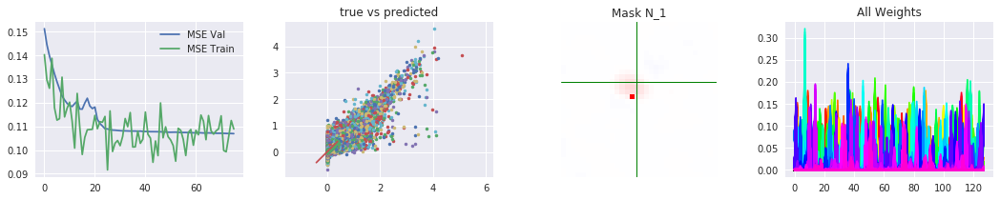

Total FEV =  0.866453761998
Runs: 7700; MSE - train: 0.0996865, val: 0.106913918689; lr = 0.0001
best run:  7700 0.106913918689
Loss/Regularization: 0.00673679623287 MSE, 0.0 kernel, 0.00158191165924 mask, 0.0044308398664 weights


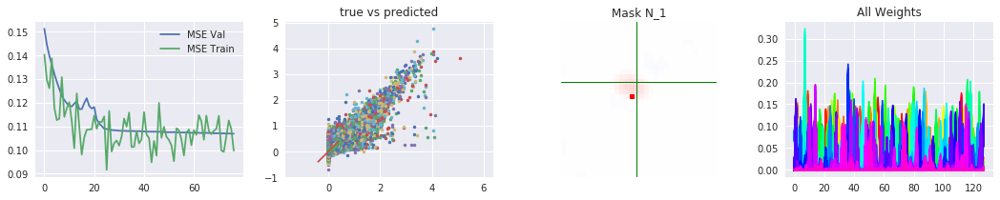

Total FEV =  0.865636772461
Runs: 7800; MSE - train: 0.122069, val: 0.1069648377; lr = 0.0001
best run:  7700 0.106913918689
Loss/Regularization: 0.00677800961421 MSE, 0.0 kernel, 0.0015797495842 mask, 0.00443245992064 weights


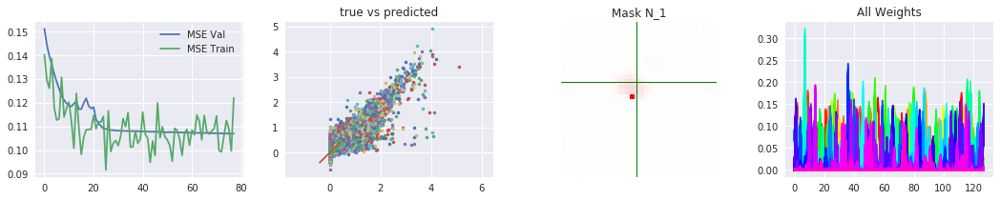

Total FEV =  0.867699088032
Runs: 7900; MSE - train: 0.101887, val: 0.106857610506; lr = 0.0001
best run:  7900 0.106857610506
Loss/Regularization: 0.00667397523648 MSE, 0.0 kernel, 0.00159551725388 mask, 0.00440069139004 weights


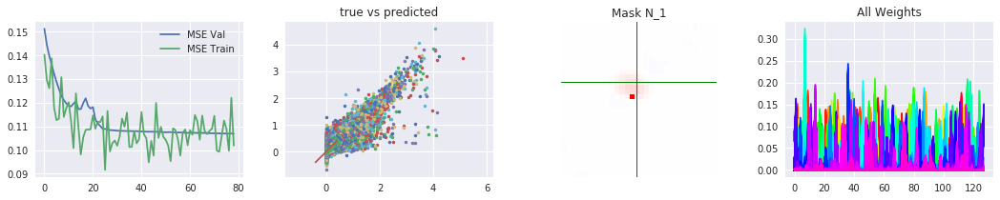

Total FEV =  0.86755261411
Runs: 8000; MSE - train: 0.105846, val: 0.106864488233; lr = 0.0001
best run:  7900 0.106857610506
Loss/Regularization: 0.00668136417517 MSE, 0.0 kernel, 0.00160047326088 mask, 0.00441835552454 weights


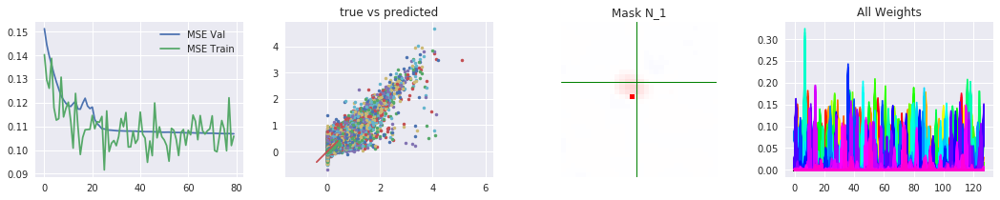

Total FEV =  0.868321627873
Runs: 8100; MSE - train: 0.11275, val: 0.106824050687; lr = 0.0001
best run:  8100 0.106824050687
Loss/Regularization: 0.00664257095195 MSE, 0.0 kernel, 0.00160056095123 mask, 0.00440491586924 weights


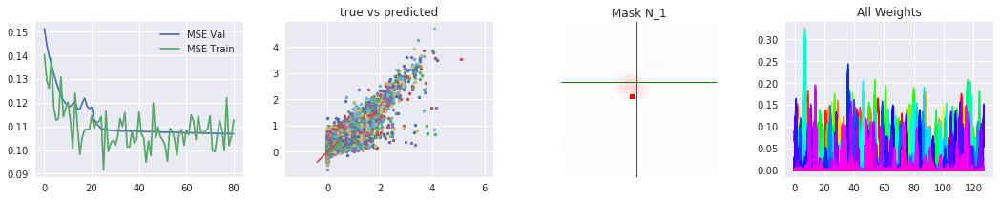

Total FEV =  0.867925602733
Runs: 8200; MSE - train: 0.100115, val: 0.106839978346; lr = 0.0001
best run:  8100 0.106824050687
Loss/Regularization: 0.00666254860698 MSE, 0.0 kernel, 0.00159826011658 mask, 0.00439030945301 weights


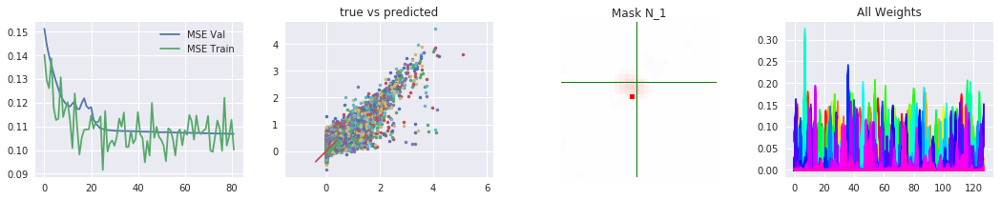

Total FEV =  0.869332811522
Runs: 8300; MSE - train: 0.0951544, val: 0.106772773148; lr = 0.0001
best run:  8300 0.106772773148
Loss/Regularization: 0.0065915613668 MSE, 0.0 kernel, 0.00159473905563 mask, 0.00436673820019 weights


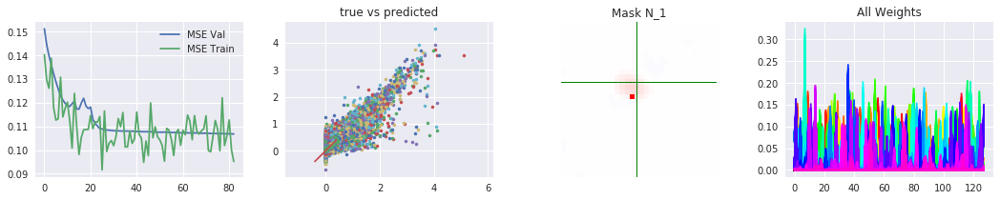

Total FEV =  0.869321057585
Runs: 8400; MSE - train: 0.110243, val: 0.106772703449; lr = 0.0001
best run:  8400 0.106772703449
Loss/Regularization: 0.00659215429914 MSE, 0.0 kernel, 0.00159064106941 mask, 0.00438418596983 weights


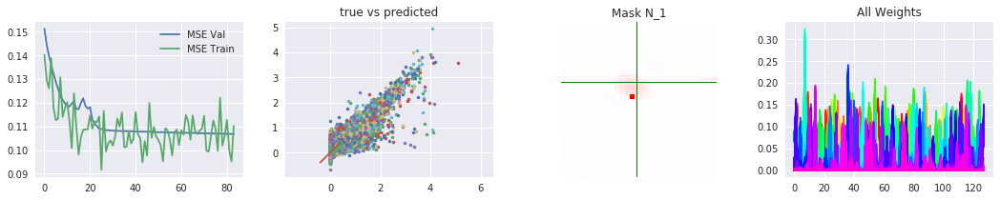

Total FEV =  0.86810380819
Runs: 8500; MSE - train: 0.110689, val: 0.10683860762; lr = 0.0001
best run:  8400 0.106772703449
Loss/Regularization: 0.00665355895762 MSE, 0.0 kernel, 0.00158693447113 mask, 0.00440934017301 weights


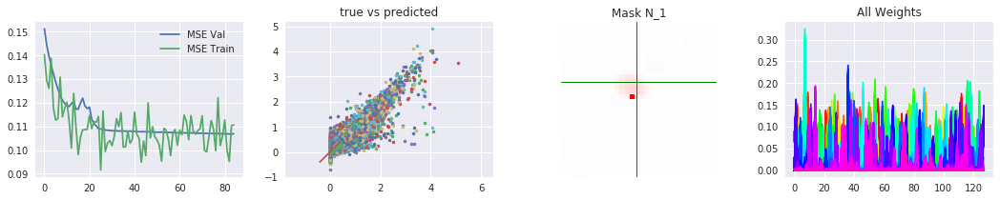

Total FEV =  0.871190099834
Runs: 8600; MSE - train: 0.105124, val: 0.106684843138; lr = 0.0001
best run:  8600 0.106684843138
Loss/Regularization: 0.00649786967551 MSE, 0.0 kernel, 0.00158446397781 mask, 0.00438903450966 weights


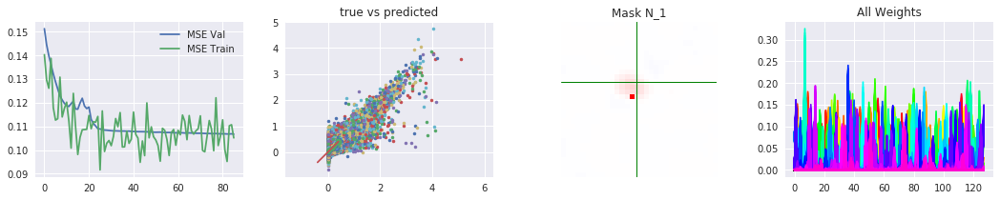

Total FEV =  0.870625302157
Runs: 8700; MSE - train: 0.106791, val: 0.106706864651; lr = 0.0001
best run:  8600 0.106684843138
Loss/Regularization: 0.00652636113227 MSE, 0.0 kernel, 0.00158738765717 mask, 0.00436967119575 weights


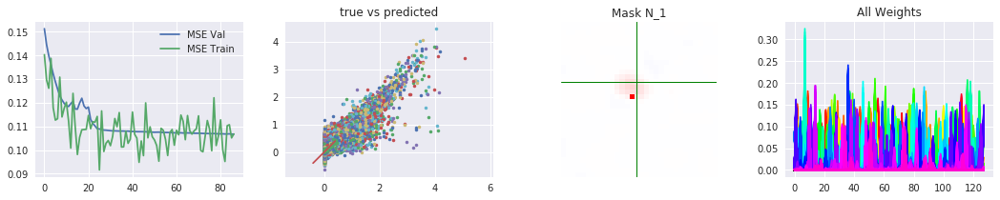

Total FEV =  0.870628044339
Runs: 8800; MSE - train: 0.10166, val: 0.10670475812; lr = 0.0001
best run:  8600 0.106684843138
Loss/Regularization: 0.00652622280177 MSE, 0.0 kernel, 0.00160023694038 mask, 0.00437537312508 weights


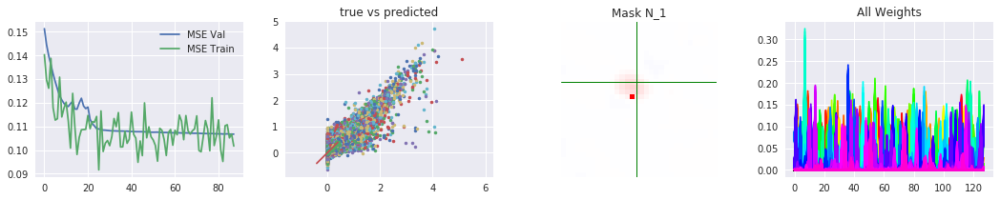

Total FEV =  0.871998461278
Runs: 8900; MSE - train: 0.109165, val: 0.106641142539; lr = 0.0001
best run:  8900 0.106641142539
Loss/Regularization: 0.00645709154196 MSE, 0.0 kernel, 0.00160318937302 mask, 0.00434133410454 weights


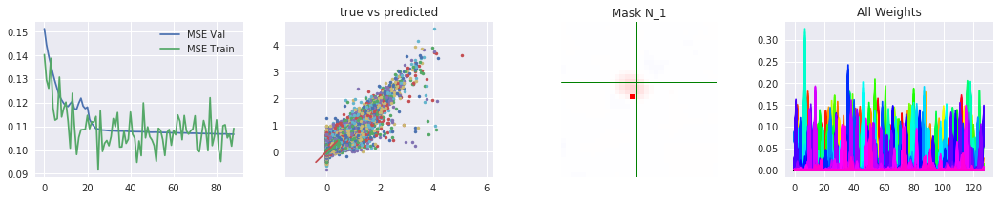

Total FEV =  0.870714195457
Runs: 9000; MSE - train: 0.103871, val: 0.106709464543; lr = 0.0001
best run:  8900 0.106641142539
Loss/Regularization: 0.00652187687228 MSE, 0.0 kernel, 0.00160263805389 mask, 0.00433416858315 weights


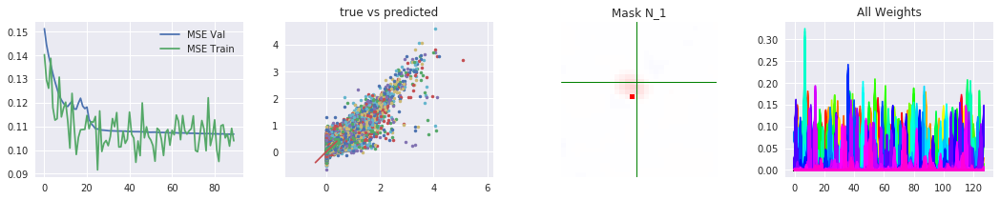

Total FEV =  0.872610963569
Runs: 9100; MSE - train: 0.0986698, val: 0.10660477271; lr = 0.0001
best run:  9100 0.10660477271
Loss/Regularization: 0.00642619360588 MSE, 0.0 kernel, 0.00159927821159 mask, 0.00435507282615 weights


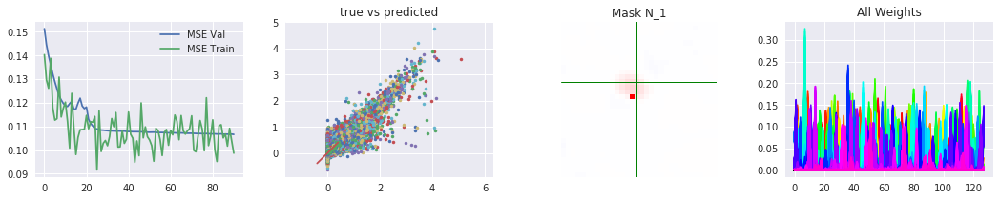

Total FEV =  0.869151506183
Runs: 9200; MSE - train: 0.116669, val: 0.106785760111; lr = 0.0001
best run:  9100 0.10660477271
Loss/Regularization: 0.00660070739104 MSE, 0.0 kernel, 0.001594703722 mask, 0.00439987689257 weights


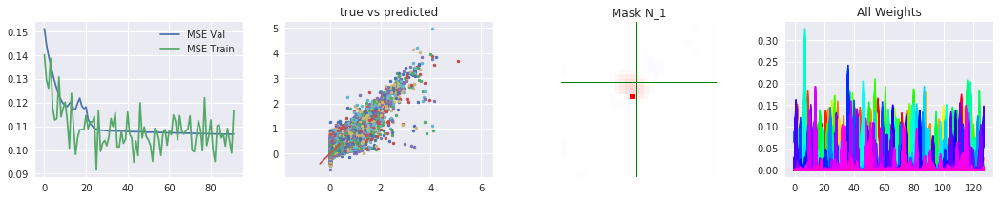

Total FEV =  0.872693443061
Runs: 9300; MSE - train: 0.116708, val: 0.106613530868; lr = 0.0001
best run:  9100 0.10660477271
Loss/Regularization: 0.00642203289317 MSE, 0.0 kernel, 0.00159363670349 mask, 0.00434631854296 weights


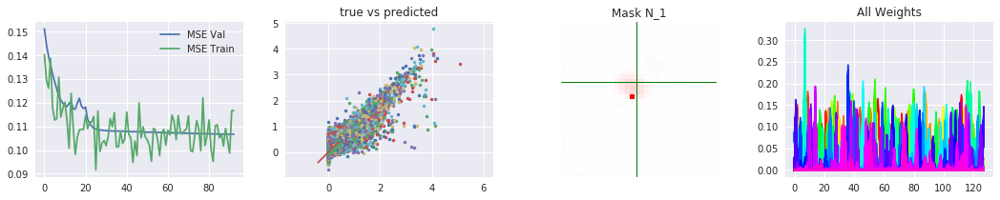

Total FEV =  0.874046715163
Runs: 9400; MSE - train: 0.105484, val: 0.106525015386; lr = 0.0001
best run:  9400 0.106525015386
Loss/Regularization: 0.00635376651189 MSE, 0.0 kernel, 0.00159157447815 mask, 0.0043403314054 weights


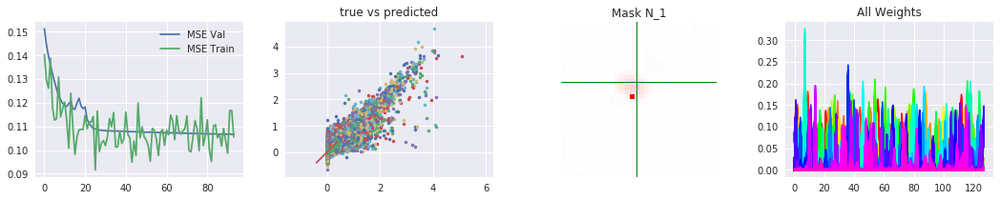

Total FEV =  0.874326769618
Runs: 9500; MSE - train: 0.0936804, val: 0.106520810435; lr = 0.0001
best run:  9500 0.106520810435
Loss/Regularization: 0.00633963904693 MSE, 0.0 kernel, 0.00158878612518 mask, 0.00434018835425 weights


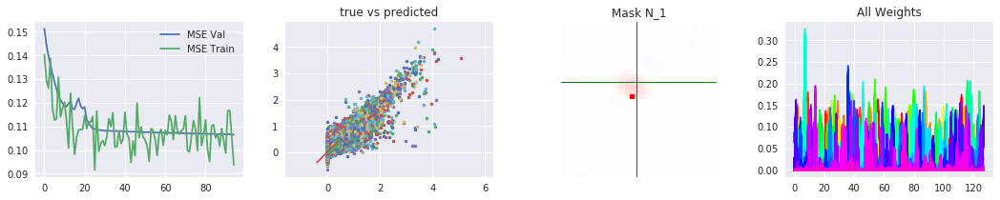

Total FEV =  0.873571432724
Runs: 9600; MSE - train: 0.1026, val: 0.106554196126; lr = 0.0001
best run:  9500 0.106520810435
Loss/Regularization: 0.00637774233473 MSE, 0.0 kernel, 0.001597453022 mask, 0.00433811500669 weights


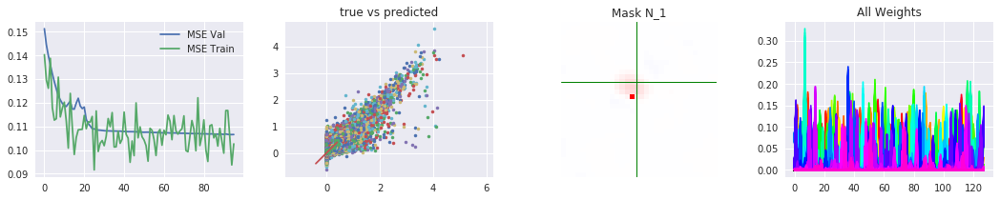

Total FEV =  0.873674979648
Runs: 9700; MSE - train: 0.100293, val: 0.106556363945; lr = 0.0001
best run:  9500 0.106520810435
Loss/Regularization: 0.00637251886656 MSE, 0.0 kernel, 0.00160592064857 mask, 0.004337772578 weights


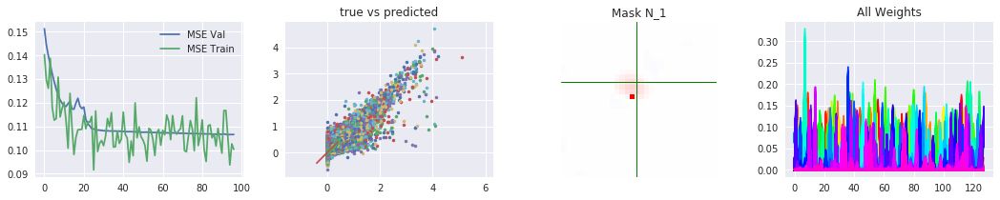

Total FEV =  0.87320184803
Runs: 9800; MSE - train: 0.107103, val: 0.106578476186; lr = 0.0001
best run:  9500 0.106520810435
Loss/Regularization: 0.00639638619032 MSE, 0.0 kernel, 0.00160793924332 mask, 0.00432419389486 weights


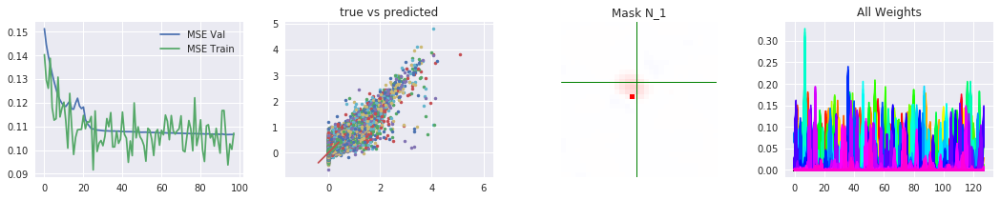

Total FEV =  0.874118190158
Runs: 9900; MSE - train: 0.107755, val: 0.106532120176; lr = 0.0001
best run:  9500 0.106520810435
Loss/Regularization: 0.00635016092565 MSE, 0.0 kernel, 0.0016046646595 mask, 0.00432326450944 weights


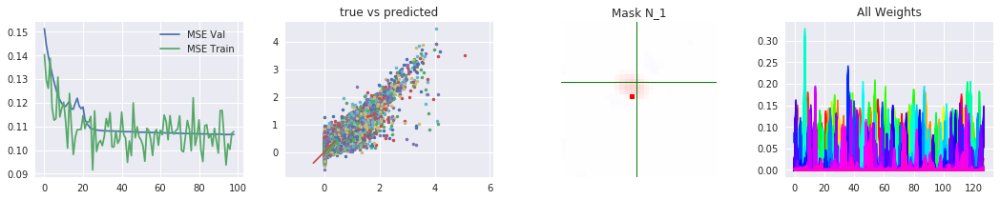

Total FEV =  0.875362305202
Runs: 10000; MSE - train: 0.11431, val: 0.106458953071; lr = 0.0001
best run:  10000 0.106458953071
Loss/Regularization: 0.0062874010182 MSE, 0.0 kernel, 0.00160209374428 mask, 0.00430581450462 weights


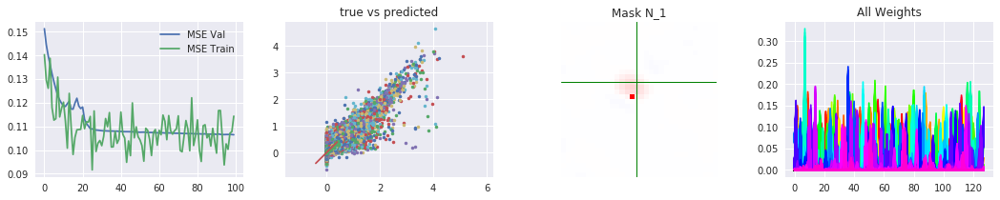

Total FEV =  0.875280819196
Runs: 10100; MSE - train: 0.110765, val: 0.106472307095; lr = 0.0001
best run:  10000 0.106458953071
Loss/Regularization: 0.00629151161411 MSE, 0.0 kernel, 0.00159935588837 mask, 0.00431979596615 weights


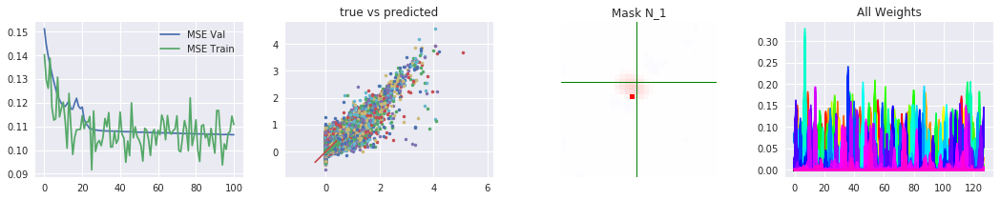

Total FEV =  0.875756244715
Runs: 10200; MSE - train: 0.110287, val: 0.106454873998; lr = 0.0001
best run:  10200 0.106454873998
Loss/Regularization: 0.00626752857352 MSE, 0.0 kernel, 0.00159556217194 mask, 0.00431926041842 weights


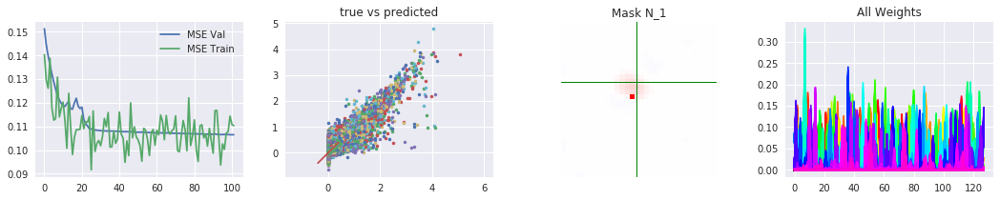

Total FEV =  0.876185532581
Runs: 10300; MSE - train: 0.10894, val: 0.106431853567; lr = 0.0001
best run:  10300 0.106431853567
Loss/Regularization: 0.00624587296625 MSE, 0.0 kernel, 0.0015935936451 mask, 0.00429315984249 weights


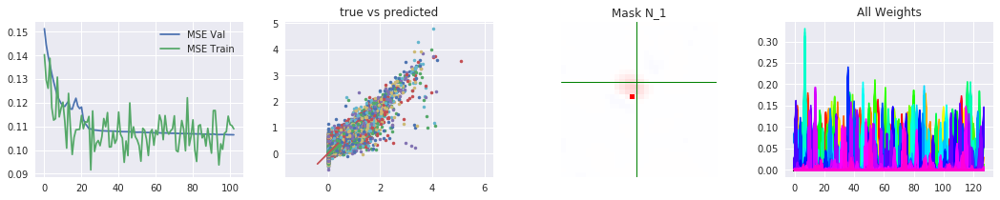

Total FEV =  0.878036653437
Runs: 10400; MSE - train: 0.10668, val: 0.106338160413; lr = 0.0001
best run:  10400 0.106338160413
Loss/Regularization: 0.0061524923949 MSE, 0.0 kernel, 0.00159112658501 mask, 0.00428692370653 weights


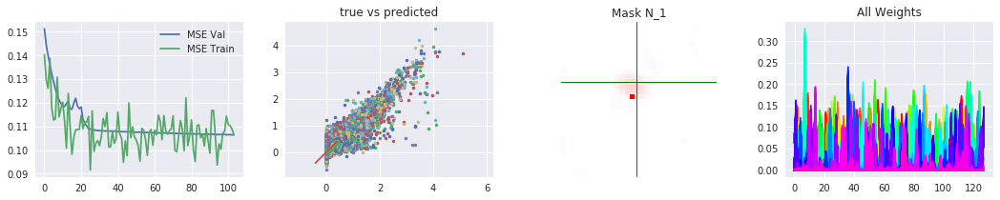

Total FEV =  0.876830019683
Runs: 10500; MSE - train: 0.110058, val: 0.106394145277; lr = 0.0001
best run:  10400 0.106338160413
Loss/Regularization: 0.0062133615429 MSE, 0.0 kernel, 0.00160416226387 mask, 0.00428004562855 weights


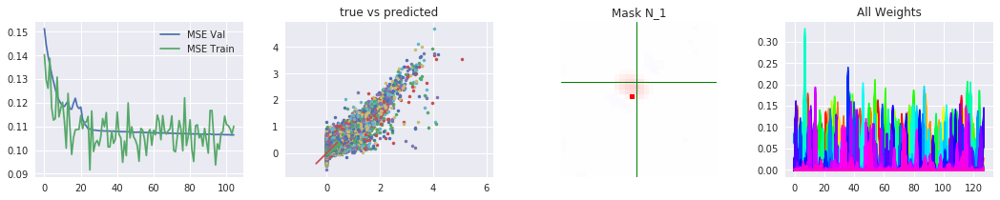

Total FEV =  0.874923767881
Runs: 10600; MSE - train: 0.104941, val: 0.10649428751; lr = 0.0001
best run:  10400 0.106338160413
Loss/Regularization: 0.00630952321808 MSE, 0.0 kernel, 0.00160890440941 mask, 0.00432943850756 weights


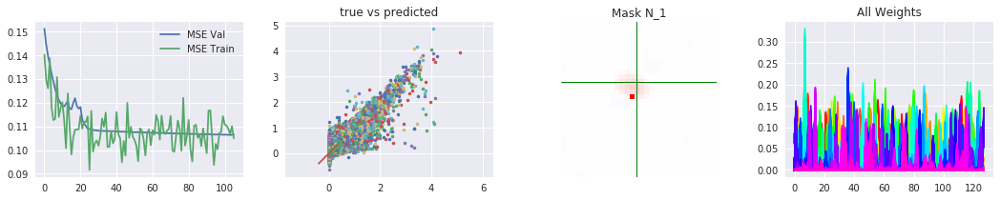

Total FEV =  0.877734496525
Runs: 10700; MSE - train: 0.102394, val: 0.106353296628; lr = 0.0001
best run:  10400 0.106338160413
Loss/Regularization: 0.00616773482761 MSE, 0.0 kernel, 0.00160886235237 mask, 0.00429909020662 weights


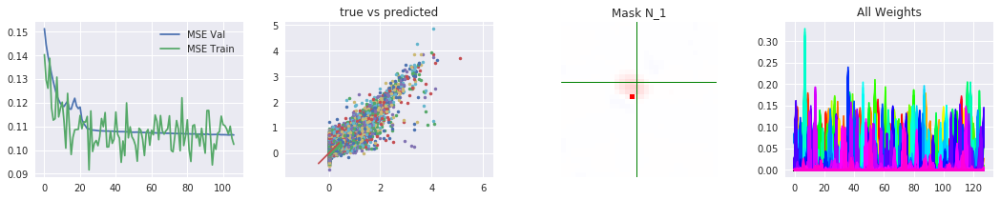

Total FEV =  0.876726363142
Runs: 10800; MSE - train: 0.10722, val: 0.106408740905; lr = 0.0001
best run:  10400 0.106338160413
Loss/Regularization: 0.00621859054081 MSE, 0.0 kernel, 0.00160700068474 mask, 0.0043085360527 weights


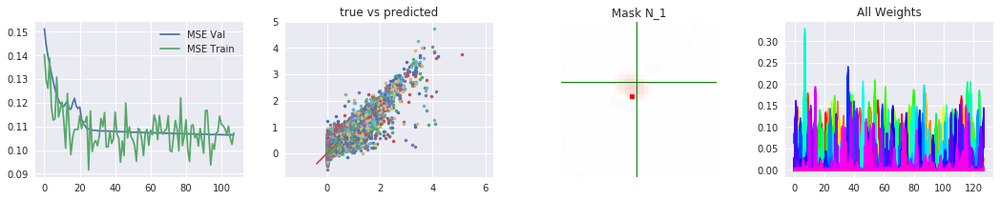

Total FEV =  0.877997596532
Runs: 10900; MSE - train: 0.110525, val: 0.106333753695; lr = 0.0001
best run:  10900 0.106333753695
Loss/Regularization: 0.00615446263691 MSE, 0.0 kernel, 0.00160387687683 mask, 0.00429404005408 weights


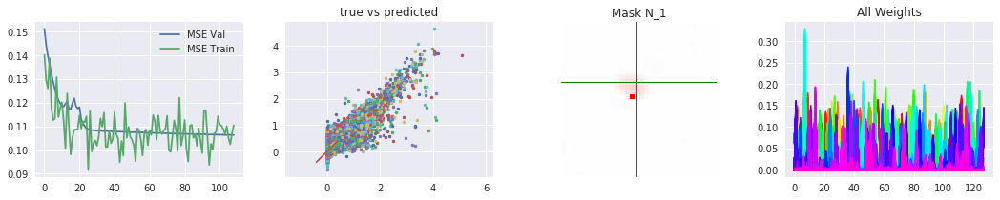

Total FEV =  0.87714548884
Runs: 11000; MSE - train: 0.108127, val: 0.106374439994; lr = 0.0001
best run:  10900 0.106333753695
Loss/Regularization: 0.00619744756841 MSE, 0.0 kernel, 0.00160136504173 mask, 0.00427652835846 weights


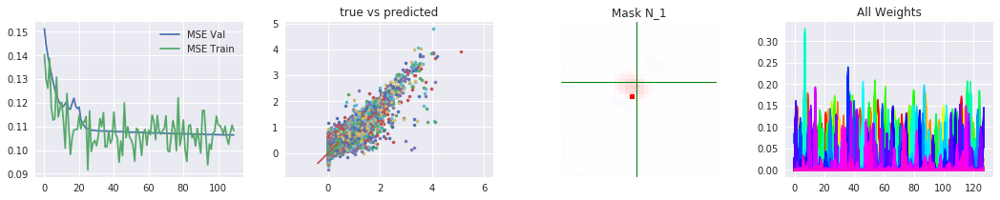

Total FEV =  0.87713280661
Runs: 11100; MSE - train: 0.113276, val: 0.10637502901; lr = 0.0001
best run:  10900 0.106333753695
Loss/Regularization: 0.00619808732881 MSE, 0.0 kernel, 0.00159752655029 mask, 0.00430388733745 weights


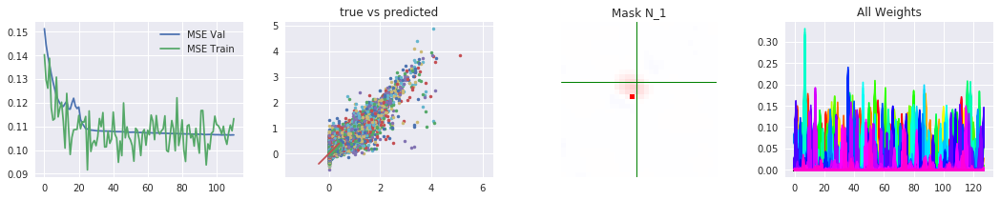

Total FEV =  0.878270312349
Runs: 11200; MSE - train: 0.106269, val: 0.10631455457; lr = 0.0001
best run:  11200 0.10631455457
Loss/Regularization: 0.00614070537267 MSE, 0.0 kernel, 0.00159554343224 mask, 0.00427629947662 weights


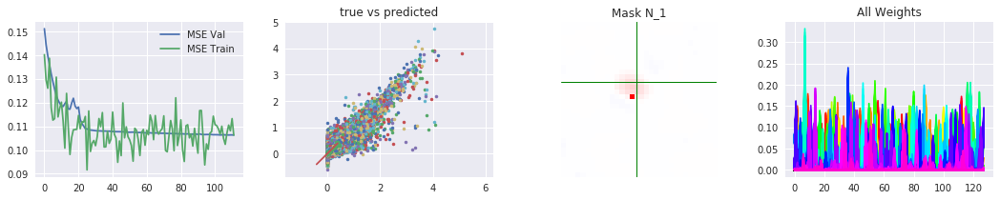

Total FEV =  0.878036336121
Runs: 11300; MSE - train: 0.103675, val: 0.106322392581; lr = 0.0001
best run:  11200 0.10631455457
Loss/Regularization: 0.00615250840201 MSE, 0.0 kernel, 0.00159449973106 mask, 0.00427681490779 weights


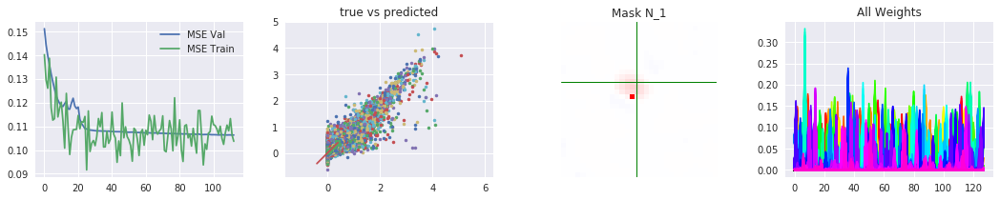

Total FEV =  0.877997211138
Runs: 11400; MSE - train: 0.10988, val: 0.106331689464; lr = 0.0001
best run:  11200 0.10631455457
Loss/Regularization: 0.00615448207827 MSE, 0.0 kernel, 0.00161082000732 mask, 0.00426433816552 weights


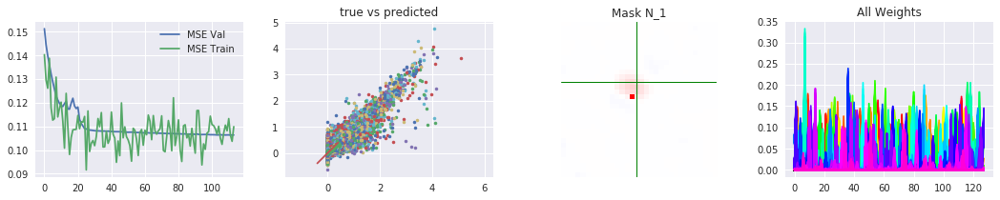

Total FEV =  0.878315136316
Runs: 11500; MSE - train: 0.110951, val: 0.106319768955; lr = 0.0001
best run:  11200 0.10631455457
Loss/Regularization: 0.00613844420877 MSE, 0.0 kernel, 0.00161363239288 mask, 0.00426737308502 weights


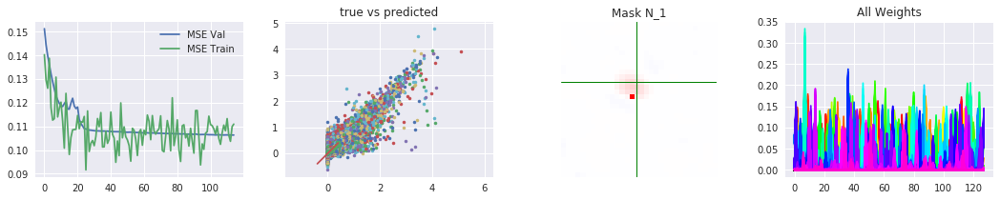

Total FEV =  0.878313891862
Runs: 11600; MSE - train: 0.103164, val: 0.106324580408; lr = 0.0001
best run:  11200 0.10631455457
Loss/Regularization: 0.00613850698574 MSE, 0.0 kernel, 0.00161133499146 mask, 0.00427131593227 weights


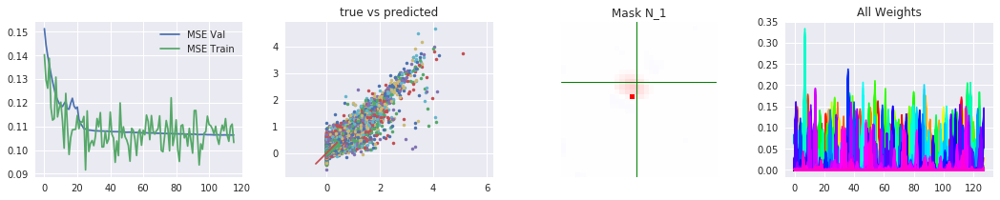

Total FEV =  0.879111684974
Runs: 11700; MSE - train: 0.107721, val: 0.106282283222; lr = 0.0001
best run:  11700 0.106282283222
Loss/Regularization: 0.00609826197615 MSE, 0.0 kernel, 0.00160854334831 mask, 0.00427600800991 weights


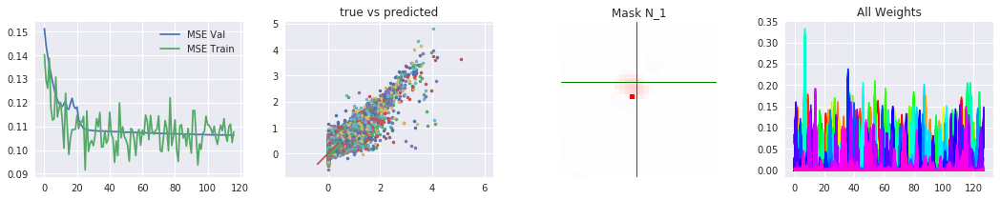

Total FEV =  0.880001637426
Runs: 11800; MSE - train: 0.107217, val: 0.106244408195; lr = 0.0001
best run:  11800 0.106244408195
Loss/Regularization: 0.00605336794979 MSE, 0.0 kernel, 0.0016066341877 mask, 0.00426600247622 weights


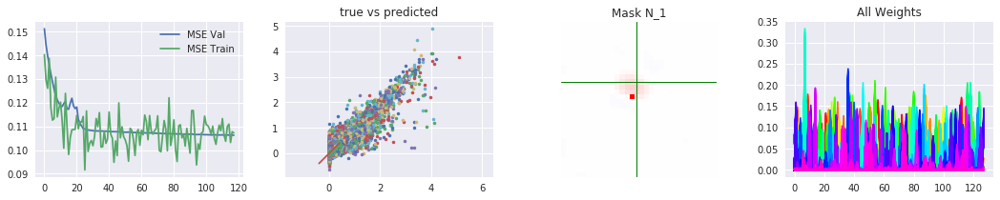

Total FEV =  0.879267321232
Runs: 11900; MSE - train: 0.107203, val: 0.106271319031; lr = 0.0001
best run:  11800 0.106244408195
Loss/Regularization: 0.00609041083953 MSE, 0.0 kernel, 0.00160469684601 mask, 0.00426196530461 weights


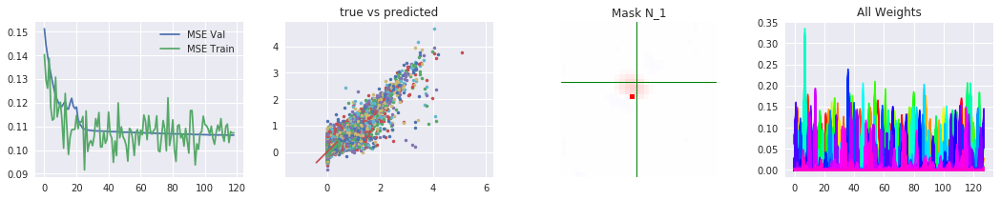

Total FEV =  0.879971830553
Runs: 12000; MSE - train: 0.106317, val: 0.106247116601; lr = 0.0001
best run:  11800 0.106244408195
Loss/Regularization: 0.00605487157009 MSE, 0.0 kernel, 0.00160132341385 mask, 0.00424226671457 weights


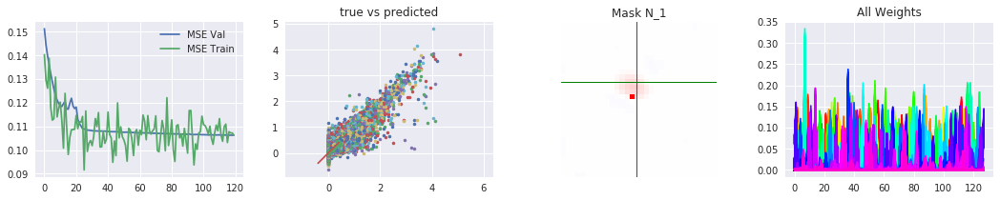

Total FEV =  0.881116873973
Runs: 12100; MSE - train: 0.101227, val: 0.106174769541; lr = 0.0001
best run:  12100 0.106174769541
Loss/Regularization: 0.0059971093724 MSE, 0.0 kernel, 0.00159713544846 mask, 0.00425535097718 weights


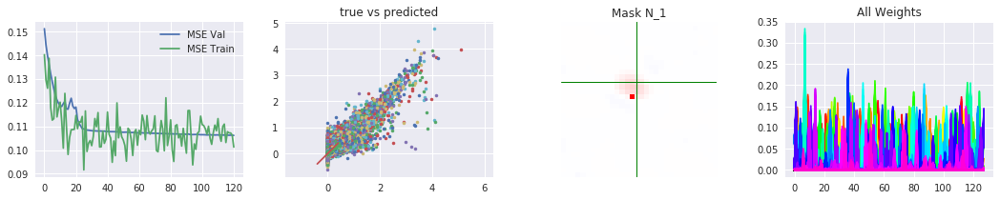

Total FEV =  0.88066313667
Runs: 12200; MSE - train: 0.104946, val: 0.106200151566; lr = 0.0001
best run:  12100 0.106174769541
Loss/Regularization: 0.0060199983418 MSE, 0.0 kernel, 0.00160429301262 mask, 0.00426381602883 weights


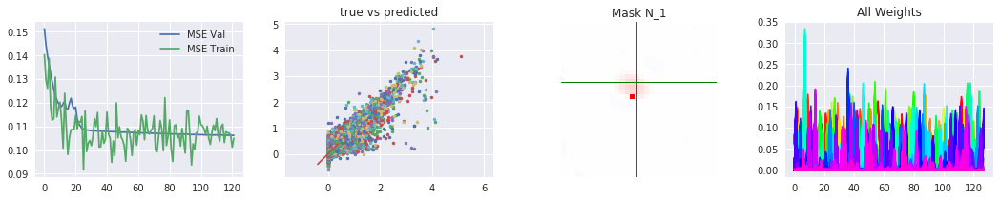

Total FEV =  0.880013727141
Runs: 12300; MSE - train: 0.101797, val: 0.106240140515; lr = 0.0001
best run:  12100 0.106174769541
Loss/Regularization: 0.00605275807902 MSE, 0.0 kernel, 0.00161383051872 mask, 0.00425621062517 weights


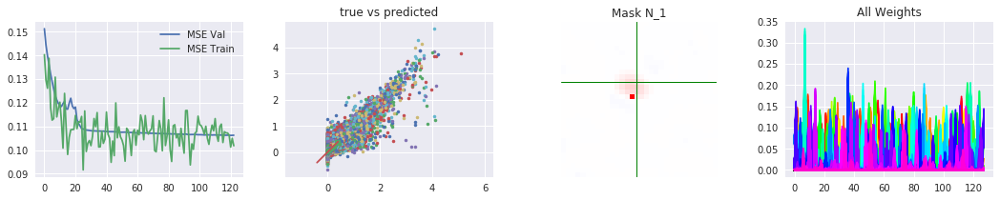

Total FEV =  0.880318713353
Runs: 12400; MSE - train: 0.0949508, val: 0.106222301902; lr = 0.0001
best run:  12100 0.106174769541
Loss/Regularization: 0.00603737292113 MSE, 0.0 kernel, 0.0016167822361 mask, 0.00423729613423 weights


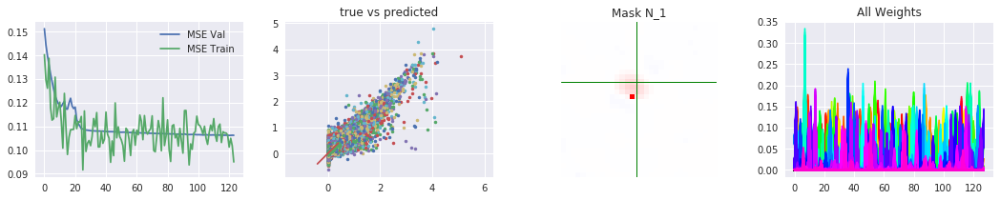

Total FEV =  0.879553245445
Runs: 12500; MSE - train: 0.113379, val: 0.106257592478; lr = 0.0001
best run:  12100 0.106174769541
Loss/Regularization: 0.0060759872722 MSE, 0.0 kernel, 0.00161343283653 mask, 0.00427210897207 weights


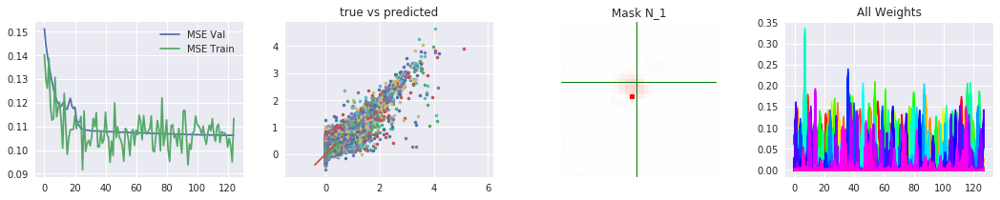

Total FEV =  0.882180470619
Runs: 12600; MSE - train: 0.100921, val: 0.106120305016; lr = 0.0001
best run:  12600 0.106120305016
Loss/Regularization: 0.00594345579157 MSE, 0.0 kernel, 0.00161100683212 mask, 0.00424014419317 weights


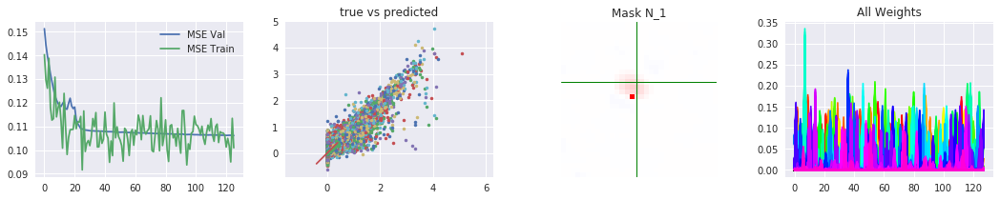

Total FEV =  0.88126322443
Runs: 12700; MSE - train: 0.104937, val: 0.106183146337; lr = 0.0001
best run:  12600 0.106120305016
Loss/Regularization: 0.00598972666194 MSE, 0.0 kernel, 0.00160803022385 mask, 0.00423242121935 weights


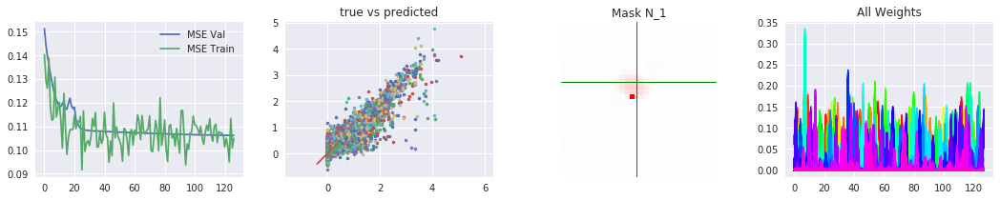

Total FEV =  0.881386665296
Runs: 12800; MSE - train: 0.10479, val: 0.106155425671; lr = 0.0001
best run:  12600 0.106120305016
Loss/Regularization: 0.00598349963548 MSE, 0.0 kernel, 0.00160383052826 mask, 0.00424832984805 weights


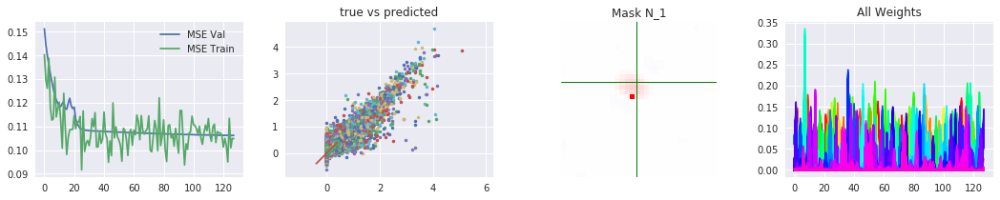

Total FEV =  0.882046553154
Runs: 12900; MSE - train: 0.0978473, val: 0.106130332235; lr = 0.0001
best run:  12600 0.106120305016
Loss/Regularization: 0.00595021131448 MSE, 0.0 kernel, 0.00160207457542 mask, 0.00424718409777 weights


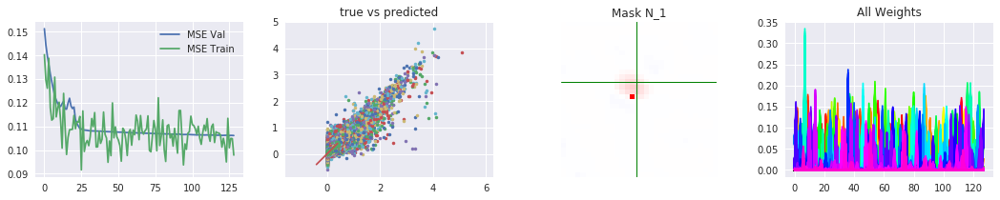

Total FEV =  0.881006377266
Runs: 13000; MSE - train: 0.103396, val: 0.106179155229; lr = 0.0001
best run:  12600 0.106120305016
Loss/Regularization: 0.00600268342532 MSE, 0.0 kernel, 0.00159844822884 mask, 0.00426252990961 weights


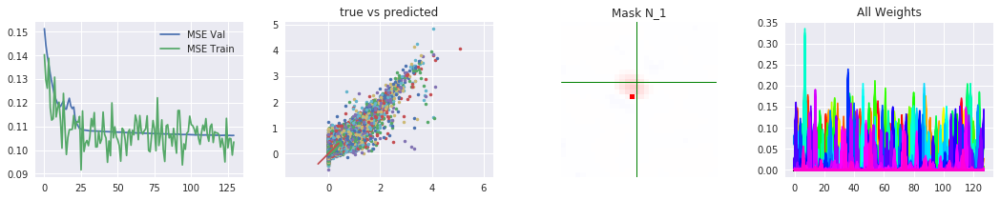

Total FEV =  0.882471758614
Runs: 13100; MSE - train: 0.108964, val: 0.10611508282; lr = 0.0001
best run:  13100 0.10611508282
Loss/Regularization: 0.00592876164592 MSE, 0.0 kernel, 0.00161350479126 mask, 0.00422658160329 weights


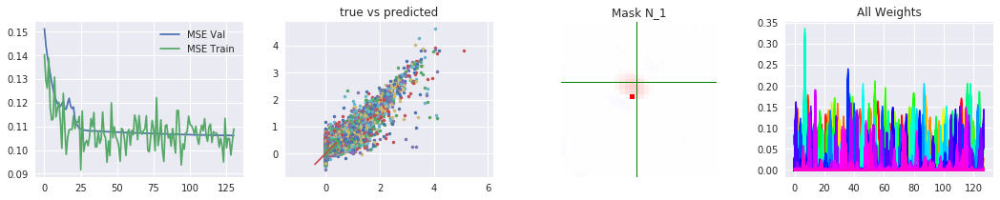

Total FEV =  0.882357079114
Runs: 13200; MSE - train: 0.103879, val: 0.106113765088; lr = 0.0001
best run:  13200 0.106113765088
Loss/Regularization: 0.00593454670161 MSE, 0.0 kernel, 0.00161899595261 mask, 0.00422469109297 weights


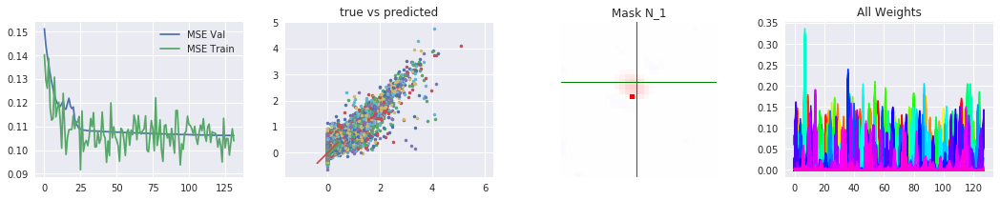

Total FEV =  0.883230621747
Runs: 13300; MSE - train: 0.100613, val: 0.10607317096; lr = 0.0001
best run:  13300 0.10607317096
Loss/Regularization: 0.0058904804755 MSE, 0.0 kernel, 0.00161811418533 mask, 0.00423534348607 weights


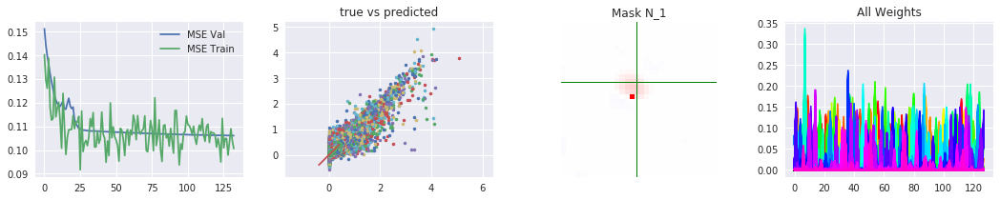

Total FEV =  0.883767787027
Runs: 13400; MSE - train: 0.106091, val: 0.106042079207; lr = 0.0001
best run:  13400 0.106042079207
Loss/Regularization: 0.0058633829467 MSE, 0.0 kernel, 0.00161644992828 mask, 0.00420703053474 weights


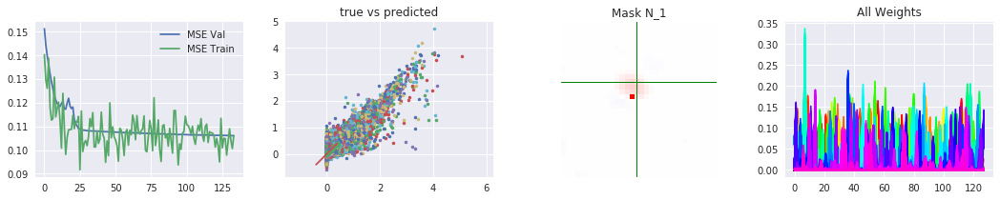

Total FEV =  0.883617243968
Runs: 13500; MSE - train: 0.106474, val: 0.106051512123; lr = 0.0001
best run:  13400 0.106042079207
Loss/Regularization: 0.0058709771547 MSE, 0.0 kernel, 0.00161305289268 mask, 0.00422949582338 weights


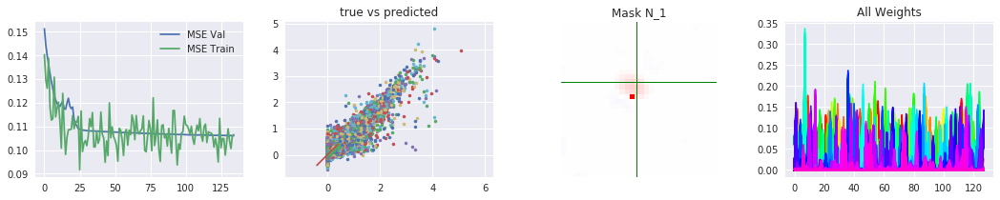

Total FEV =  0.883832755903
Runs: 13600; MSE - train: 0.103648, val: 0.106035455701; lr = 0.0001
best run:  13600 0.106035455701
Loss/Regularization: 0.00586010556435 MSE, 0.0 kernel, 0.00161029758453 mask, 0.00422326102853 weights


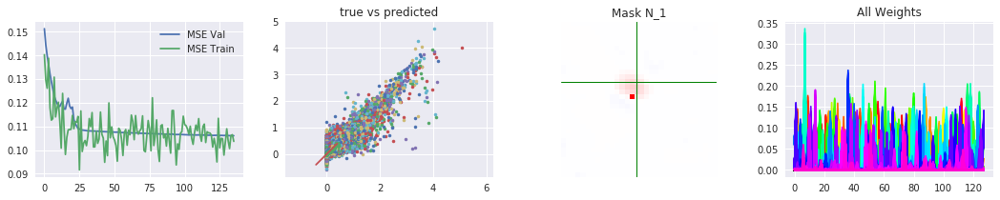

Total FEV =  0.883622940644
Runs: 13700; MSE - train: 0.104178, val: 0.10605059456; lr = 0.0001
best run:  13600 0.106035455701
Loss/Regularization: 0.00587068978348 MSE, 0.0 kernel, 0.00160734586716 mask, 0.00423047482967 weights


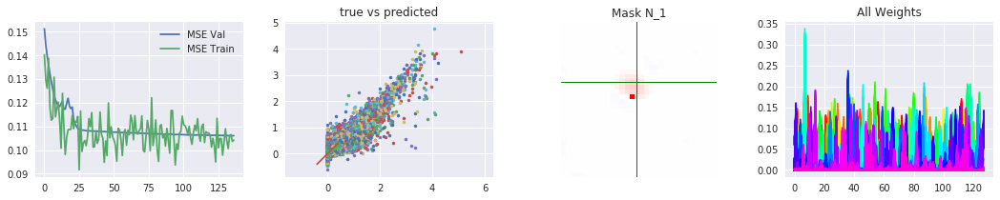

Total FEV =  0.883073207946
Runs: 13800; MSE - train: 0.109629, val: 0.106082399286; lr = 0.0001
best run:  13600 0.106035455701
Loss/Regularization: 0.00589842128102 MSE, 0.0 kernel, 0.00160528378487 mask, 0.00423699885607 weights


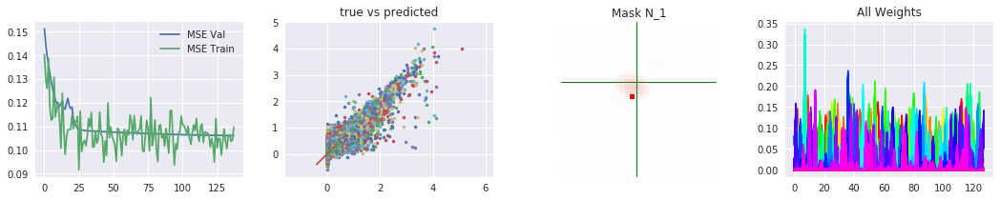

Total FEV =  0.885011516099
Runs: 13900; MSE - train: 0.103094, val: 0.105980828224; lr = 0.0001
best run:  13900 0.105980828224
Loss/Regularization: 0.00580064250971 MSE, 0.0 kernel, 0.00160425753593 mask, 0.00421528503299 weights


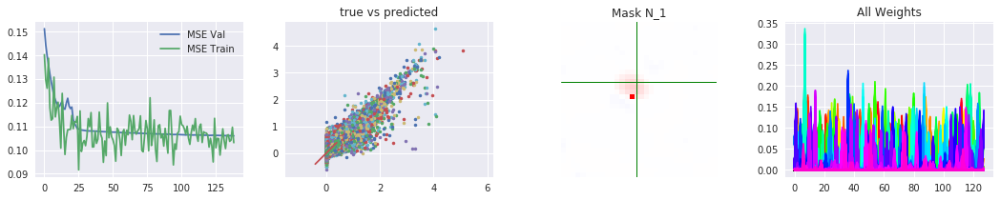

Total FEV =  0.884006146821
Runs: 14000; MSE - train: 0.104519, val: 0.106031566798; lr = 0.0001
best run:  13900 0.105980828224
Loss/Regularization: 0.00585135878646 MSE, 0.0 kernel, 0.00162028841972 mask, 0.00419590204954 weights


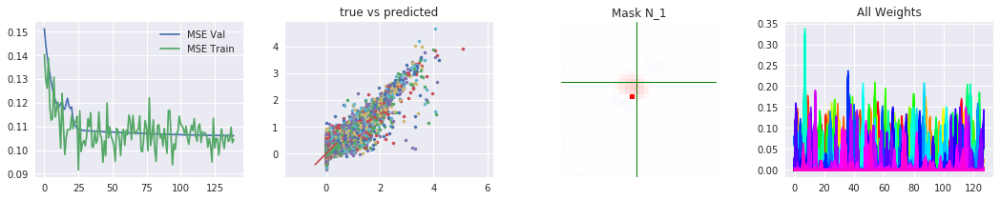

Total FEV =  0.885271474684
Runs: 14100; MSE - train: 0.103691, val: 0.105968697838; lr = 0.0001
best run:  14100 0.105968697838
Loss/Regularization: 0.00578752878937 MSE, 0.0 kernel, 0.00162283043861 mask, 0.00418417453766 weights


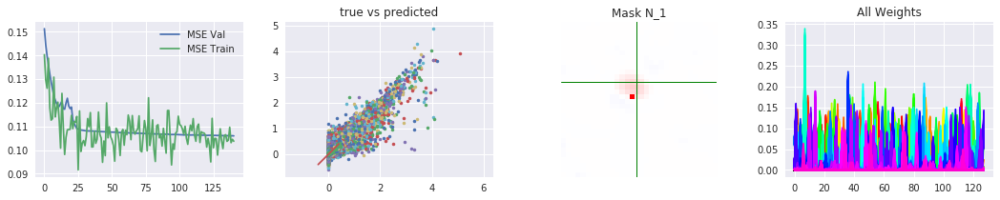

Total FEV =  0.88390031465
Runs: 14200; MSE - train: 0.0975082, val: 0.106042234407; lr = 0.0001
best run:  14100 0.105968697838
Loss/Regularization: 0.00585669753491 MSE, 0.0 kernel, 0.00162149605751 mask, 0.00419587388635 weights


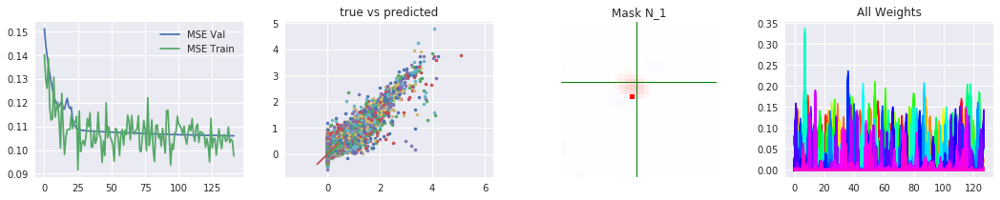

Total FEV =  0.88523408282
Runs: 14300; MSE - train: 0.0935414, val: 0.105968726318; lr = 0.0001
best run:  14100 0.105968697838
Loss/Regularization: 0.00578941503773 MSE, 0.0 kernel, 0.00161954340935 mask, 0.00420271486044 weights


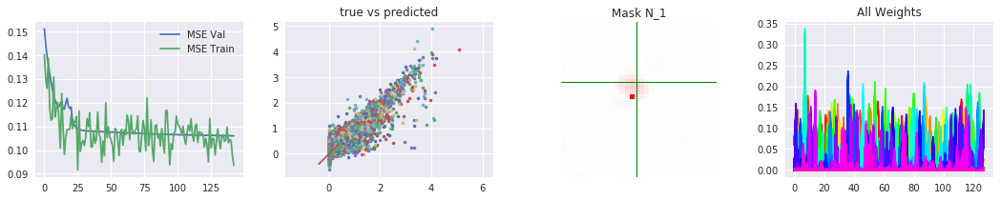

Total FEV =  0.883741242732
Runs: 14400; MSE - train: 0.103397, val: 0.106043918419; lr = 0.0001
best run:  14100 0.105968697838
Loss/Regularization: 0.00586472198484 MSE, 0.0 kernel, 0.00161453719139 mask, 0.00422483682632 weights


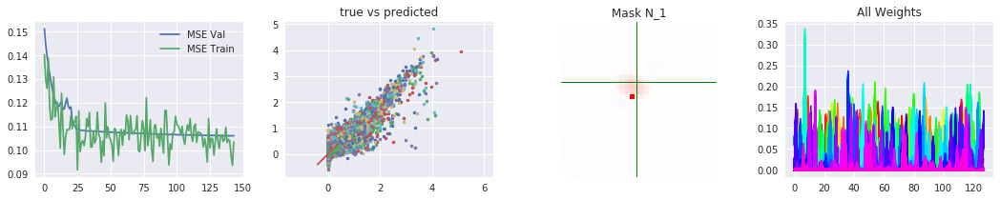

Total FEV =  0.885786845014
Runs: 14500; MSE - train: 0.107345, val: 0.105942950133; lr = 0.0001
best run:  14500 0.105942950133
Loss/Regularization: 0.00576153071597 MSE, 0.0 kernel, 0.00161183652878 mask, 0.00419635534286 weights


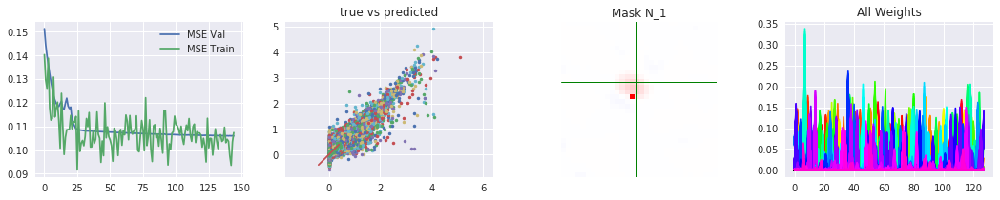

Total FEV =  0.885825079784
Runs: 14600; MSE - train: 0.113256, val: 0.10593872307; lr = 0.0001
best run:  14600 0.10593872307
Loss/Regularization: 0.00575960194692 MSE, 0.0 kernel, 0.00160893259048 mask, 0.00419865086675 weights


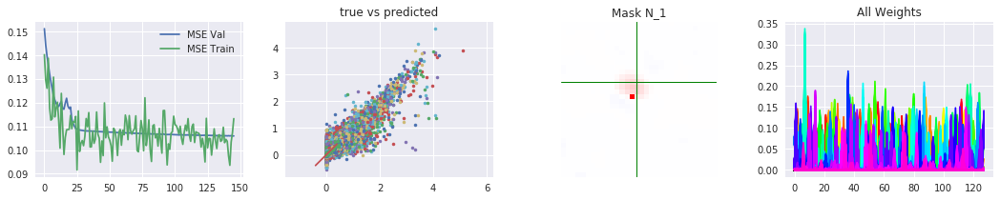

Total FEV =  0.884358466675
Runs: 14700; MSE - train: 0.105709, val: 0.106013941188; lr = 0.0001
best run:  14600 0.10593872307
Loss/Regularization: 0.005833585863 MSE, 0.0 kernel, 0.00160575385094 mask, 0.00423923939466 weights


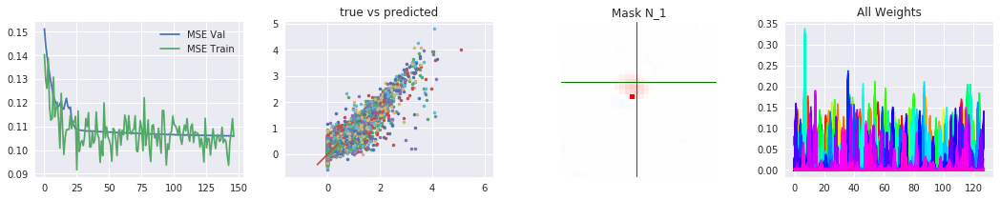

Total FEV =  0.886146326388
Runs: 14800; MSE - train: 0.0989301, val: 0.105926904407; lr = 0.0001
best run:  14800 0.105926904407
Loss/Regularization: 0.00574339652667 MSE, 0.0 kernel, 0.0016148560524 mask, 0.00417861744761 weights


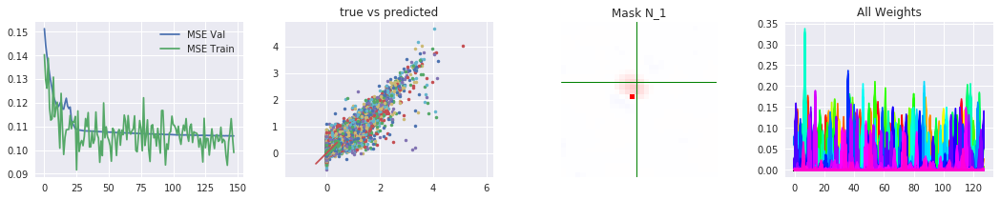

Total FEV =  0.885366507749
Runs: 14900; MSE - train: 0.0981902, val: 0.105966706069; lr = 0.0001
best run:  14800 0.105926904407
Loss/Regularization: 0.00578273480642 MSE, 0.0 kernel, 0.00162362580299 mask, 0.00420244753361 weights


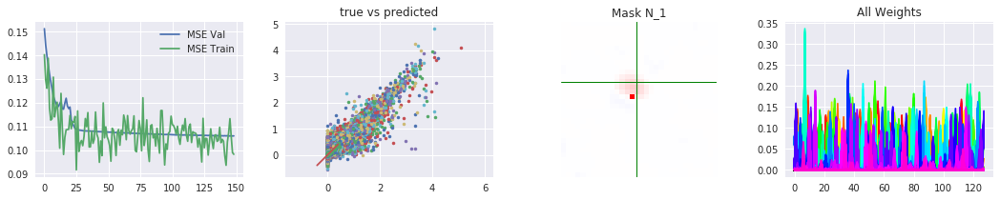

Total FEV =  0.886049663476
Runs: 15000; MSE - train: 0.0982048, val: 0.105919672296; lr = 0.0001
best run:  15000 0.105919672296
Loss/Regularization: 0.00574827272794 MSE, 0.0 kernel, 0.00162580461502 mask, 0.00418691575527 weights


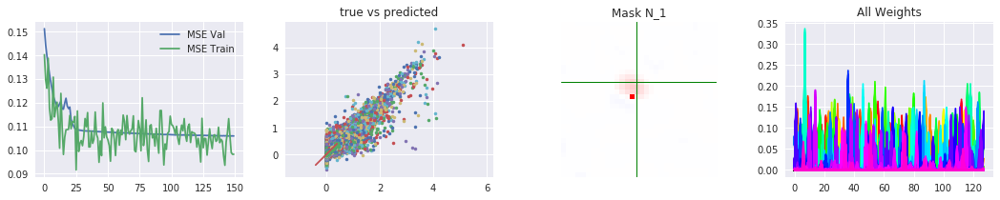

Total FEV =  0.886574029408
Runs: 15100; MSE - train: 0.103891, val: 0.105902570029; lr = 0.0001
best run:  15100 0.105902570029
Loss/Regularization: 0.00572182086762 MSE, 0.0 kernel, 0.00162367315292 mask, 0.00418783798814 weights


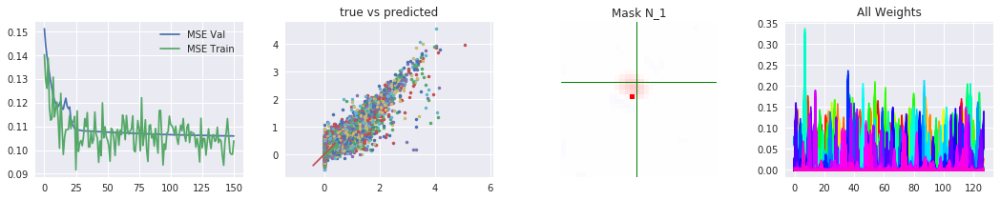

Total FEV =  0.884998173277
Runs: 15200; MSE - train: 0.111986, val: 0.105990905195; lr = 0.0001
best run:  15100 0.105902570029
Loss/Regularization: 0.005801315594 MSE, 0.0 kernel, 0.00162151122093 mask, 0.0041749843955 weights


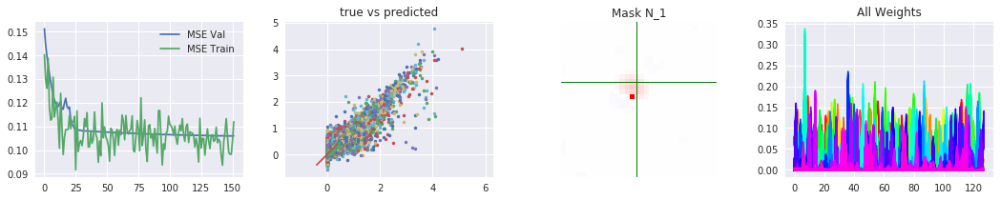

Total FEV =  0.885593699196
Runs: 15300; MSE - train: 0.100308, val: 0.105941662505; lr = 0.0001
best run:  15100 0.105902570029
Loss/Regularization: 0.00577127403812 MSE, 0.0 kernel, 0.00161885890961 mask, 0.00419940054417 weights


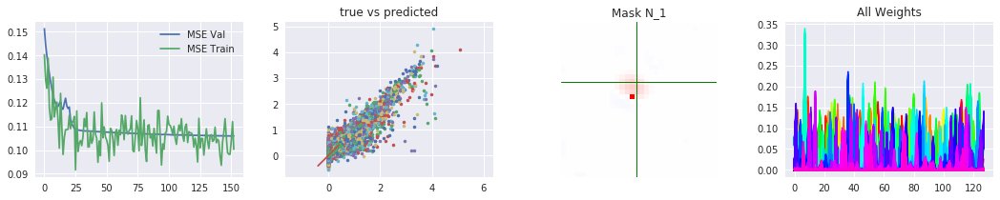

Total FEV =  0.886824731039
Runs: 15400; MSE - train: 0.107235, val: 0.105895373009; lr = 0.0001
best run:  15400 0.105895373009
Loss/Regularization: 0.00570917411824 MSE, 0.0 kernel, 0.00161504774094 mask, 0.00419160112739 weights


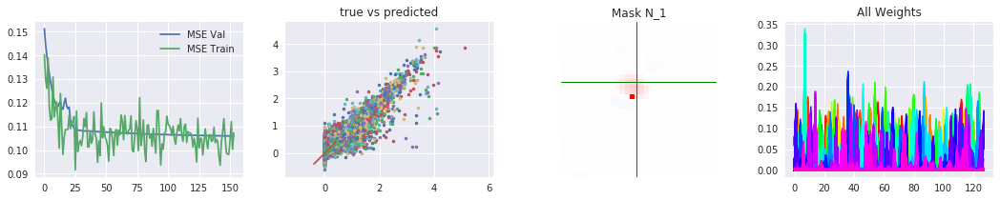

Total FEV =  0.886594278166
Runs: 15500; MSE - train: 0.0970067, val: 0.105906152196; lr = 0.0001
best run:  15400 0.105895373009
Loss/Regularization: 0.00572079941048 MSE, 0.0 kernel, 0.0016111726284 mask, 0.00418993592262 weights


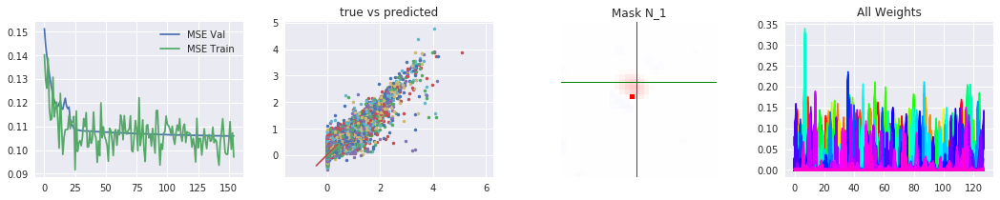

Total FEV =  0.886472096178
Runs: 15600; MSE - train: 0.107092, val: 0.105912659377; lr = 0.0001
best run:  15400 0.105895373009
Loss/Regularization: 0.00572696293239 MSE, 0.0 kernel, 0.00160819630623 mask, 0.00418414995074 weights


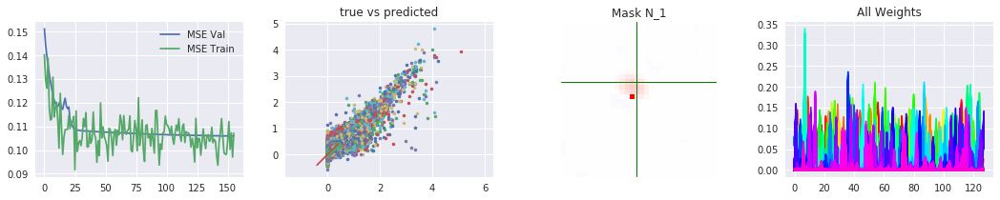

Total FEV =  0.885520697626
Runs: 15700; MSE - train: 0.112, val: 0.105954454671; lr = 0.0001
best run:  15400 0.105895373009
Loss/Regularization: 0.0057749566331 MSE, 0.0 kernel, 0.00161921982765 mask, 0.00419406116009 weights


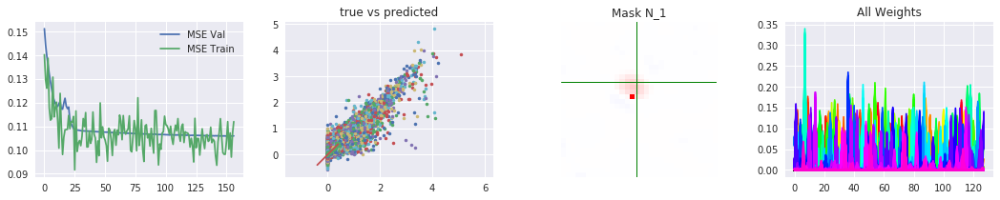

Total FEV =  0.88689715048
Runs: 15800; MSE - train: 0.0938258, val: 0.10588592393; lr = 0.0001
best run:  15800 0.10588592393
Loss/Regularization: 0.00570552088902 MSE, 0.0 kernel, 0.00162720994949 mask, 0.0041808333993 weights


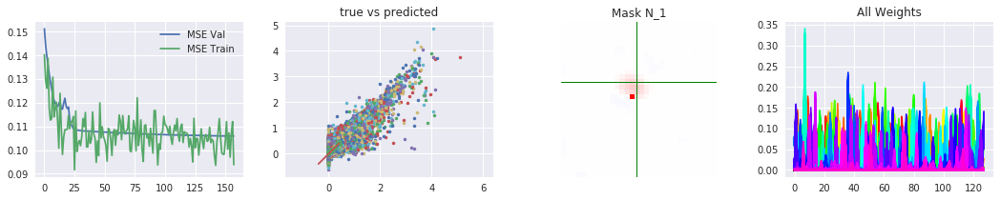

Total FEV =  0.886636449954
Runs: 15900; MSE - train: 0.110825, val: 0.105904372409; lr = 0.0001
best run:  15800 0.10588592393
Loss/Regularization: 0.00571867203689 MSE, 0.0 kernel, 0.0016284318924 mask, 0.00415994614363 weights


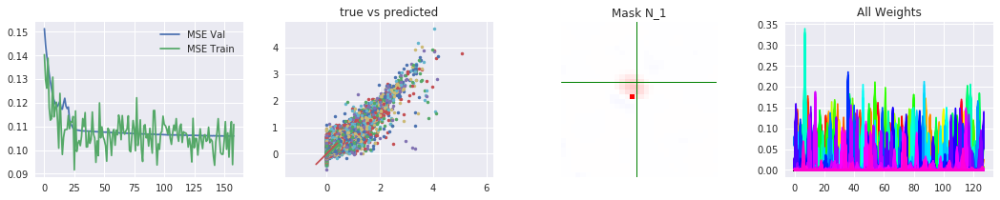

Total FEV =  0.887000359319
Runs: 16000; MSE - train: 0.101157, val: 0.105894389833; lr = 0.0001
best run:  15800 0.10588592393
Loss/Regularization: 0.00570031447569 MSE, 0.0 kernel, 0.00162646493912 mask, 0.00417001336813 weights


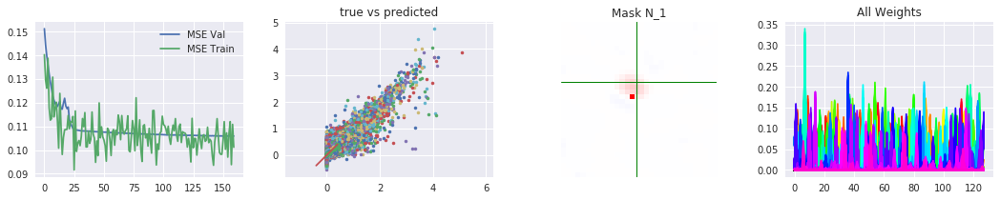

Total FEV =  0.888708429797
Runs: 16100; MSE - train: 0.1065, val: 0.105795563649; lr = 0.0001
best run:  16100 0.105795563649
Loss/Regularization: 0.0056141501409 MSE, 0.0 kernel, 0.00162314801216 mask, 0.00417430043221 weights


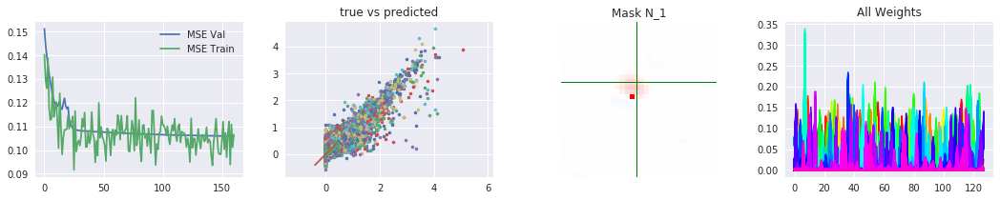

Total FEV =  0.887507461565
Runs: 16200; MSE - train: 0.0966628, val: 0.105852265332; lr = 0.0001
best run:  16100 0.105795563649
Loss/Regularization: 0.00567473348929 MSE, 0.0 kernel, 0.00162118349075 mask, 0.00414558336139 weights


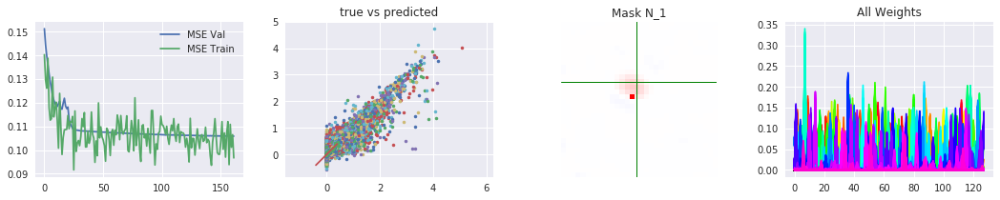

Total FEV =  0.887912164991
Runs: 16300; MSE - train: 0.0989134, val: 0.105832800149; lr = 0.0001
best run:  16100 0.105795563649
Loss/Regularization: 0.00565431805444 MSE, 0.0 kernel, 0.00161645693779 mask, 0.0041754001379 weights


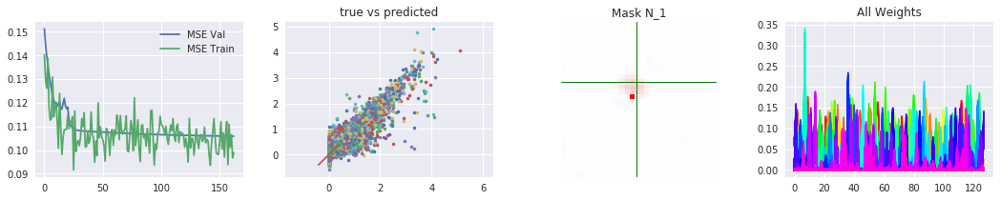

Total FEV =  0.888292698219
Runs: 16400; MSE - train: 0.106247, val: 0.105804413016; lr = 0.0001
best run:  16100 0.105795563649
Loss/Regularization: 0.00563512189547 MSE, 0.0 kernel, 0.00161387572289 mask, 0.00415828362107 weights


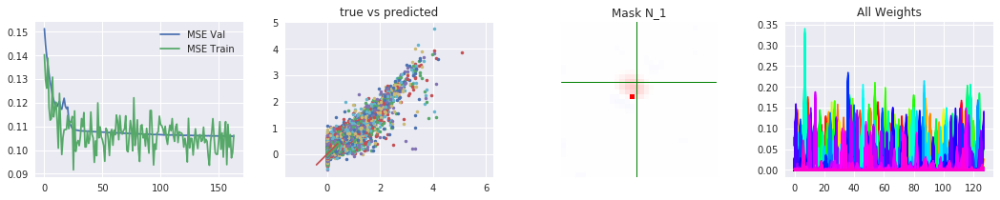

Total FEV =  0.888574336366
Runs: 16500; MSE - train: 0.100122, val: 0.105798656061; lr = 0.0001
best run:  16100 0.105795563649
Loss/Regularization: 0.00562091454049 MSE, 0.0 kernel, 0.00161101312637 mask, 0.00416523233056 weights


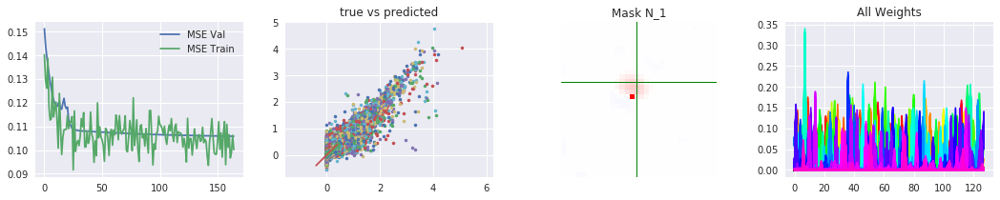

Total FEV =  0.888498658962
Runs: 16600; MSE - train: 0.104018, val: 0.105805971029; lr = 0.0001
best run:  16100 0.105795563649
Loss/Regularization: 0.00562473211903 MSE, 0.0 kernel, 0.0016272793293 mask, 0.00413875177503 weights


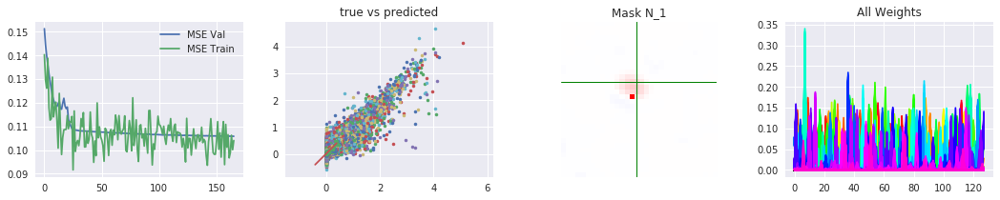

Total FEV =  0.895273472755
Runs: 16700; MSE - train: 0.10272, val: 0.10546084181; lr = 1e-05
best run:  16700 0.10546084181
Loss/Regularization: 0.00528297378332 MSE, 0.0 kernel, 0.00161518306732 mask, 0.0038579647243 weights


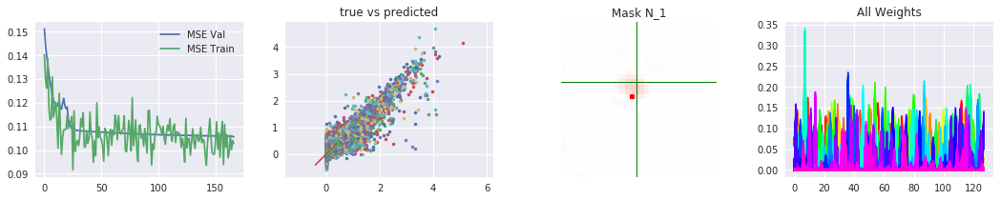

Total FEV =  0.896529982713
Runs: 16800; MSE - train: 0.112187, val: 0.105396349944; lr = 1e-05
best run:  16800 0.105396349944
Loss/Regularization: 0.00521958860918 MSE, 0.0 kernel, 0.00160456295013 mask, 0.0037497612834 weights


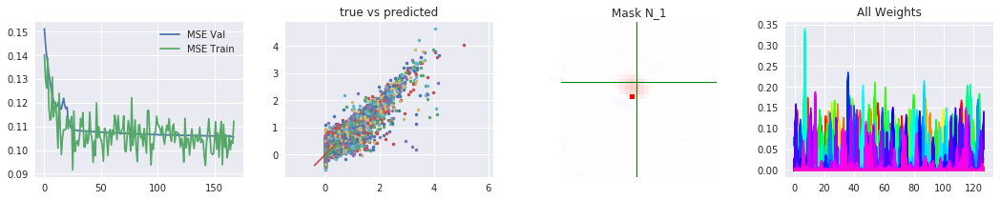

Total FEV =  0.896872892725
Runs: 16900; MSE - train: 0.0974113, val: 0.105379674584; lr = 1e-05
best run:  16900 0.105379674584
Loss/Regularization: 0.0052022903692 MSE, 0.0 kernel, 0.00159621419907 mask, 0.00369492016733 weights


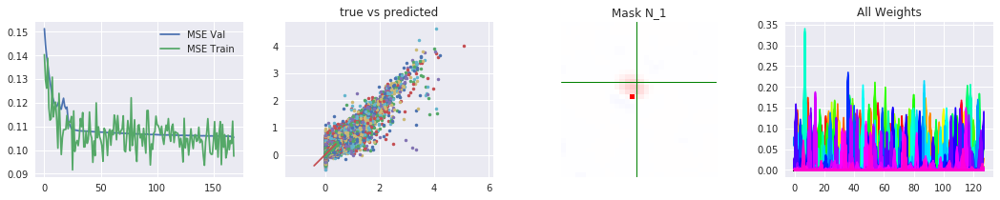

Total FEV =  0.897124782846
Runs: 17000; MSE - train: 0.108904, val: 0.105364944906; lr = 1e-05
best run:  17000 0.105364944906
Loss/Regularization: 0.00518958366592 MSE, 0.0 kernel, 0.00158910970688 mask, 0.00365790568292 weights


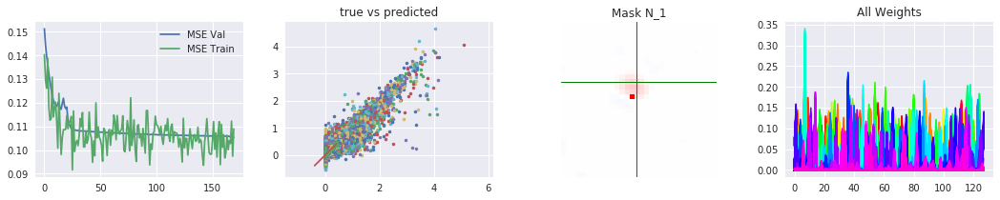

Total FEV =  0.897169845665
Runs: 17100; MSE - train: 0.110471, val: 0.105364205856; lr = 1e-05
best run:  17100 0.105364205856
Loss/Regularization: 0.00518731045304 MSE, 0.0 kernel, 0.0015827422142 mask, 0.00363273203373 weights


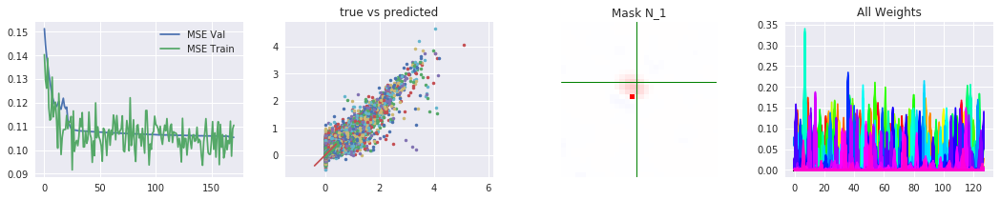

Total FEV =  0.897066245086
Runs: 17200; MSE - train: 0.0998566, val: 0.105365644419; lr = 1e-05
best run:  17100 0.105364205856
Loss/Regularization: 0.00519253662787 MSE, 0.0 kernel, 0.00157720856667 mask, 0.00361644901335 weights


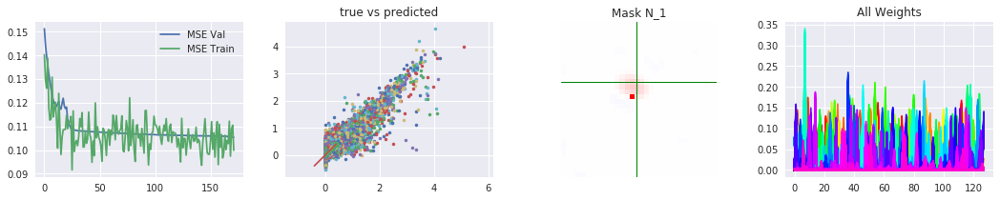

Total FEV =  0.897142613661
Runs: 17300; MSE - train: 0.109811, val: 0.105361480867; lr = 1e-05
best run:  17300 0.105361480867
Loss/Regularization: 0.00518868418294 MSE, 0.0 kernel, 0.00157180895805 mask, 0.00360089510679 weights


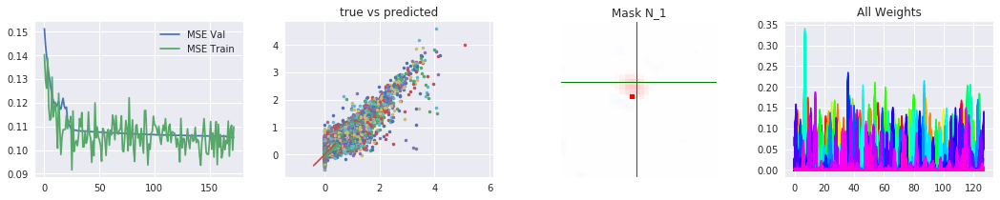

Total FEV =  0.897321977608
Runs: 17400; MSE - train: 0.116081, val: 0.105353438626; lr = 1e-05
best run:  17400 0.105353438626
Loss/Regularization: 0.00517963609309 MSE, 0.0 kernel, 0.00156729912758 mask, 0.00359219424427 weights


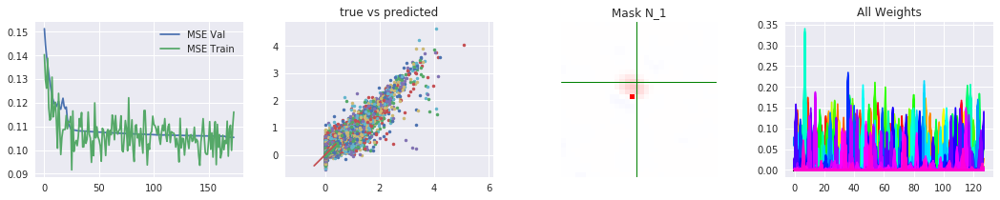

Total FEV =  0.896945305819
Runs: 17500; MSE - train: 0.107397, val: 0.105373925199; lr = 1e-05
best run:  17400 0.105353438626
Loss/Regularization: 0.00519863746013 MSE, 0.0 kernel, 0.0015641720295 mask, 0.00357773624361 weights


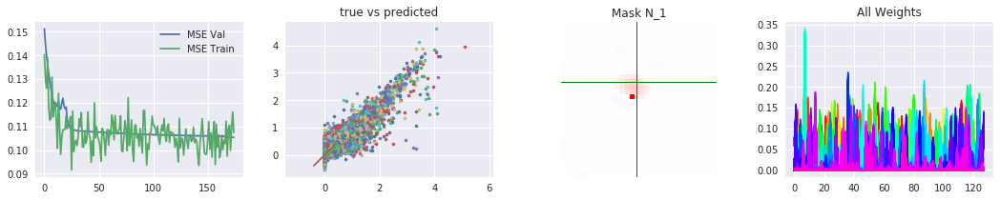

Total FEV =  0.897231478115
Runs: 17600; MSE - train: 0.0989812, val: 0.10535800481; lr = 1e-05
best run:  17400 0.105353438626
Loss/Regularization: 0.00518420137814 MSE, 0.0 kernel, 0.00156120858192 mask, 0.00358041912317 weights


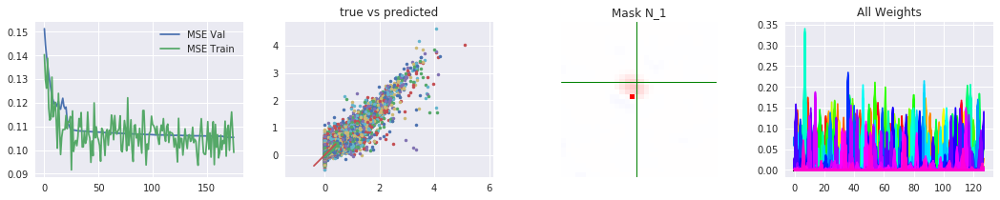

Total FEV =  0.897204366691
Runs: 17700; MSE - train: 0.106836, val: 0.105357945927; lr = 1e-05
best run:  17400 0.105353438626
Loss/Regularization: 0.00518556902534 MSE, 0.0 kernel, 0.00155821609497 mask, 0.00357470467687 weights


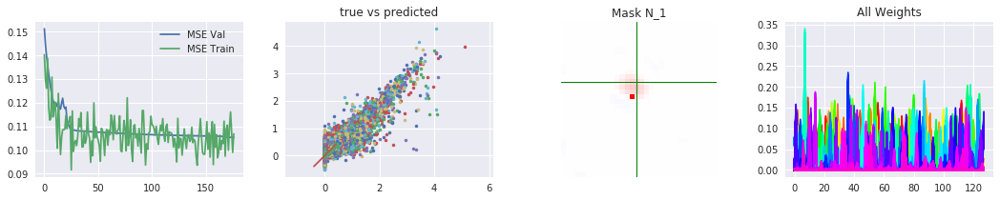

Total FEV =  0.897240591988
Runs: 17800; MSE - train: 0.111773, val: 0.105358369408; lr = 1e-05
best run:  17400 0.105353438626
Loss/Regularization: 0.00518374162493 MSE, 0.0 kernel, 0.00155490531921 mask, 0.00356689363718 weights


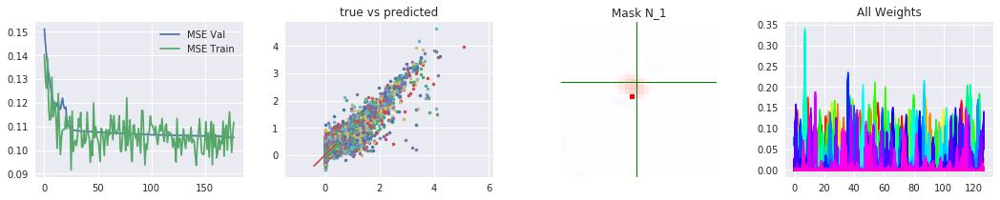

Total FEV =  0.897381082496
Runs: 17900; MSE - train: 0.106803, val: 0.105349930424; lr = 1e-05
best run:  17900 0.105349930424
Loss/Regularization: 0.00517665452207 MSE, 0.0 kernel, 0.00155187134743 mask, 0.00356856107712 weights


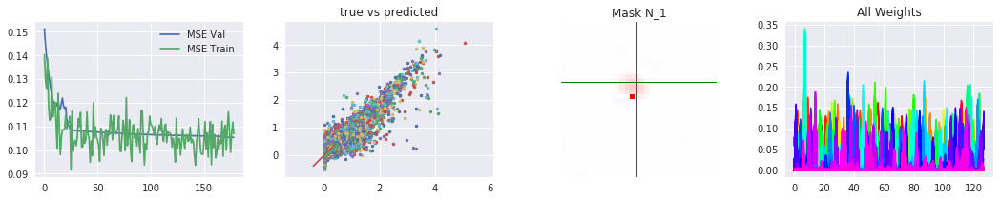

Total FEV =  0.897174750206
Runs: 18000; MSE - train: 0.103323, val: 0.105358931266; lr = 1e-05
best run:  17900 0.105349930424
Loss/Regularization: 0.00518706304138 MSE, 0.0 kernel, 0.00154888114929 mask, 0.00356192395091 weights


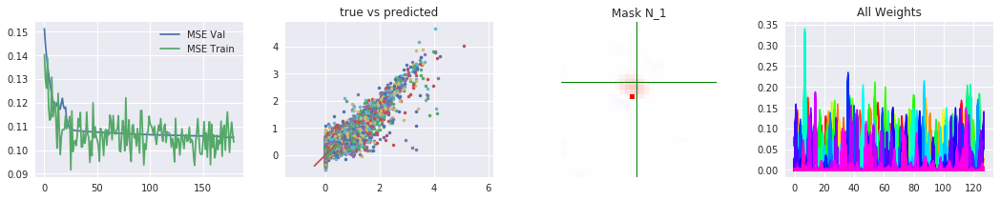

Total FEV =  0.897305279897
Runs: 18100; MSE - train: 0.104838, val: 0.105354768254; lr = 1e-05
best run:  17900 0.105349930424
Loss/Regularization: 0.00518047841615 MSE, 0.0 kernel, 0.00154547138214 mask, 0.00355801999569 weights


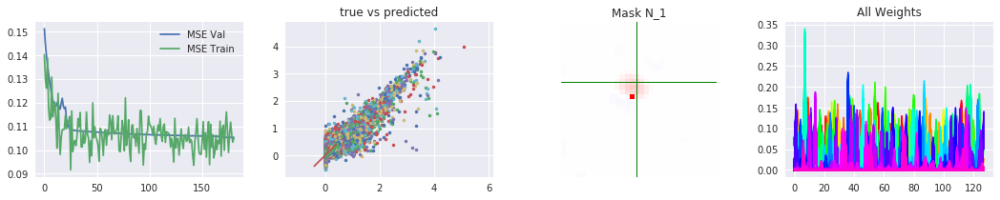

Total FEV =  0.897768139728
Runs: 18200; MSE - train: 0.111014, val: 0.105330506159; lr = 1e-05
best run:  18200 0.105330506159
Loss/Regularization: 0.00515712925699 MSE, 0.0 kernel, 0.00154288330078 mask, 0.00356232874095 weights


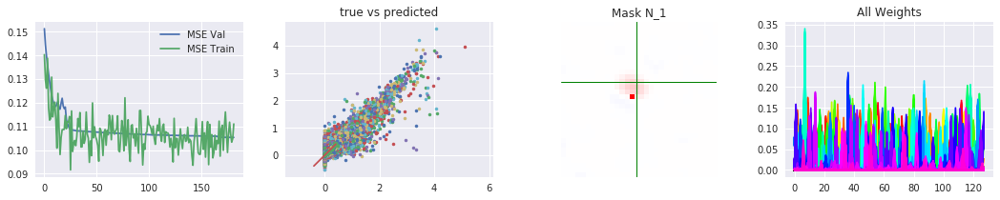

Total FEV =  0.897923767909
Runs: 18300; MSE - train: 0.0996216, val: 0.105322205612; lr = 1e-05
best run:  18300 0.105322205612
Loss/Regularization: 0.00514927852782 MSE, 0.0 kernel, 0.00154125380516 mask, 0.00355870217085 weights


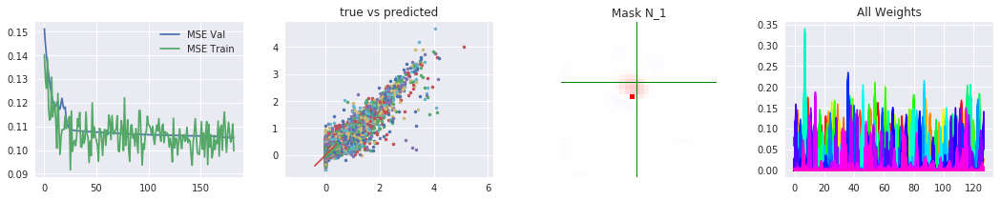

Total FEV =  0.89802306223
Runs: 18400; MSE - train: 0.10834, val: 0.105314836988; lr = 1e-05
best run:  18400 0.105314836988
Loss/Regularization: 0.00514426958398 MSE, 0.0 kernel, 0.00154006476402 mask, 0.00356350287795 weights


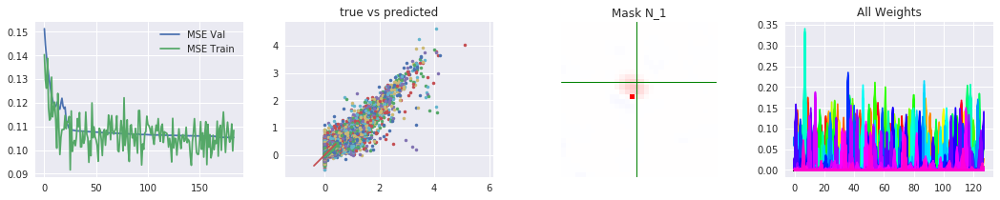

Total FEV =  0.897826057857
Runs: 18500; MSE - train: 0.0994061, val: 0.105327328186; lr = 1e-05
best run:  18400 0.105314836988
Loss/Regularization: 0.00515420755255 MSE, 0.0 kernel, 0.00153819594383 mask, 0.00355948537588 weights


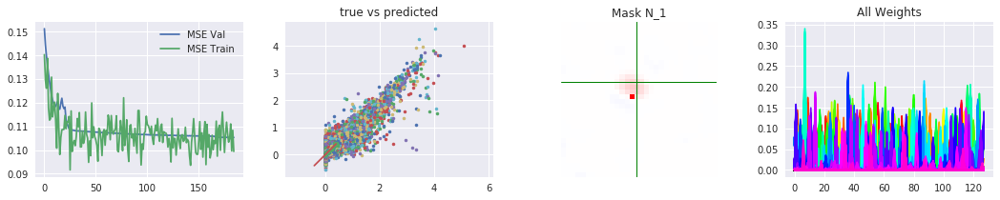

Total FEV =  0.897799392406
Runs: 18600; MSE - train: 0.0998512, val: 0.105328777144; lr = 1e-05
best run:  18400 0.105314836988
Loss/Regularization: 0.00515555270249 MSE, 0.0 kernel, 0.00153633255959 mask, 0.00355398707092 weights


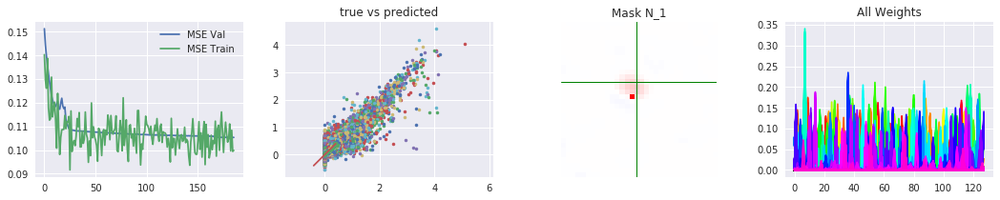

Total FEV =  0.897860247721
Runs: 18700; MSE - train: 0.104084, val: 0.105325837229; lr = 1e-05
best run:  18400 0.105314836988
Loss/Regularization: 0.00515248283045 MSE, 0.0 kernel, 0.00153397436142 mask, 0.00355343431234 weights


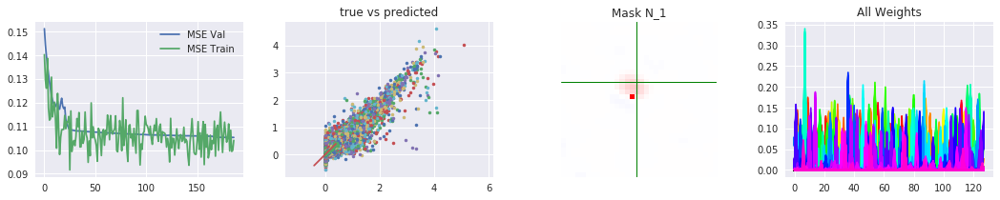

Total FEV =  0.897742192563
Runs: 18800; MSE - train: 0.114612, val: 0.105328042; lr = 1e-05
best run:  18400 0.105314836988
Loss/Regularization: 0.00515843817266 MSE, 0.0 kernel, 0.00153189983368 mask, 0.00355129882693 weights


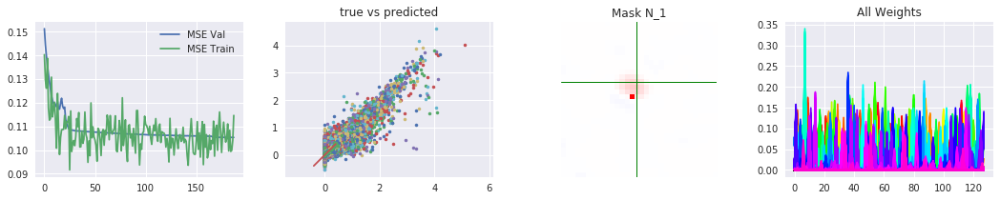

Total FEV =  0.897706729976
Runs: 18900; MSE - train: 0.104949, val: 0.105332262874; lr = 1e-05
best run:  18400 0.105314836988
Loss/Regularization: 0.0051602270978 MSE, 0.0 kernel, 0.00152967338562 mask, 0.00354484990239 weights


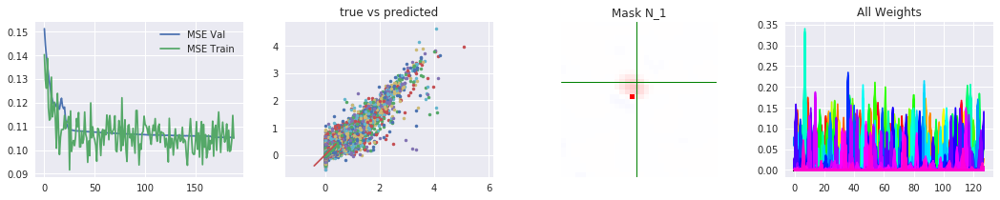

('Stop at run 18900; MSE on validation set: 0.105314836988', 'MSE on test set: 0.00514426954717; Mean FEV: 0.895405968594')
.r mean values of weights:  [ 0.    0.    0.01  0.    0.    0.    0.    0.    0.    0.01  0.    0.    0.
  0.    0.    0.    0.    0.    0.    0.    0.    0.    0.    0.    0.    0.
  0.    0.    0.    0.    0.    0.    0.    0.    0.    0.    0.    0.    0.
  0.    0.    0.    0.    0.    0.    0.    0.    0.    0.    0.    0.    0.
  0.    0.    0.    0.    0.01  0.    0.    0.    0.    0.    0.    0.    0.
  0.    0.    0.    0.    0.    0.    0.    0.01  0.    0.    0.    0.    0.
  0.    0.    0.    0.    0.    0.    0.    0.    0.    0.    0.    0.    0.
  0.    0.    0.    0.    0.    0.    0.    0.    0.    0.    0.    0.    0.
  0.    0.    0.    0.    0.    0.    0.    0.    0.    0.    0.    0.    0.
  0.    0.    0.    0.    0.    0.    0.    0.    0.    0.    0.  ]
.b mean values of weights:  [ 0.    0.    0.    0.    0.    0.    0.    0.    0.    0. 

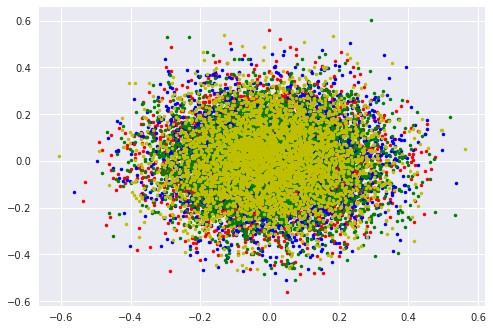

run took 11782.691632509232 s to optimize


Text(0,0.5,'FEV')

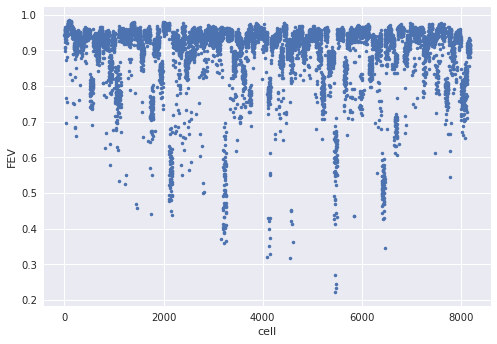

In [24]:
#With 128 types of neurons and all data!!!

start = time.time()
#Seeds
np_seed=1248
np.random.seed(np_seed)
tf_seed=1729

#'''
#Data, keep test set for later
num_test = 2**10
ind = np.random.choice(X.shape[0],X.shape[0],replace=False)
X_TEST = X[ind[:num_test],...]
GT_TEST = (Y[:,ind[:num_test]].T / np.mean(Y,1)).T * .1#mean response=.1
X_try = X[ind[num_test:],...]
Y_try = Y[:,ind[num_test:]]

#Data
split_data=True#set true for large nets to fit on GPU memory
batch_size = 64
D=min(2**16,Y_try.shape[1])-num_test#number of training+val images
num_val = D//8
num_train = D-num_val

Y_train,Y_val,X_train,X_val,X_test,GT_test = splitting_data(X=X_try,Y=Y_try,
   num_train=num_train,num_test=num_test,num_val=num_val,noise=True,mean_response=.1)

print('Images for Training: %s, Validation: %s, Testing %s'%(
      Y_train.shape[1],Y_val.shape[1],GT_test.shape[1]))

#Neurons
N=2**13
#ind = np.random.choice(250,N//4,replace=False)
#ind = np.concatenate([ind,ind+250,ind+500,ind+750])
#ind[0]=0
#Y_train=Y_train[ind,:]
#Y_val=Y_val[ind,:]
#GT_test=GT_test[ind,:]

#Ground truth locations
GT_mask = np.hstack([loc_y.reshape([-1,1]),loc_x.reshape([-1,1])])#[ind,:]

#Parameters:
s=[44,3,32]#sizes of [image(heigth=width), image(depth=channel), mask]
sk=[5,5,5]#width=heigth of receptive field and conv kernel
num_kern = [32,64,128]#number of bases (conv kernels) to learn per layer
#N=Y_train.shape[0]#neurons
init_scales = np.array([[0,.01],[1,.001],[1/num_kern[-1],.01]])#Mean/SD for Kernel,Mask,Weights
lr= .001 # initial learning rate
reg = np.array([0,.6,.12]) * N/1000
#[0,.0000464,.00000278]#regularization parameters: L2 Kernels, L1 Mask, L1 Weights
max_runs = 100000 # training steps
act_fn=['relu','relu','relu']#activation function per layer in model
kernel_constraint=None
weights_constraint='abs'#'norm'#None#constrain read out weights to norm=1
stop_crit = [5,3]#[after how many worse steps lower lr, lower how many times]
burn_in=10#allow for burn_in*100 initial runs without triggering stop criterion
bn_cent=True#center after batch norm

#calculate spike triggered average to initialize location masks
X_sta=np.mean(X_train,axis=1).reshape([-1,s[0]**2]).T
sta,_=pre_process.STA(X_sta,Y_train,s[-1],np.int(s[-1]/2))
#'''
reg = [0,.0003,.03,0]
print('it took %s s to preprocess data'%(time.time()-start))

#for rep in range(5):
#Train Model

#for i in range(2,10):
start = time.time()
(WK,WM,WW,MSE_train,MSE_val,MSE_test,FEV,FEV_cell,Y_,
log) = training.train(s=s,#        sizes of [image(heigth=width), image(depth=channel), mask]
          sK=sk,#        s - sizes of [kernel1, kernel2, ...] - length of list gives number of layers
          act_fn=act_fn,#      activation functions for each kernel = 'ID' or 'relu'
          init_scales=init_scales,# rows: kernel,mask,weights; columns: mean, sd
          init_lr=lr,# initial learning rate, goes down later
          num_kern=num_kern,#        num_kern - number of kernels per conv layer
          max_runs=max_runs,# maximum number of training steps
          reg=reg,#        regularization weights [Kernel,Mask,Weights]
          batch_size=batch_size,# (max gpu memory?)256 for small one layer, 64 for large multilayer model
          X_train=X_train,
          X_val=X_val,
          X_test=X_test,
          Y_train=Y_train,
          Y_val=Y_val,
          GT_test=GT_test,#Data, X in NCHW format, Y: Neurons x Data
          kernel_constraint=kernel_constraint,#constraint for kernel weights - 'norm' == 1
          weights_constraint=weights_constraint,#constraint on read out weights - 'abs','norm','absnorm'
          mask_constraint=None,#constraint on mask - 'abs'
          final_relu=False,
          stop_crit=stop_crit,#[after how many worse steps lower lr, lower how many times]
          burn_in=burn_in,#allow initial exploration of 100*burn_in runs 
          types=list(np.arange(0,2**13,64)),#starting indices of types, default=all same type
          GT_mask=GT_mask,#true locations if known: rows:neurons, columns: x,y location
          tf_seed=tf_seed,#random seed for tensorflow
          np_seed=np_seed,
          split_data=split_data,#whether to go through test and val set in batch_size chunks
          sta=sta,#if provided, take maximum absolute pixel of sta to initialize mask
          bn_cent=bn_cent,#center after batch norm?
          verbose='yes')#stats every 100 steps (takes much longer), 'yes','no','minimal'

#plotting
c = ['.r','.b','.g','.y']
for i in range(4):
    print(c[i],'mean values of weights: ',np.around(np.mean(WW[:,i*(N//4):(i+1)*(N//4)],1),2))
    plt.plot(WW[0,i*(N//4):(i+1)*(N//4)]+np.random.normal(0,.15,(N//4)),
                WW[1,i*(N//4):(i+1)*(N//4)]+np.random.normal(0,.15,(N//4)),c[i])
    plt.plot(-WW[2,i*(N//4):(i+1)*(N//4)]+np.random.normal(0,.15,(N//4)),
                -WW[3,i*(N//4):(i+1)*(N//4)]+np.random.normal(0,.15,(N//4)),c[i])
plt.show()

print('run took %s s to optimize'%(time.time()-start))
#Plot Model performance on individual cells
plt.plot(FEV_cell,'.')
plt.xlabel('cell')
plt.ylabel('FEV')

# Grid search and evaluation

In [ ]:
#Test!
reps = 5

Neurons = [4*64,8*64,16*64]

#rM = [.001,.01]
#rW = [.1,.3]
#lower reg
rM = [.0003,.003]
rW = [.03,.1]

start = time.time()
#Seeds
np_seed=1234
np.random.seed(np_seed)
tf_seed=1234

#Data, keep test set for later
N=Neurons[-1]
num_test = 2**10
ind = np.random.choice(X.shape[0],X.shape[0],replace=False)
X_TEST = X[ind[:num_test],...]
GT_TEST = ((Y[:,ind[:num_test]].T / np.mean(Y,1)).T * .1)[:N,:]#mean response=.1
X_try = X[ind[num_test:],...]
Y_try = Y[:N,ind[num_test:]]

#Data
D=2**12
split_data=True#set true for large nets to fit on GPU memory
batch_size = 64
D=min(D,Y_try.shape[1])#number of training+val images
num_val = np.min([D//8,num_test])#limit validation set to test set size
num_train = D-num_val

Y_train,Y_val,X_train,X_val,X_test,GT_test = splitting_data(X=X_try,Y=Y_try,
   num_train=num_train,num_test=num_test,num_val=num_val,noise=True,mean_response=.1)

print('Images for Training: %s, Validation: %s, Testing %s'%(
      Y_train.shape[1],Y_val.shape[1],GT_test.shape[1]))

#Ground truth locations
GT_mask = np.hstack([loc_y.reshape([-1,1]),loc_x.reshape([-1,1])])#[ind,:]

#Parameters:
s=[44,3,32]#sizes of [image(heigth=width), image(depth=channel), mask]
sk=[5,5,5]#width=heigth of receptive field and conv kernel
num_kern = [32,64,0]#number of bases (conv kernels) to learn per layer
#N=Y_train.shape[0]#neurons
init_scales = np.array([[0,.01],[1,.001],[0,.01]])#Mean/SD for Kernel,Mask,Weights
lr= .001 # initial learning rate
max_runs = 100000 # training steps
act_fn=['relu','relu','relu']#activation function per layer in model
kernel_constraint=None
weights_constraint='abs'#'norm'#None#constrain read out weights to norm=1
stop_crit = [5,3]#[after how many worse steps lower lr, lower how many times]
burn_in=10#allow for burn_in*100 initial runs without triggering stop criterion
bn_cent=True#center after batch norm

#calculate spike triggered average to initialize location masks
X_sta=np.mean(X_train,axis=1).reshape([-1,s[0]**2]).T
sta,_=pre_process.STA(X_sta,Y_train,s[-1],np.int(s[-1]/2))
#'''
reg = [0,0,0,0]
print('it took %s s to preprocess data'%(time.time()-start))

Val_c4 = np.zeros([reps,2,2,Neurons[0],2])#rep,rm,rw,N,model/mean-pred
Fev_c4 = np.zeros([reps,2,2,Neurons[0],2])
Val_c8 = np.zeros([reps,2,2,Neurons[1],2])#rep,rm,rw,N,model/mean-pred
Fev_c8 = np.zeros([reps,2,2,Neurons[1],2])
Val_c16 = np.zeros([reps,2,2,Neurons[2],2])#rep,rm,rw,N,model/mean-pred
Fev_c16 = np.zeros([reps,2,2,Neurons[2],2])

for rep in range(5):
    with open("log.txt", "a") as file:
        print('repetition ',rep, file=file)
    for n in range(3):
        num_kern[2] = 2**(n+2)
        init_scales[2,0] = 1/num_kern[-1]
        with open("log.txt", "a") as file:
            print('neurons %s, kernels/types %s'%(Neurons[n],num_kern[2]),file=file)
        for rm in range(2):
            for rw in range(2):
                reg[1]=rM[rm]
                reg[2]=rW[rw]
                with open("log.txt", "a") as file:
                    print('regularization = ',reg,file=file)
                (WK,WM,WW,MSE_train,MSE_val,Val_cell,MSE_test,
                 FEV,FEV_cell,Y_,log,MSE_val_mean,FEV_mean
                ) = training.train(s=s,#        sizes of [image(heigth=width), image(depth=channel), mask]
                          sK=sk,#        s - sizes of [kernel1, kernel2, ...] - length of list gives number of layers
                          act_fn=act_fn,#      activation functions for each kernel = 'ID' or 'relu'
                          init_scales=init_scales,# rows: kernel,mask,weights; columns: mean, sd
                          init_lr=lr,# initial learning rate, goes down later
                          num_kern=num_kern,#        num_kern - number of kernels per conv layer
                          max_runs=max_runs,# maximum number of training steps
                          reg=reg,#        regularization weights [Kernel,Mask,Weights]
                          batch_size=batch_size,# (max gpu memory?)256 for small one layer, 64 for large multilayer model
                          X_train=X_train,
                          X_val=X_val,
                          X_test=X_TEST,
                          Y_train=Y_train[:Neurons[n],:],
                          Y_val=Y_val[:Neurons[n],:],
                          GT_test=GT_TEST[:Neurons[n],:],#Data, X in NCHW format, Y: Neurons x Data
                          kernel_constraint=kernel_constraint,#constraint for kernel weights - 'norm' == 1
                          weights_constraint=weights_constraint,#constraint on read out weights - 'abs','norm','absnorm'
                          mask_constraint=None,#constraint on mask - 'abs'
                          final_relu=False,
                          stop_crit=stop_crit,#[after how many worse steps lower lr, lower how many times]
                          burn_in=burn_in,#allow initial exploration of 100*burn_in runs 
                          types=list(np.arange(0,2**13,64)),#starting indices of types, default=all same type
                          GT_mask=GT_mask[:Neurons[n],:],#true locations if known: rows:neurons, columns: x,y location
                          tf_seed=tf_seed,#random seed for tensorflow
                          np_seed=np_seed,
                          split_data=split_data,#whether to go through test and val set in batch_size chunks
                          sta=sta[:Neurons[n],:],#if provided, take maximum absolute pixel of sta to initialize mask
                          bn_cent=bn_cent,#center after batch norm?
                          verbose='no')#stats every 100 steps (takes much longer), 'yes','no','minimal'
                
                if n==0:
                    Val_c4[rep,rm,rw,:,0] = Val_cell
                    Val_c4[rep,rm,rw,:,1] = MSE_val_mean
                    Fev_c4[rep,rm,rw,:,0] = FEV_cell
                    Fev_c4[rep,rm,rw,:,1] = FEV_mean
                    
                if n==1:
                    Val_c8[rep,rm,rw,:,0] = Val_cell
                    Val_c8[rep,rm,rw,:,1] = MSE_val_mean
                    Fev_c8[rep,rm,rw,:,0] = FEV_cell
                    Fev_c8[rep,rm,rw,:,1] = FEV_mean
                    
                if n==2:
                    Val_c16[rep,rm,rw,:,0] = Val_cell
                    Val_c16[rep,rm,rw,:,1] = MSE_val_mean
                    Fev_c16[rep,rm,rw,:,0] = FEV_cell
                    Fev_c16[rep,rm,rw,:,1] = FEV_mean
                
                #saving text output to log file
                with open("log.txt", "a") as file:
                    print(log, file=file)
                np.savez('running_cnn_more_types',
                         Val_c4=Val_c4,
                         Fev_c4=Fev_c4,
                         Val_c8=Val_c8,
                         Fev_c8=Fev_c8,
                         Val_c16=Val_c16,
                         Fev_c16=Fev_c16)

Images for Training: 3584, Validation: 512, Testing 1024
it took 6.480671644210815 s to preprocess data


best reg (1, 0)
best reg (1, 1)
best reg (1, 1)
best reg (1, 0)
best reg (1, 1)
best reg (1, 1)
best reg (1, 0)
best reg (1, 1)
best reg (1, 1)
best reg (1, 0)
best reg (1, 1)
best reg (1, 1)
best reg (1, 0)
best reg (1, 1)
best reg (1, 0)


/usr/local/lib/python3.4/dist-packages/matplotlib/font_manager.py:1313: UserWarning: findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))


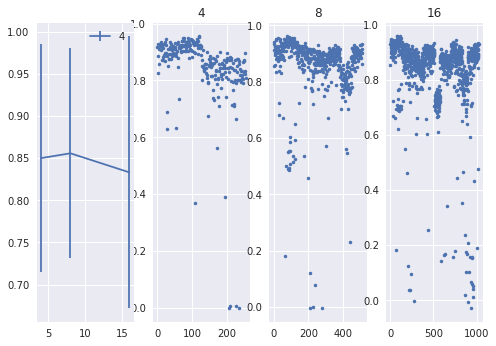

In [30]:
#results
tmp = np.load('cnn_4-8-16_types.npz')
Neurons = [4*64,8*64,16*64]

Val_c4=tmp['Val_c4']
Fev_c4=tmp['Fev_c4']
Val_c8=tmp['Val_c8']
Fev_c8=tmp['Fev_c8']
Val_c16=tmp['Val_c16']
Fev_c16=tmp['Fev_c16']
Val = [Val_c4,Val_c8,Val_c16]
FEV = [Fev_c4,Fev_c8,Fev_c16]

ind_m4 = np.zeros(Val_c4.shape[1:-1])
ind_m8 = np.zeros(Val_c8.shape[1:-1])
ind_m16 = np.zeros(Val_c16.shape[1:-1])

FEV_best = [np.zeros([5,Neurons[0]]),np.zeros([5,Neurons[1]]),np.zeros([5,Neurons[2]])]

for rep in range(5):
    for n in range(len(Neurons)):
        val_tmp = np.zeros(Val[n].shape[:-1])
        fev_tmp = np.zeros(Val[n].shape[:-1])
        for rm in range(2):
            for rw in range(2):
                for i in range(Neurons[n]):
                    ind = np.argmin(Val[n][rep,rm,rw,i,:])#which model
                    val_tmp[rep,rm,rw,i] = Val[n][rep,rm,rw,i,ind]
                    fev_tmp[rep,rm,rw,i] = FEV[n][rep,rm,rw,i,ind]
        #choose one reg thats best for all neurons
        ind = np.unravel_index(np.argmin(np.mean(val_tmp[rep,:,:,:],2)),[2,2])
        print('best reg', ind)
        FEV_best[n][rep,:] = fev_tmp[rep,ind[0],ind[1],:]
        
fev_m = np.zeros(3)
fev_sd = np.zeros(3)
for n in range(len(Neurons)):
    fev_cells = np.mean(FEV_best[n],0)
    plt.subplot(1,4,n+2)
    plt.plot(fev_cells,'.')
    plt.title(Neurons[n]//64)
    fev_m[n] = np.mean(FEV_best[n])
    fev_sd[n] = np.std(FEV_best[n])
plt.subplot(1,4,1)
plt.errorbar(np.array(Neurons)//64,fev_m,fev_sd)
plt.legend(np.array(Neurons)//64)
plt.show()

## Compare to Batty and McIntosh

/usr/local/lib/python3.4/dist-packages/matplotlib/font_manager.py:1313: UserWarning: findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))


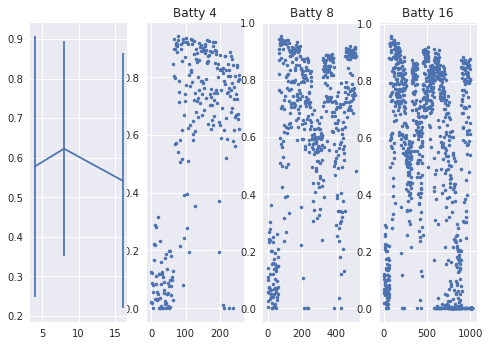

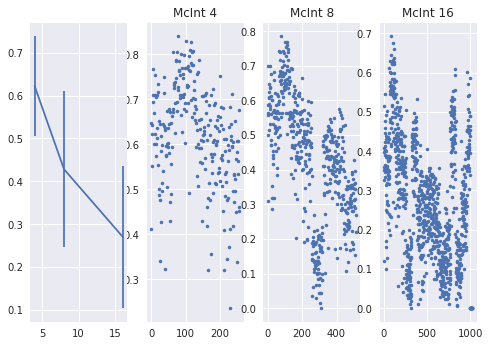

In [40]:
#Compare
tmp = np.load('batty_4-8-16_types.npz')

Val_c4=tmp['Val_c4']#rep,reg (mean over neurons)
Fev_c4=tmp['Fev_c4']#rep,reg,neurons
Val_c8=tmp['Val_c8']
Fev_c8=tmp['Fev_c8']
Val_c16=tmp['Val_c16']
Fev_c16=tmp['Fev_c16']
Val = [Val_c4,Val_c8,Val_c16]
FEV = [Fev_c4,Fev_c8,Fev_c16]

batty_m = np.zeros(3)
batty_sd = np.zeros(3)

for n in range(3):
    fev_tmp = np.zeros([5,64*2**(n+2)])
    for rep in range(5):
        ind = np.argmin(Val[n][rep,:])
        fev_tmp[rep,:] = FEV[n][rep,ind,:].clip(min=0)
    plt.subplot(1,4,n+2)
    plt.plot(np.mean(fev_tmp,0),'.')
    plt.title('Batty %s'%(2**(n+2)))
    batty_m[n] = np.mean(fev_tmp)
    batty_sd[n] = np.std(fev_tmp)
plt.subplot(1,4,1)
plt.errorbar([4,8,16],batty_m,batty_sd)
plt.show()


tmp = np.load('mcint_4-8-16_types.npz')

Val_c4=tmp['Val_c4']#rep,reg (mean over neurons)
Fev_c4=tmp['Fev_c4']#rep,reg,neurons
Val_c8=tmp['Val_c8']
Fev_c8=tmp['Fev_c8']
Val_c16=tmp['Val_c16']
Fev_c16=tmp['Fev_c16']
Val = [Val_c4,Val_c8,Val_c16]
FEV = [Fev_c4,Fev_c8,Fev_c16]

mcint_m = np.zeros(3)
mcint_sd = np.zeros(3)

for n in range(3):
    fev_tmp = np.zeros([5,64*2**(n+2)])
    for rep in range(5):
        ind = np.argmin(Val[n][rep,:])
        fev_tmp[rep,:] = FEV[n][rep,ind,:].clip(min=0)
    plt.subplot(1,4,n+2)
    plt.plot(np.mean(fev_tmp,0),'.')
    plt.title('McInt %s'%(2**(n+2)))
    mcint_m[n] = np.mean(fev_tmp)
    mcint_sd[n] = np.std(fev_tmp)
plt.subplot(1,4,1)
plt.errorbar([4,8,16],mcint_m,mcint_sd)
plt.show()

/usr/local/lib/python3.4/dist-packages/matplotlib/font_manager.py:1313: UserWarning: findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))


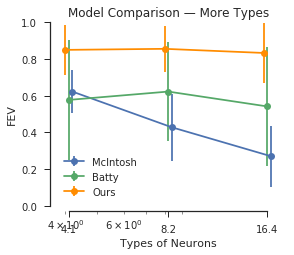

In [80]:
#plot all
# MCint and Batty
sns.set(font_scale=1)  # crazy big
sns.set_style('ticks')
fig_size = np.array([6,5])/2.54*12/7#like fig2 comparison
fig, ax = plt.subplots(figsize=fig_size)

#fig,ax = plt.subplots(1,1)

ax.errorbar([4.2,8.4,16.8],mcint_m,mcint_sd, fmt='o-')
ax.errorbar([4.1,8.2,16.4],batty_m,batty_sd, fmt='o-')
ax.errorbar([4,8,16],fev_m,fev_sd, fmt='o-',color='darkorange')
plt.legend(['McIntosh','Batty','Ours'])

ax.set_xlabel('Types of Neurons')
ax.set_ylabel('FEV')
ax.set_xscale("log", nonposx='clip')
ax.set_xticks([4.1,8.2,16.4])
ax.get_xaxis().set_major_formatter(matplotlib.ticker.ScalarFormatter())
plt.title('Model Comparison — More Types')
#ax.set_xlim([0,20])
ax.set_ylim([0,1])
sns.despine(offset=5,trim=True)
plt.gcf().savefig('fig_more-types.pdf')
plt.show()
sns.reset_orig()

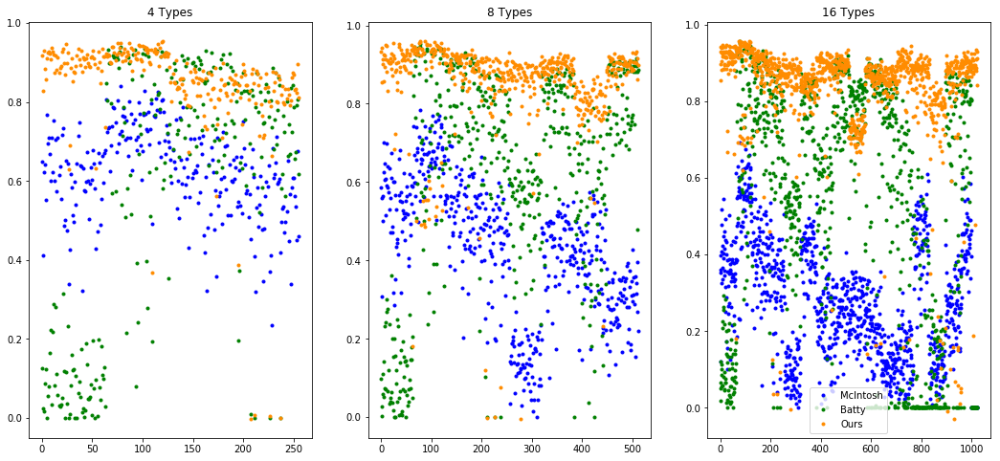

In [94]:
#Look at individual cells..
fig, ax = plt.subplots(1,3,figsize=[18,8])

#fig,ax = plt.subplots(1,1)

for n in range(3):
    #plt.subplot(1,3,n+1)
    #mcint
    tmp = np.load('mcint_4-8-16_types.npz')

    Val_c4=tmp['Val_c4']#rep,reg (mean over neurons)
    Fev_c4=tmp['Fev_c4']#rep,reg,neurons
    Val_c8=tmp['Val_c8']
    Fev_c8=tmp['Fev_c8']
    Val_c16=tmp['Val_c16']
    Fev_c16=tmp['Fev_c16']
    Val = [Val_c4,Val_c8,Val_c16]
    FEV = [Fev_c4,Fev_c8,Fev_c16]
    
    fev_tmp = np.zeros([5,64*2**(n+2)])
    for rep in range(5):
        ind = np.argmin(Val[n][rep,:])
        fev_tmp[rep,:] = FEV[n][rep,ind,:].clip(min=0)
    ax[n].plot(np.mean(fev_tmp,0),'b.')
    
    #batty
    
    tmp = np.load('batty_4-8-16_types.npz')

    Val_c4=tmp['Val_c4']#rep,reg (mean over neurons)
    Fev_c4=tmp['Fev_c4']#rep,reg,neurons
    Val_c8=tmp['Val_c8']
    Fev_c8=tmp['Fev_c8']
    Val_c16=tmp['Val_c16']
    Fev_c16=tmp['Fev_c16']
    Val = [Val_c4,Val_c8,Val_c16]
    FEV = [Fev_c4,Fev_c8,Fev_c16]
    
    fev_tmp = np.zeros([5,64*2**(n+2)])
    for rep in range(5):
        ind = np.argmin(Val[n][rep,:])
        fev_tmp[rep,:] = FEV[n][rep,ind,:].clip(min=0)
    ax[n].plot(np.mean(fev_tmp,0),'g.')
    
    #ours
    fev_cells = np.mean(FEV_best[n],0)
    ax[n].plot(fev_cells,'.',color='darkorange')
    
    ax[n].set_title('%s Types'%(2**(n+2)))
    
plt.legend(['McIntosh','Batty','Ours'])
    
    
plt.show()